In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os
import time

No corners detected in : camera_cal/calibration5.jpg
No corners detected in : camera_cal/calibration4.jpg
No corners detected in : camera_cal/calibration1.jpg


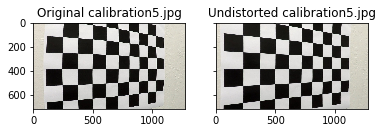

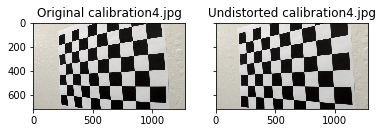

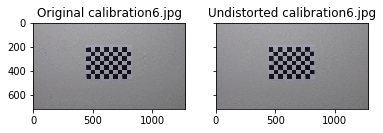

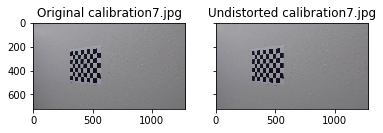

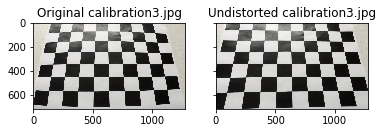

...

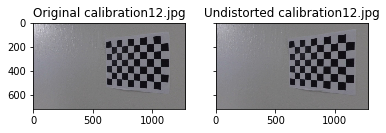

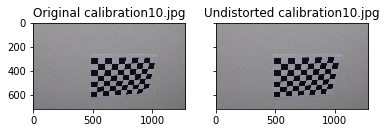

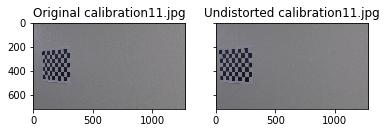

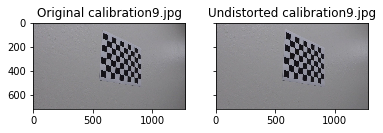

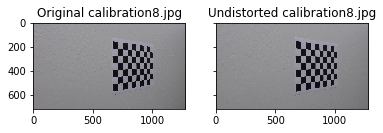

In [7]:
### Calibrate the camera
########################

OUTPUT_FOLDER = 'output_images'

def create_dir(dir):
    if not dir in os.listdir(OUTPUT_FOLDER):
        os.mkdir(os.path.join(OUTPUT_FOLDER, dir))

def load_image(img_path):
    return mpimg.imread(img_path)

def save_image(img, filename, foldername):
    create_dir(os.path.join(foldername))
#     print("Saving " + filename + " to " + foldername)
    plt.imsave(os.path.join(os.getcwd(), OUTPUT_FOLDER, foldername, filename), img)

nx = 9
ny = 6

# 1. Folder to save calibration images with corners drawn
camera_cal_corners_output_directory = 'camera_cal_corners_output'
create_dir(camera_cal_corners_output_directory)
# 2. Folder to store undistorted images with corners drawn
camera_cal_undistort_output_directory = 'camera_cal_undistort_output'
create_dir(camera_cal_undistort_output_directory)


objpoints = []
imgpoints = []

objp = np.zeros((nx*ny, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1, 2)

images = glob.glob('camera_cal/*.jpg')
for cal_img_path in images:
    cal_img = mpimg.imread(cal_img_path)
    cal_gray = cv2.cvtColor(cal_img, cv2.COLOR_RGB2GRAY)

    ret, corners = cv2.findChessboardCorners(cal_gray, (nx, ny), None)    
    
    if ret==True:
        imgpoints.append(corners)
        objpoints.append(objp)
        cal_img = cv2.drawChessboardCorners(cal_img, (nx, ny), corners, ret)
        save_image(cal_img, os.path.basename(cal_img_path), camera_cal_corners_output_directory)
    else:
        print("No corners detected in :", cal_img_path)
        

img_array = []
title_array = []
for i in range(len(images)):
    cal_img_path = images[i]
    cal_img = load_image(cal_img_path)
    cal_gray = cv2.cvtColor(cal_img, cv2.COLOR_BGR2GRAY)
    
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, cal_gray.shape[::-1], None, None)
    # Check the results of calibration by undistorting images
    undistorted_img = cv2.undistort(cal_img, mtx, dist, None, mtx)
    undistorted_img_path = os.path.join(camera_cal_undistort_output_directory, os.path.basename(cal_img_path))
    save_image(undistorted_img, os.path.basename(cal_img_path), camera_cal_undistort_output_directory)
    
    f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
    ax1.imshow(cal_img)
    ax1.set_title("Original " + os.path.basename(cal_img_path))
    ax2.imshow(undistorted_img)
    ax2.set_title("Undistorted " + os.path.basename(undistorted_img_path))


test_images/test6.jpg
Curvature:  (582.7736016656369, 674.1737140602631)
test_images/test5.jpg
Curvature:  (223.58364417479285, 668.2715457124486)
test_images/test4.jpg
Curvature:  (812.7091670530693, 542.7401628733998)
test_images/test1.jpg
Curvature:  (875.349743206964, 606.9632649895042)
test_images/test3.jpg
Curvature:  (856.0933957476326, 413.7575025265964)
test_images/test2.jpg
Curvature:  (314.5758846655166, 323.0492635256718)
test_images/straight_lines2.jpg
Curvature:  (2864.70217242176, 1324.3271371278254)
test_images/straight_lines1.jpg
Curvature:  (4361.467961811044, 1841.887098984531)


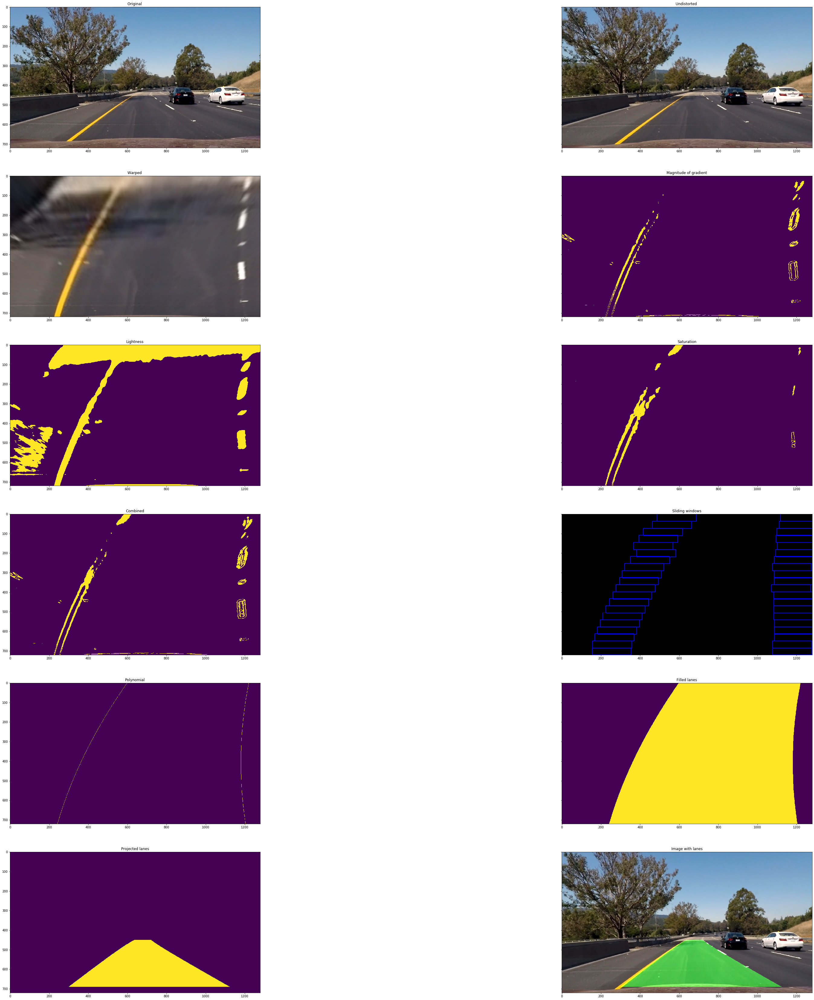

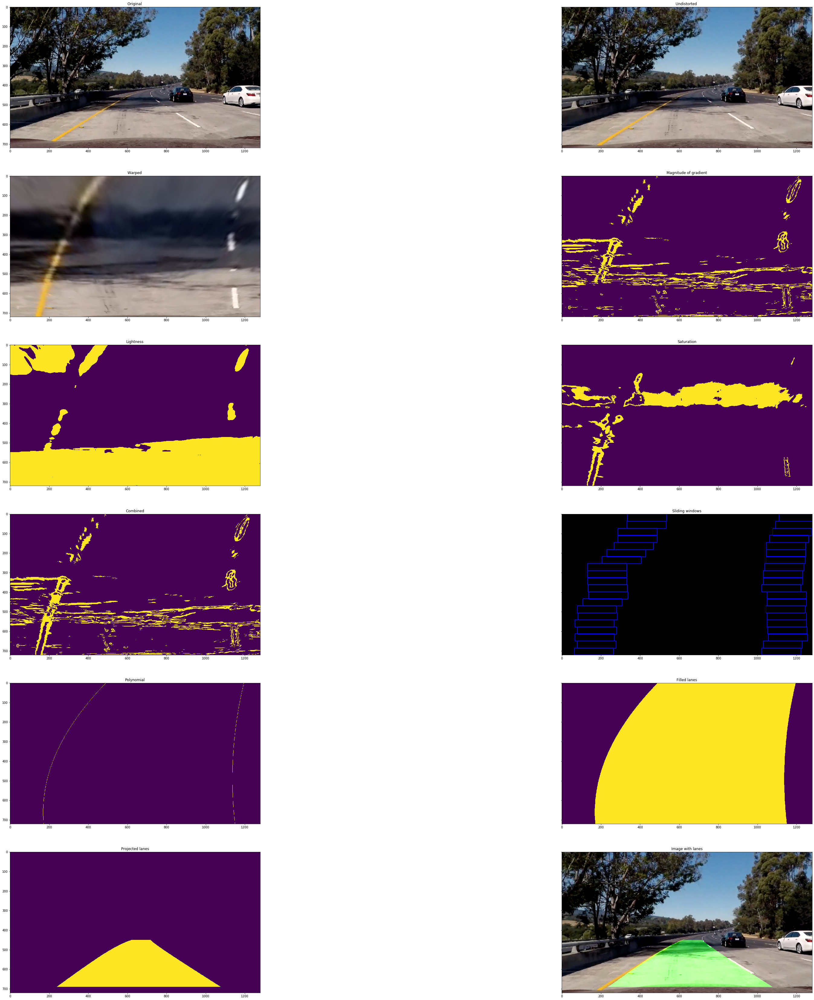

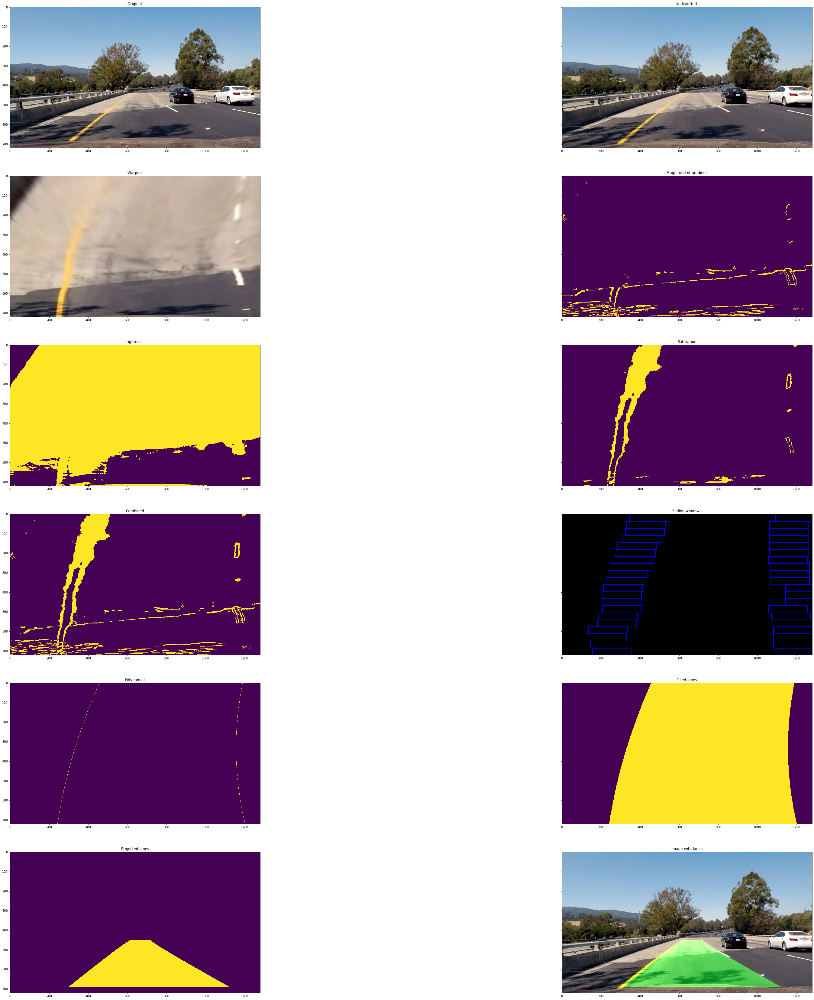

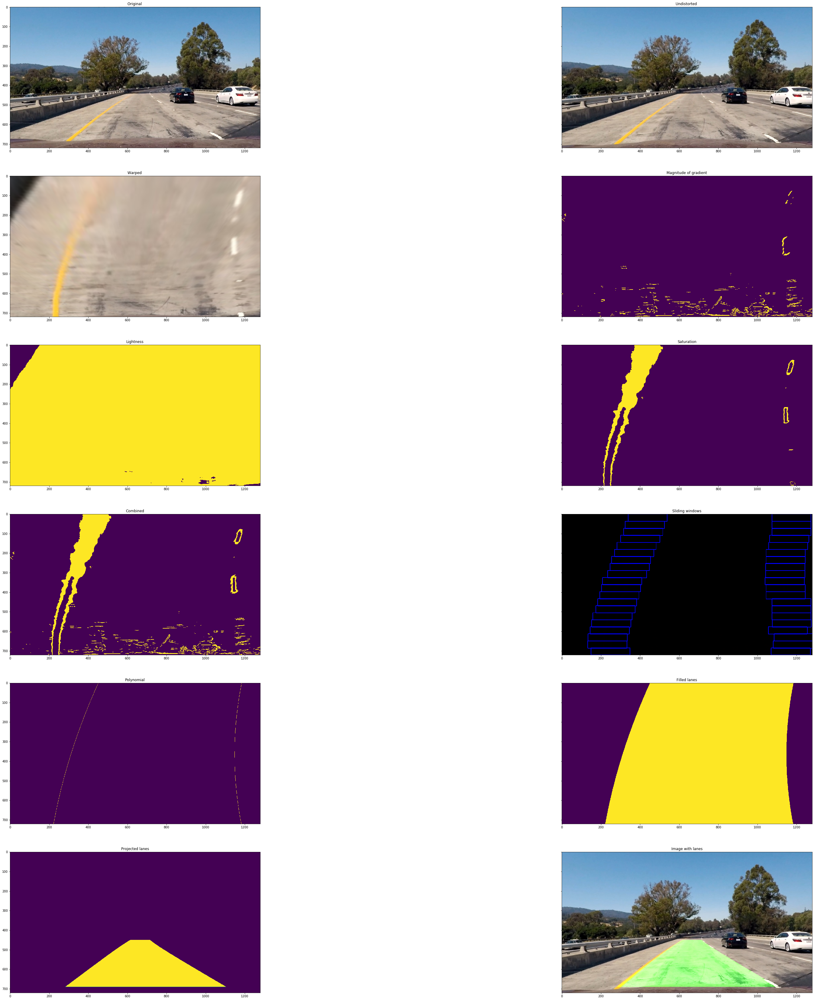

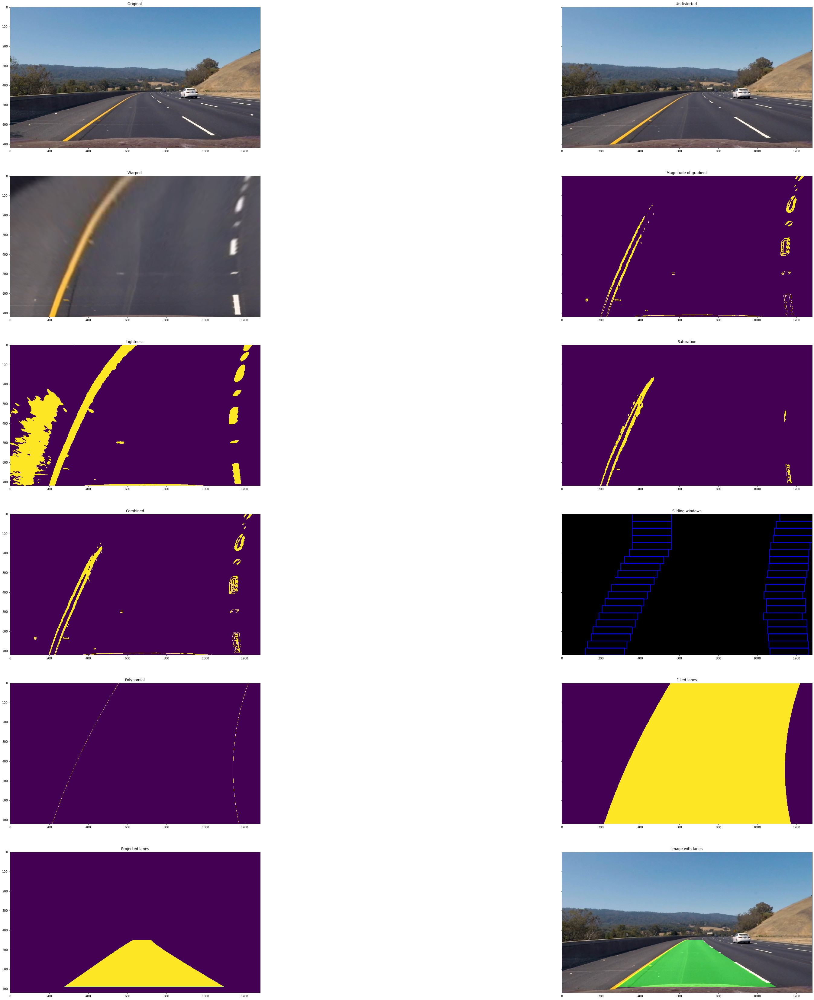

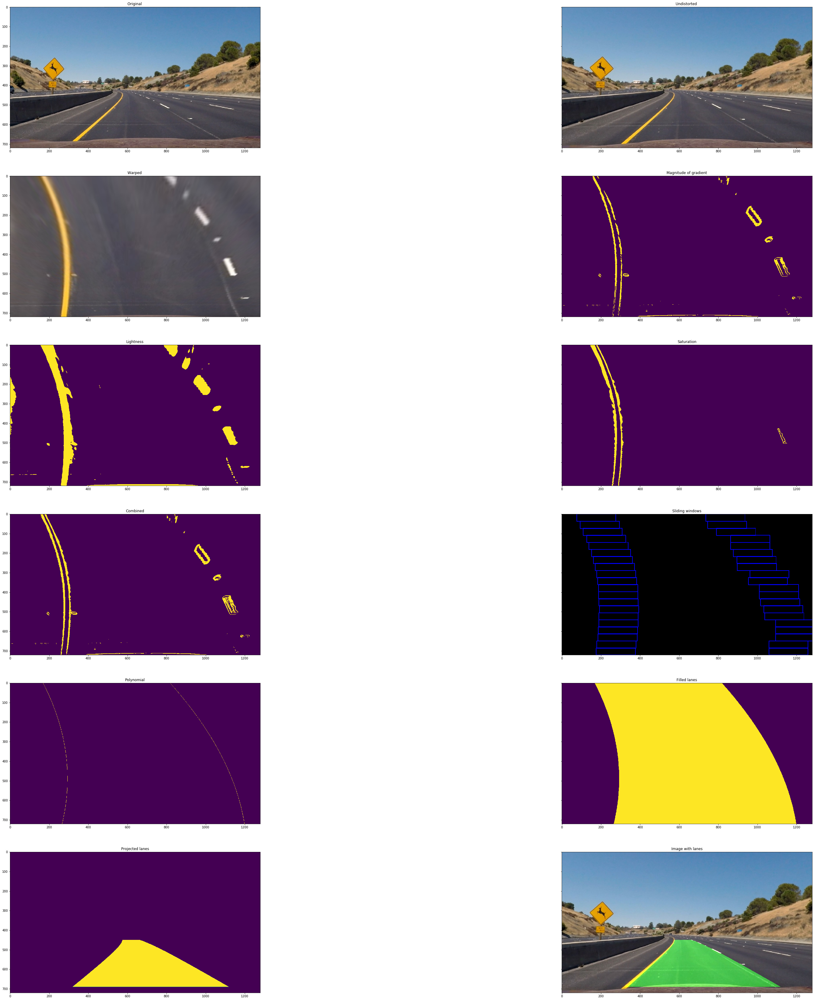

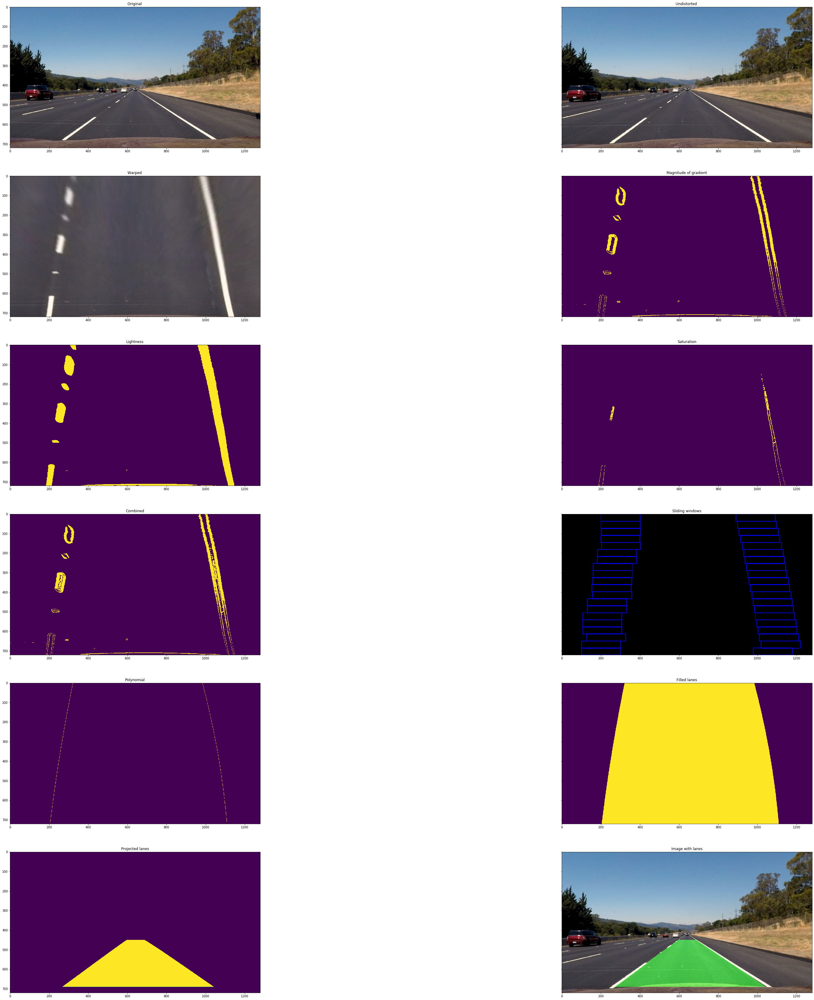

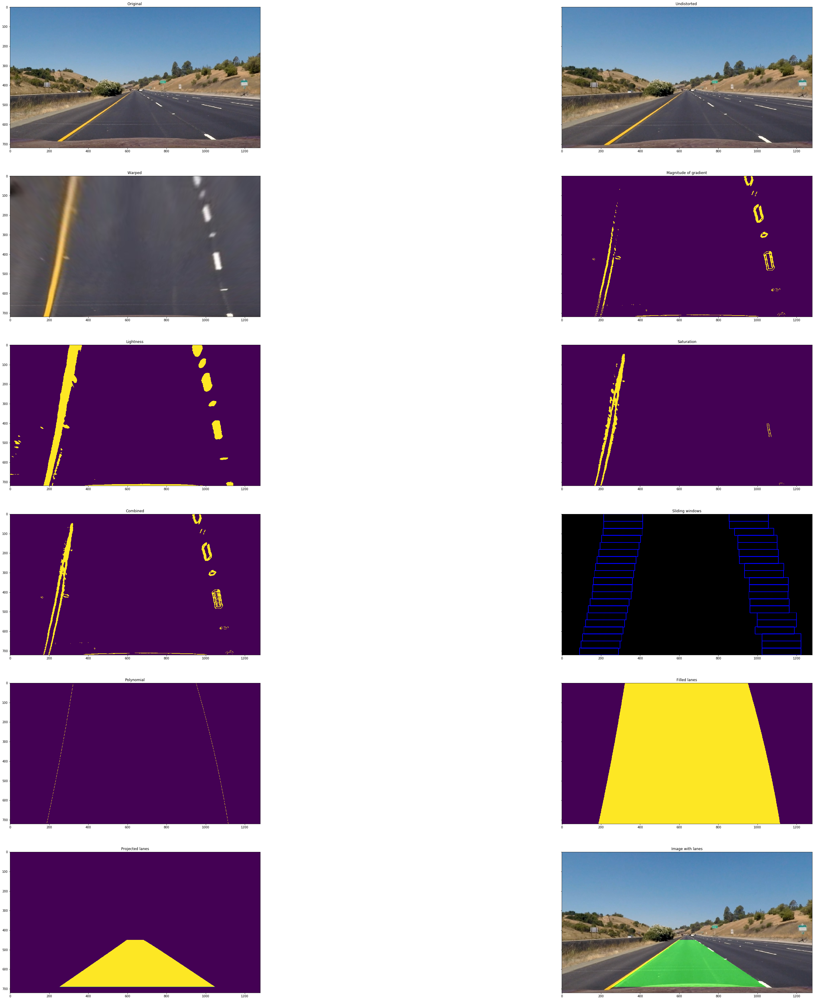

In [5]:
def undistort_image(img):
    return cv2.undistort(img, mtx, dist, None, mtx)

def show_images_in_row(img_array, title_array, cols=2, rows=1, size_in_inches=(60,60)):
    assert len(img_array) == len(title_array)
    assert cols*rows >= len(img_array)

    f, axes = plt.subplots(rows, cols, sharey=True)
    f.set_size_inches(size_in_inches)
    f.size = 50
    for i in range(len(axes)):
        for j in range(len(axes[0])):
            index = i*cols+j
            if index>=len(img_array):
                break
            axes[i,j].set_title(title_array[index])
            try:
                axes[i,j].imshow(img_array[index])
            except:
                axes[i,j].plot(img_array[index])
    

def transformation_points(img):
    # Transform
    shape = img.shape
    xmax = shape[1]
    ymax = shape[0]
    offset = 90
    left_top= (xmax//2-offset, ymax//2+offset)
    right_top= (xmax//2+offset, ymax//2+offset)
    left_bottom= (0+offset, ymax-30)
    right_bottom= (xmax-offset,ymax-30)

    src_points = np.float32([left_top, right_top, right_bottom, left_bottom])
    dst_points = np.float32([(0, 0), (xmax, 0), (xmax, ymax), (0, ymax)])
    return src_points, dst_points
    
    
def get_birds_eye_view_lanes(img, src_points, dst_points):
    shape = img.shape
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (shape[1], shape[0]), flags=cv2.INTER_LINEAR)
    return warped_img

def project_lanes_on_road(img_mask, src_points, dst_points):
    shape = img_mask.shape
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    projected_mask = cv2.warpPerspective(img_mask, M, (shape[1], shape[0]), flags=cv2.INTER_LINEAR)
    return projected_mask


def gradient_magnitude_mask(img, blur=False, blur_kernel=(3,3), thresh_min=30, thresh_max=100):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.medianBlur(gray, 5)

    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1) # Take the derivative in y
    abs_sobely = np.absolute(sobely)

    mag = np.absolute(np.sqrt(np.square(sobelx) + np.square(sobely)))
    mag = np.uint8(255*mag/np.max(mag), dtype=np.float32)
    mag_binary = np.zeros_like(mag, dtype=np.float32)
    mag_binary[(mag >= thresh_min) & (mag <= thresh_max)] = 1
    return mag_binary

def hls_channel_mask(img, channel_id, thresh_min, thresh_max):
    assert (channel_id >= 0) and(channel_id < 3)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    channel = cv2.split(hls)[channel_id]
    binary_mask = np.zeros_like(channel, dtype=np.float32)
    binary_mask[(channel >= thresh_min) & (channel <= thresh_max)] = 1
    return binary_mask


def sliding_windows(img_mask, histogram):
    # Get midpoints of sliding window
    midpoint = histogram.shape[0]//2
    leftx = np.argmax(histogram[:midpoint])
    rightx = np.argmax(histogram[midpoint:]) + midpoint
    n_windows = 20
    xmax = img_mask.shape[1]
    ymax = img_mask.shape[0]
    # Set the sliding window
    window_w = 100
    window_h = ymax//n_windows

    nonzero = img_mask.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    nwindows = ymax//window_h
    leftx_current = leftx
    rightx_current = rightx
    bottom_current = ymax
    top_current = ymax-window_h

    left_lane_indices = []
    right_lane_indices = []

    out_img = np.dstack((img_mask, np.zeros_like(img_mask), np.zeros_like(img_mask)))
    minpix = 10

    for i in range(nwindows):
        leftx_low = leftx_current - window_w
        leftx_high = leftx_current + window_w
        rightx_low = rightx_current - window_w
        rightx_high = rightx_current + window_w
        y_low = top_current
        y_high = bottom_current

        good_left_indices = ((nonzeroy>=y_low) & (nonzeroy<=y_high) & (nonzerox >= leftx_low) & (nonzerox <= leftx_high)).nonzero()[0]
        good_right_indices = ((nonzeroy>=y_low) & (nonzeroy<=y_high) & (nonzerox >= rightx_low) & (nonzerox <= rightx_high)).nonzero()[0]

        left_lane_indices.append(good_left_indices)
        right_lane_indices.append(good_right_indices)

        if(len(good_left_indices) > minpix):
            leftx_current = np.int(np.mean(nonzerox[good_left_indices]))
        if(len(good_right_indices) > minpix):
            rightx_current = np.int(np.mean(nonzerox[good_right_indices]))

        cv2.rectangle(out_img,(leftx_current-window_w, y_high), (leftx_current+window_w, y_low), (0, 0, 255), 2)
        cv2.rectangle(out_img,(rightx_current-window_w, y_high), (rightx_current+window_w, y_low), (0, 0, 255), 2)


        bottom_current = top_current+1
        top_current = top_current-window_h


    left_lane_indices = np.concatenate(left_lane_indices)
    right_lane_indices = np.concatenate(right_lane_indices)

    leftx = nonzerox[left_lane_indices]
    lefty = nonzeroy[left_lane_indices]

    rightx = nonzerox[right_lane_indices]
    righty = nonzeroy[right_lane_indices]
    del left_lane_indices
    del right_lane_indices
    del good_left_indices
    del good_right_indices

    return leftx, lefty, rightx, righty, out_img.astype('uint8')


def fit_polynomial(leftx, lefty, rightx, righty, ym_per_pix, xm_per_pix, img):
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    yaxis_points = np.array(np.linspace(0, img.shape[0]-1, img.shape[0]), dtype=np.int32)
    left_fitx = np.array(left_fit[0]*yaxis_points**2 + left_fit[1]*yaxis_points + left_fit[2], dtype=np.int32)
    right_fitx = np.array(right_fit[0]*yaxis_points**2 + right_fit[1]*yaxis_points + right_fit[2], dtype=np.int32)
    return left_fitx, right_fitx, yaxis_points, left_fit, right_fit

    
def fit_from_prior(left_fitx, right_fitx, yaxis_points, img_mask, margin = 50):
    # Search from prior
    window_img = np.zeros_like(img_mask)
    new_left_fitx = []
    new_right_fitx = []
    for i in range(len(left_fitx)):
        try:
            roi = img_mask[yaxis_points[i],left_fitx[i]-margin:left_fitx[i]+margin+1]
            mean_left_x = left_fitx[i]-margin + int(np.mean(np.where(roi > 0.0)))
            new_left_fitx.append(mean_left_x)
        except:
            new_left_fitx.append(left_fitx[i])
    for i in range(len(right_fitx)):
        try:
            roi = img_mask[yaxis_points[i],right_fitx[i]-margin:right_fitx[i]+margin+1]
            mean_right_x = right_fitx[i]-margin + int(np.mean(np.where(roi > 0.0)))
            new_right_fitx.append(mean_right_x)
        except:
            new_right_fitx.append(right_fitx[i])
    return new_left_fitx, new_right_fitx, yaxis_points
    

def curvature(leftx, rightx, yaxis_points, left_fit, right_fit, ym_per_pix, xm_per_pix):
    left_fit_cr = np.polyfit(yaxis_points*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(yaxis_points*ym_per_pix, rightx*xm_per_pix, 2)
    y_eval = np.max(yaxis_points)

    left_curverad = np.float_power(1+np.square(2*left_fit_cr[0]*y_eval*ym_per_pix+left_fit_cr[1]) ,1.5)/np.abs(2*left_fit_cr[0])  ## Implement the calculation of the left line here
    right_curverad = np.float_power(1+np.square(2*right_fit_cr[0]*y_eval*ym_per_pix+right_fit_cr[1]) ,1.5)/np.abs(2*right_fit_cr[0])  ## Implement the calculation of the right line here
    return left_curverad, right_curverad

def draw_lane(poly_img_mask, left_fitx, right_fitx):
    for pt in range(poly_img_mask.shape[0]):
        poly_img_mask[pt][left_fitx[pt]:right_fitx[pt]+1] = 255
        
    return poly_img_mask

def add_lanes_to_img(img, lane_mask):
    rgb_mask = np.dstack((np.zeros_like(lane_mask), lane_mask, np.zeros_like(lane_mask)))
    return cv2.addWeighted(np.array(img, dtype=np.uint8),1.0, np.array(rgb_mask, dtype=np.uint8),0.5,0)

def get_histogram(img):
    shape = img.shape
    lower_third_img = img[int(img.shape[0]*0.7):,:]
    return np.sum(lower_third_img, axis=0)


def lane_drawing_pipeline(img, PREVIOUS_FIT=[], output=False):
    undist_img = undistort_image(img)    
    src_points, dst_points = transformation_points(undist_img)
    warped_img = get_birds_eye_view_lanes(undist_img, src_points, dst_points)
    warped_img = cv2.GaussianBlur(warped_img,( 1, 7),0)
    
    mag_binary = gradient_magnitude_mask(warped_img, blur=True, thresh_min=30, thresh_max=70)
    l_channel = hls_channel_mask(warped_img, 1, 100, 255)
    s_channel = hls_channel_mask(warped_img, 2, 100, 180)
    combined = np.zeros_like(s_channel)
    combined[((s_channel>0) & (l_channel>0)) | (mag_binary>0)] = 1

    sliding_window_img = np.zeros_like(combined)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    if PREVIOUS_FIT != []:
        new_leftx, new_rightx, yaxis_points = fit_from_prior(PREVIOUS_FIT[0], PREVIOUS_FIT[1], PREVIOUS_FIT[2], combined)
        left_fitx, right_fitx, yaxis_points, left_fit, right_fit = fit_polynomial(new_leftx, yaxis_points, new_rightx, yaxis_points, ym_per_pix, xm_per_pix, combined)
    else:
        # Get histogram
        histogram = get_histogram(combined)
        leftx, lefty, rightx, righty, sliding_window_img = sliding_windows(combined, histogram)
        left_fitx, right_fitx, yaxis_points, left_fit, right_fit = fit_polynomial(leftx, lefty, rightx, righty, ym_per_pix, xm_per_pix, combined)
    poly_mask = np.zeros_like(combined)
    for y,x in zip(yaxis_points, left_fitx):
        y = min(y, poly_mask.shape[0]-1)
        x = min(x, poly_mask.shape[1]-1)
        poly_mask[y,x] = 1
    for y,x in zip(yaxis_points, right_fitx):
        y = min(y, poly_mask.shape[0]-1)
        x = min(x, poly_mask.shape[1]-1)
        poly_mask[y,x] = 1
    curvature_value = curvature(left_fitx, right_fitx, yaxis_points, left_fit, right_fit, ym_per_pix, xm_per_pix)
#     print("Curvature: ", curvature_value)
    lanes_img = draw_lane(np.copy(poly_mask), left_fitx, right_fitx)
    unwarped_img_mask = project_lanes_on_road(lanes_img, dst_points, src_points)
    final_img_with_lanes = add_lanes_to_img(undist_img, unwarped_img_mask)

    title_array = [
        "Original ",
        "Undistorted ",
        "Warped ",
        "Magnitude of gradient",
        "Lightness",
        "Saturation",
        "Combined",
        "Sliding windows",
        "Polynomial",
        "Filled lanes",
        "Projected lanes",
        "Image with lanes"
    ]
    img_array = [
        img, 
        undist_img, 
        warped_img, 
        mag_binary,
        l_channel,
        s_channel,
        combined,
        sliding_window_img,
        poly_mask,
        lanes_img,
        unwarped_img_mask,
        final_img_with_lanes
    ]
    if output:
        show_images_in_row(img_array, title_array, cols=2, rows=(len(title_array)+1)//2)

    return final_img_with_lanes, curvature_value, [left_fitx, right_fitx, yaxis_points], img_array


# TODO
# 2. Complete the writeup with image links
TEST_IMAGES_DIR = 'test_images'
for test_img_path in glob.glob(TEST_IMAGES_DIR+"/*.jpg"):
    print(test_img_path)
    test_img = load_image(test_img_path)
    final_img_with_lanes, curvature_value, _, img_array= lane_drawing_pipeline(test_img, output=True)
    save_image(img_array[1], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_undistorted")
    save_image(img_array[2], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_warped")
    save_image(img_array[3], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_mag_binary")
    save_image(img_array[4], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_l_channel_binary")
    save_image(img_array[5], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_s_channel_binary")
    save_image(img_array[6], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_final_binary")
    save_image(img_array[7], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_sliding_windows")
    save_image(img_array[8], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_polynomial")
    save_image(img_array[11], os.path.basename(test_img_path), TEST_IMAGES_DIR+"_with_lanes")
    

In [6]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

PREVIOUS_FIT = []
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    global PREVIOUS_FIT
    img_with_lanes, curvature, PREVIOUS_FIT, _ = lane_drawing_pipeline(image, PREVIOUS_FIT)
    return img_with_lanes

project_output = 'project_video_output.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(project_output, audio=False)

t:   0%|          | 0/1260 [00:00<?, ?it/s, now=None]

Curvature:  (317.23827664611093, 416.8274839389158)
Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



t:   0%|          | 2/1260 [00:00<02:44,  7.66it/s, now=None]

Curvature:  (336.4648801361385, 418.4084187862943)


t:   0%|          | 3/1260 [00:00<03:23,  6.16it/s, now=None]

Curvature:  (332.69640552435766, 409.1660909788728)


t:   0%|          | 4/1260 [00:00<03:45,  5.58it/s, now=None]

Curvature:  (331.7771961079106, 420.8492093694436)


t:   0%|          | 5/1260 [00:01<05:21,  3.91it/s, now=None]

Curvature:  (324.7466067756091, 451.7229144942337)


t:   0%|          | 6/1260 [00:01<07:15,  2.88it/s, now=None]

Curvature:  (329.56155682009773, 465.74617547459553)


t:   1%|          | 7/1260 [00:01<06:43,  3.10it/s, now=None]

Curvature:  (324.0350883154972, 466.63221208496435)


t:   1%|          | 8/1260 [00:02<06:33,  3.19it/s, now=None]

Curvature:  (342.32231369732796, 452.6031165056849)


t:   1%|          | 9/1260 [00:02<07:06,  2.93it/s, now=None]

Curvature:  (345.6626442093692, 391.6624231243982)


t:   1%|          | 10/1260 [00:03<08:40,  2.40it/s, now=None]

Curvature:  (370.374418112083, 377.2915064427621)


t:   1%|          | 11/1260 [00:03<08:47,  2.37it/s, now=None]

Curvature:  (379.1154685684597, 375.5330161770768)


t:   1%|          | 12/1260 [00:04<08:22,  2.48it/s, now=None]

Curvature:  (380.2613577511417, 357.9551117858231)


t:   1%|          | 13/1260 [00:04<08:20,  2.49it/s, now=None]

Curvature:  (416.3190936587873, 394.7371072307984)


t:   1%|          | 14/1260 [00:04<07:41,  2.70it/s, now=None]

Curvature:  (425.98313554239513, 434.76321693993236)


t:   1%|          | 15/1260 [00:05<07:12,  2.88it/s, now=None]

Curvature:  (442.7757762507102, 457.6232186822897)


t:   1%|▏         | 16/1260 [00:05<06:52,  3.01it/s, now=None]

Curvature:  (410.767966951015, 532.8291716852534)


t:   1%|▏         | 17/1260 [00:05<07:29,  2.76it/s, now=None]

Curvature:  (398.17732881234156, 592.4535117458057)


t:   1%|▏         | 18/1260 [00:06<09:09,  2.26it/s, now=None]

Curvature:  (384.4902195579321, 507.8181740494688)


t:   2%|▏         | 19/1260 [00:06<08:39,  2.39it/s, now=None]

Curvature:  (385.8631423404722, 478.9158756860267)


t:   2%|▏         | 20/1260 [00:07<08:00,  2.58it/s, now=None]

Curvature:  (392.388296479371, 408.54864541110675)


t:   2%|▏         | 21/1260 [00:07<07:49,  2.64it/s, now=None]

Curvature:  (403.02099394465887, 369.54552710341454)


t:   2%|▏         | 22/1260 [00:07<07:11,  2.87it/s, now=None]

Curvature:  (437.9847978506397, 360.9053452814079)


t:   2%|▏         | 23/1260 [00:08<07:47,  2.64it/s, now=None]

Curvature:  (460.51885480563584, 338.9699318377209)


t:   2%|▏         | 24/1260 [00:08<07:57,  2.59it/s, now=None]

Curvature:  (487.9293787918048, 323.8202883528783)


t:   2%|▏         | 25/1260 [00:08<07:18,  2.82it/s, now=None]

Curvature:  (438.9384105923178, 333.0616824920538)


t:   2%|▏         | 26/1260 [00:09<07:01,  2.93it/s, now=None]

Curvature:  (409.5680554823637, 331.8310598528208)


t:   2%|▏         | 27/1260 [00:09<07:26,  2.76it/s, now=None]

Curvature:  (431.57203030764447, 367.3679773479713)


t:   2%|▏         | 28/1260 [00:10<07:56,  2.59it/s, now=None]

Curvature:  (406.51566563441645, 375.6201211681021)


t:   2%|▏         | 29/1260 [00:10<07:53,  2.60it/s, now=None]

Curvature:  (408.66200086674655, 410.6048576495247)


t:   2%|▏         | 30/1260 [00:10<07:28,  2.74it/s, now=None]

Curvature:  (368.8493859865383, 422.00514272127424)


t:   2%|▏         | 31/1260 [00:11<07:34,  2.71it/s, now=None]

Curvature:  (331.2922148123984, 454.4505890756017)


t:   3%|▎         | 32/1260 [00:11<07:17,  2.81it/s, now=None]

Curvature:  (301.8538451943466, 454.66654312544404)


t:   3%|▎         | 33/1260 [00:12<10:36,  1.93it/s, now=None]

Curvature:  (280.1932751057927, 447.42637729045015)


t:   3%|▎         | 34/1260 [00:12<09:50,  2.08it/s, now=None]

Curvature:  (288.0570117302651, 396.91954573107614)


t:   3%|▎         | 35/1260 [00:13<09:47,  2.09it/s, now=None]

Curvature:  (270.6395692627144, 334.25294333190845)


t:   3%|▎         | 36/1260 [00:13<09:05,  2.24it/s, now=None]

Curvature:  (263.5511324944356, 292.3161095190454)


t:   3%|▎         | 37/1260 [00:14<09:16,  2.20it/s, now=None]

Curvature:  (258.2427380413947, 284.46017751785814)


t:   3%|▎         | 38/1260 [00:14<09:30,  2.14it/s, now=None]

Curvature:  (256.08960398144586, 292.7496256057187)


t:   3%|▎         | 39/1260 [00:14<08:35,  2.37it/s, now=None]

Curvature:  (247.197625450266, 300.2197450281841)


t:   3%|▎         | 40/1260 [00:15<07:52,  2.58it/s, now=None]

Curvature:  (243.92275710454513, 313.52569829773967)


t:   3%|▎         | 41/1260 [00:15<09:20,  2.18it/s, now=None]

Curvature:  (250.10826934869343, 314.191154346093)


t:   3%|▎         | 42/1260 [00:16<09:22,  2.17it/s, now=None]

Curvature:  (254.43012942693687, 324.2370993532667)


t:   3%|▎         | 43/1260 [00:16<09:01,  2.25it/s, now=None]

Curvature:  (255.16037727730338, 321.5496375629327)


t:   3%|▎         | 44/1260 [00:17<08:36,  2.35it/s, now=None]

Curvature:  (267.54620329367833, 300.5189858458322)


t:   4%|▎         | 45/1260 [00:17<08:10,  2.48it/s, now=None]

Curvature:  (279.292934856146, 303.90018840501824)


t:   4%|▎         | 46/1260 [00:17<07:35,  2.67it/s, now=None]

Curvature:  (288.6319544647947, 294.0029616973531)


t:   4%|▎         | 47/1260 [00:18<07:20,  2.76it/s, now=None]

Curvature:  (300.4920110780658, 286.8924830504588)


t:   4%|▍         | 48/1260 [00:18<06:52,  2.94it/s, now=None]

Curvature:  (316.9787102871309, 280.9766781389801)


t:   4%|▍         | 49/1260 [00:18<06:48,  2.96it/s, now=None]

Curvature:  (323.3099122953905, 277.3809056566659)


t:   4%|▍         | 50/1260 [00:18<06:45,  2.98it/s, now=None]

Curvature:  (348.7091609635788, 287.896925893026)


t:   4%|▍         | 51/1260 [00:19<06:43,  2.99it/s, now=None]

Curvature:  (357.54931123744456, 300.28479314805855)


t:   4%|▍         | 52/1260 [00:19<06:35,  3.06it/s, now=None]

Curvature:  (376.2102526450896, 306.9825660266183)


t:   4%|▍         | 53/1260 [00:19<06:32,  3.08it/s, now=None]

Curvature:  (379.9031381180408, 318.334144824779)


t:   4%|▍         | 54/1260 [00:20<06:33,  3.07it/s, now=None]

Curvature:  (385.4456231396362, 338.4968002259192)


t:   4%|▍         | 55/1260 [00:20<06:46,  2.96it/s, now=None]

Curvature:  (395.46833466262314, 357.19385702074175)


t:   4%|▍         | 56/1260 [00:21<07:00,  2.86it/s, now=None]

Curvature:  (398.1321195944747, 360.26782820032435)


t:   5%|▍         | 57/1260 [00:21<06:53,  2.91it/s, now=None]

Curvature:  (409.2660325758464, 368.0590275807193)


t:   5%|▍         | 58/1260 [00:21<06:39,  3.01it/s, now=None]

Curvature:  (406.88796770934476, 364.93965962710047)


t:   5%|▍         | 59/1260 [00:21<06:38,  3.02it/s, now=None]

Curvature:  (410.775110236826, 363.14442161761934)


t:   5%|▍         | 60/1260 [00:22<06:41,  2.99it/s, now=None]

Curvature:  (403.1891958941291, 379.50306375419433)


t:   5%|▍         | 61/1260 [00:22<06:33,  3.04it/s, now=None]

Curvature:  (394.0801905763322, 405.2204166386978)


t:   5%|▍         | 62/1260 [00:22<06:46,  2.95it/s, now=None]

Curvature:  (387.4053639128915, 422.122203224317)


t:   5%|▌         | 63/1260 [00:23<06:48,  2.93it/s, now=None]

Curvature:  (375.811287323875, 442.22134124324725)


t:   5%|▌         | 64/1260 [00:23<06:49,  2.92it/s, now=None]

Curvature:  (393.08180494584684, 378.8274185768083)


t:   5%|▌         | 65/1260 [00:24<06:53,  2.89it/s, now=None]

Curvature:  (382.05229736867193, 316.60882378169265)


t:   5%|▌         | 66/1260 [00:24<06:39,  2.99it/s, now=None]

Curvature:  (386.32784120470944, 306.01199622560813)


t:   5%|▌         | 67/1260 [00:24<06:30,  3.06it/s, now=None]

Curvature:  (382.61089591453316, 297.7209434645834)


t:   5%|▌         | 68/1260 [00:25<06:45,  2.94it/s, now=None]

Curvature:  (393.91949398161626, 311.87404668038585)


t:   5%|▌         | 69/1260 [00:25<06:43,  2.95it/s, now=None]

Curvature:  (392.08105525925697, 320.15011726100465)


t:   6%|▌         | 70/1260 [00:25<06:34,  3.01it/s, now=None]

Curvature:  (371.12334718816686, 317.6083541335412)


t:   6%|▌         | 71/1260 [00:26<06:47,  2.92it/s, now=None]

Curvature:  (392.3075689390362, 326.09508609366566)


t:   6%|▌         | 72/1260 [00:26<07:40,  2.58it/s, now=None]

Curvature:  (399.71307079940726, 347.0592076685535)


t:   6%|▌         | 73/1260 [00:26<07:09,  2.76it/s, now=None]

Curvature:  (419.30926540160067, 340.3490339289759)


t:   6%|▌         | 74/1260 [00:27<06:45,  2.93it/s, now=None]

Curvature:  (434.5632679671119, 338.44886827861995)


t:   6%|▌         | 75/1260 [00:27<06:54,  2.86it/s, now=None]

Curvature:  (449.1560414034623, 339.6140060601883)


t:   6%|▌         | 76/1260 [00:27<06:58,  2.83it/s, now=None]

Curvature:  (494.5393096267036, 343.1251613406146)


t:   6%|▌         | 77/1260 [00:28<06:51,  2.88it/s, now=None]

Curvature:  (494.58439812546254, 337.52322865652616)


t:   6%|▌         | 78/1260 [00:28<07:13,  2.72it/s, now=None]

Curvature:  (568.1597916900276, 330.5944447028864)


t:   6%|▋         | 79/1260 [00:29<07:30,  2.62it/s, now=None]

Curvature:  (590.7560954941515, 328.5014482690409)


t:   6%|▋         | 80/1260 [00:29<08:42,  2.26it/s, now=None]

Curvature:  (617.027930164728, 340.491473362091)


t:   6%|▋         | 81/1260 [00:30<09:14,  2.13it/s, now=None]

Curvature:  (572.5624619859242, 353.39139709705415)


t:   7%|▋         | 82/1260 [00:30<08:10,  2.40it/s, now=None]

Curvature:  (535.7045970334518, 382.6827422912498)


t:   7%|▋         | 83/1260 [00:30<07:52,  2.49it/s, now=None]

Curvature:  (509.2722270933845, 378.4376978725298)


t:   7%|▋         | 84/1260 [00:31<07:36,  2.58it/s, now=None]

Curvature:  (490.47966599707706, 350.1723508032422)


t:   7%|▋         | 85/1260 [00:31<07:16,  2.69it/s, now=None]

Curvature:  (502.13399238160787, 338.9714791126928)


t:   7%|▋         | 86/1260 [00:31<07:05,  2.76it/s, now=None]

Curvature:  (477.57802866927415, 320.62840431990486)


t:   7%|▋         | 87/1260 [00:32<07:01,  2.79it/s, now=None]

Curvature:  (449.7109141180988, 328.8466754647089)


t:   7%|▋         | 88/1260 [00:32<07:21,  2.65it/s, now=None]

Curvature:  (403.74814674520604, 334.2793574387573)


t:   7%|▋         | 89/1260 [00:32<07:17,  2.68it/s, now=None]

Curvature:  (386.21969896791035, 361.4033543247174)


t:   7%|▋         | 90/1260 [00:33<08:38,  2.26it/s, now=None]

Curvature:  (354.57309738688014, 392.1313839030718)


t:   7%|▋         | 91/1260 [00:33<07:29,  2.60it/s, now=None]

Curvature:  (329.6510498646413, 380.27260668321253)


t:   7%|▋         | 92/1260 [00:34<06:44,  2.89it/s, now=None]

Curvature:  (322.77890673710004, 364.6037463015061)


t:   7%|▋         | 93/1260 [00:34<07:38,  2.55it/s, now=None]

Curvature:  (330.0097060320117, 366.6285646475765)


t:   7%|▋         | 94/1260 [00:34<07:23,  2.63it/s, now=None]

Curvature:  (309.0887764592194, 321.04207953957535)


t:   8%|▊         | 95/1260 [00:35<06:31,  2.98it/s, now=None]

Curvature:  (301.8592668528609, 326.27013933839714)


t:   8%|▊         | 96/1260 [00:35<06:58,  2.78it/s, now=None]

Curvature:  (311.35313523479505, 349.20541600634925)


t:   8%|▊         | 97/1260 [00:36<07:45,  2.50it/s, now=None]

Curvature:  (316.7569034450694, 355.73803394399727)


t:   8%|▊         | 98/1260 [00:36<07:06,  2.73it/s, now=None]

Curvature:  (315.41776699905114, 331.6514933865439)


t:   8%|▊         | 99/1260 [00:36<06:40,  2.90it/s, now=None]

Curvature:  (324.8340320128843, 324.45563752818344)


t:   8%|▊         | 100/1260 [00:37<07:08,  2.70it/s, now=None]

Curvature:  (316.83574239894494, 316.4057904284319)


t:   8%|▊         | 101/1260 [00:37<06:32,  2.95it/s, now=None]

Curvature:  (332.0562072197404, 316.4621316353656)


t:   8%|▊         | 102/1260 [00:37<07:11,  2.69it/s, now=None]

Curvature:  (334.2666992365137, 318.52318204479934)


t:   8%|▊         | 103/1260 [00:38<06:27,  2.98it/s, now=None]

Curvature:  (330.33206870011986, 323.96603025431494)


t:   8%|▊         | 104/1260 [00:38<06:07,  3.15it/s, now=None]

Curvature:  (323.7180412051473, 326.1650319980282)


t:   8%|▊         | 105/1260 [00:38<06:20,  3.04it/s, now=None]

Curvature:  (323.0657678617001, 330.2796844501871)


t:   8%|▊         | 106/1260 [00:39<07:02,  2.73it/s, now=None]

Curvature:  (329.8476867385674, 335.77804379121017)


t:   8%|▊         | 107/1260 [00:39<07:03,  2.72it/s, now=None]

Curvature:  (328.12152055668247, 342.01849447559175)


t:   9%|▊         | 108/1260 [00:39<06:36,  2.90it/s, now=None]

Curvature:  (334.07261891353187, 346.6149663404423)


t:   9%|▊         | 109/1260 [00:40<06:54,  2.78it/s, now=None]

Curvature:  (310.5614179585169, 320.2128094813759)


t:   9%|▊         | 110/1260 [00:40<07:12,  2.66it/s, now=None]

Curvature:  (317.19940078701364, 283.621062983555)


t:   9%|▉         | 111/1260 [00:41<08:12,  2.33it/s, now=None]

Curvature:  (316.53512945134014, 276.4571711049145)


t:   9%|▉         | 112/1260 [00:41<07:16,  2.63it/s, now=None]

Curvature:  (313.554431701658, 265.7299829075435)


t:   9%|▉         | 113/1260 [00:41<06:21,  3.01it/s, now=None]

Curvature:  (324.45585525373383, 276.9192655054226)


t:   9%|▉         | 114/1260 [00:41<05:49,  3.28it/s, now=None]

Curvature:  (305.3049341089489, 272.98801608755076)


t:   9%|▉         | 115/1260 [00:42<05:22,  3.55it/s, now=None]

Curvature:  (302.3631840498114, 271.90597265934014)


t:   9%|▉         | 116/1260 [00:42<05:16,  3.61it/s, now=None]

Curvature:  (288.50329530974216, 269.07967782097336)


t:   9%|▉         | 117/1260 [00:42<06:08,  3.10it/s, now=None]

Curvature:  (287.36889683422277, 269.09262741410873)


t:   9%|▉         | 118/1260 [00:43<07:02,  2.70it/s, now=None]

Curvature:  (289.64719524802723, 285.39205911289486)


t:   9%|▉         | 119/1260 [00:43<07:28,  2.54it/s, now=None]

Curvature:  (281.9916696484393, 278.58004801962795)


t:  10%|▉         | 120/1260 [00:44<07:42,  2.46it/s, now=None]

Curvature:  (284.826517627639, 256.30066778836067)


t:  10%|▉         | 121/1260 [00:44<08:16,  2.30it/s, now=None]

Curvature:  (272.70183096021077, 242.38569825049188)


t:  10%|▉         | 122/1260 [00:45<08:26,  2.25it/s, now=None]

Curvature:  (276.65253988416225, 250.73657611864806)


t:  10%|▉         | 123/1260 [00:45<07:53,  2.40it/s, now=None]

Curvature:  (278.8550615241535, 243.45749853531063)


t:  10%|▉         | 124/1260 [00:45<07:29,  2.53it/s, now=None]

Curvature:  (275.924466023368, 245.84949407991252)


t:  10%|▉         | 125/1260 [00:46<07:19,  2.58it/s, now=None]

Curvature:  (282.1614215681439, 247.38662672269498)


t:  10%|█         | 126/1260 [00:46<06:53,  2.74it/s, now=None]

Curvature:  (284.68498995693705, 253.5605797007048)


t:  10%|█         | 127/1260 [00:46<06:42,  2.82it/s, now=None]

Curvature:  (304.4475646984114, 249.09117087156093)


t:  10%|█         | 128/1260 [00:47<07:00,  2.69it/s, now=None]

Curvature:  (302.61467026803564, 255.11147945274746)


t:  10%|█         | 129/1260 [00:47<06:55,  2.72it/s, now=None]

Curvature:  (317.38164863424254, 265.4959896618177)


t:  10%|█         | 130/1260 [00:48<07:49,  2.40it/s, now=None]

Curvature:  (310.8633659328943, 283.0864025658079)


t:  10%|█         | 131/1260 [00:48<06:54,  2.72it/s, now=None]

Curvature:  (311.79624559921456, 306.2805075896243)


t:  10%|█         | 132/1260 [00:48<07:07,  2.64it/s, now=None]

Curvature:  (309.8935343953615, 294.61110605168375)


t:  11%|█         | 133/1260 [00:49<07:11,  2.61it/s, now=None]

Curvature:  (309.81337140143745, 297.5135756393246)


t:  11%|█         | 134/1260 [00:49<06:49,  2.75it/s, now=None]

Curvature:  (314.9182851147109, 303.7591427509398)


t:  11%|█         | 135/1260 [00:49<06:06,  3.07it/s, now=None]

Curvature:  (320.75408607364926, 308.40704838793306)


t:  11%|█         | 136/1260 [00:50<05:43,  3.27it/s, now=None]

Curvature:  (338.4519002314861, 295.74098273850063)


t:  11%|█         | 137/1260 [00:50<05:54,  3.17it/s, now=None]

Curvature:  (348.4672122036042, 291.3734900224645)


t:  11%|█         | 138/1260 [00:50<05:18,  3.52it/s, now=None]

Curvature:  (361.56361158510987, 289.56425489331224)


t:  11%|█         | 139/1260 [00:50<04:56,  3.78it/s, now=None]

Curvature:  (385.25369867811673, 293.53876692951144)


t:  11%|█         | 140/1260 [00:51<05:04,  3.68it/s, now=None]

Curvature:  (399.0324943599882, 301.5518739444148)


t:  11%|█         | 141/1260 [00:51<04:55,  3.78it/s, now=None]

Curvature:  (434.7721023704449, 310.3739230202097)


t:  11%|█▏        | 142/1260 [00:51<04:40,  3.99it/s, now=None]

Curvature:  (435.17452889929734, 335.58719421025114)


t:  11%|█▏        | 143/1260 [00:51<04:32,  4.10it/s, now=None]

Curvature:  (436.2485065356386, 369.51267828314184)


t:  11%|█▏        | 144/1260 [00:52<05:45,  3.23it/s, now=None]

Curvature:  (401.89601154340335, 354.4958288472391)


t:  12%|█▏        | 145/1260 [00:52<05:47,  3.21it/s, now=None]

Curvature:  (394.2191558879081, 337.76610007553074)


t:  12%|█▏        | 146/1260 [00:52<05:28,  3.39it/s, now=None]

Curvature:  (394.6753286670742, 344.0290557138939)


t:  12%|█▏        | 147/1260 [00:53<05:16,  3.52it/s, now=None]

Curvature:  (387.8816269110019, 347.0796703564403)


t:  12%|█▏        | 148/1260 [00:53<05:10,  3.58it/s, now=None]

Curvature:  (406.98440233316285, 343.6865036766362)


t:  12%|█▏        | 149/1260 [00:53<05:10,  3.58it/s, now=None]

Curvature:  (369.27217229320735, 350.06440558616504)


t:  12%|█▏        | 150/1260 [00:53<05:23,  3.43it/s, now=None]

Curvature:  (363.9526408051791, 353.9251392841987)


t:  12%|█▏        | 151/1260 [00:54<07:02,  2.63it/s, now=None]

Curvature:  (382.5619101265463, 342.361860413232)


t:  12%|█▏        | 152/1260 [00:54<06:56,  2.66it/s, now=None]

Curvature:  (405.52047172431946, 333.31183692064445)


t:  12%|█▏        | 153/1260 [00:55<07:34,  2.43it/s, now=None]

Curvature:  (407.8181734165898, 327.96568558232417)


t:  12%|█▏        | 154/1260 [00:55<06:53,  2.68it/s, now=None]

Curvature:  (383.64679012255084, 344.2252519622711)


t:  12%|█▏        | 155/1260 [00:55<06:15,  2.94it/s, now=None]

Curvature:  (406.01893641863757, 359.920854690126)


t:  12%|█▏        | 156/1260 [00:56<06:03,  3.03it/s, now=None]

Curvature:  (400.43060204305476, 393.19660242712047)


t:  12%|█▏        | 157/1260 [00:56<05:42,  3.22it/s, now=None]

Curvature:  (387.8591338503782, 394.98983054744775)


t:  13%|█▎        | 158/1260 [00:56<05:22,  3.42it/s, now=None]

Curvature:  (389.66408844014495, 379.6344486064341)


t:  13%|█▎        | 159/1260 [00:57<05:09,  3.55it/s, now=None]

Curvature:  (365.50152783657114, 379.22634423246024)


t:  13%|█▎        | 160/1260 [00:57<05:02,  3.63it/s, now=None]

Curvature:  (358.3406258996413, 350.0518798006225)


t:  13%|█▎        | 161/1260 [00:57<04:57,  3.70it/s, now=None]

Curvature:  (345.1667579700792, 339.40083710257596)


t:  13%|█▎        | 162/1260 [00:57<04:46,  3.84it/s, now=None]

Curvature:  (357.62093677791694, 323.3929124641019)


t:  13%|█▎        | 163/1260 [00:57<04:37,  3.95it/s, now=None]

Curvature:  (363.02555943278213, 314.45811631327047)


t:  13%|█▎        | 164/1260 [00:58<04:38,  3.94it/s, now=None]

Curvature:  (377.6759025584411, 311.9947759951225)


t:  13%|█▎        | 165/1260 [00:58<04:35,  3.97it/s, now=None]

Curvature:  (359.8353808551843, 327.21652221063994)


t:  13%|█▎        | 166/1260 [00:58<04:28,  4.07it/s, now=None]

Curvature:  (334.9519736816427, 353.8907918556146)


t:  13%|█▎        | 167/1260 [00:58<04:21,  4.18it/s, now=None]

Curvature:  (345.8340534950254, 362.6009756346527)


t:  13%|█▎        | 168/1260 [00:59<04:29,  4.06it/s, now=None]

Curvature:  (318.342567738345, 415.55202292873867)


t:  13%|█▎        | 169/1260 [00:59<04:26,  4.10it/s, now=None]

Curvature:  (343.40463785557694, 369.10081015353114)


t:  13%|█▎        | 170/1260 [00:59<04:23,  4.14it/s, now=None]

Curvature:  (352.6496630726428, 295.7817817826615)


t:  14%|█▎        | 171/1260 [00:59<04:27,  4.08it/s, now=None]

Curvature:  (371.45472334883107, 267.9082232038846)


t:  14%|█▎        | 172/1260 [01:00<04:29,  4.04it/s, now=None]

Curvature:  (371.83358118891, 244.85750862007183)


t:  14%|█▎        | 173/1260 [01:00<04:24,  4.11it/s, now=None]

Curvature:  (372.5950025760583, 224.90041391366861)


t:  14%|█▍        | 174/1260 [01:00<04:19,  4.18it/s, now=None]

Curvature:  (356.49554209893444, 215.4060229972104)


t:  14%|█▍        | 175/1260 [01:00<04:20,  4.16it/s, now=None]

Curvature:  (321.14002849099234, 218.88738624066235)


t:  14%|█▍        | 176/1260 [01:01<04:22,  4.13it/s, now=None]

Curvature:  (306.6333535105802, 221.28720895657838)


t:  14%|█▍        | 177/1260 [01:01<04:16,  4.23it/s, now=None]

Curvature:  (304.52701210487214, 211.89686177526468)


t:  14%|█▍        | 178/1260 [01:01<04:10,  4.33it/s, now=None]

Curvature:  (337.2177674286304, 205.0761986107258)


t:  14%|█▍        | 179/1260 [01:01<04:09,  4.33it/s, now=None]

Curvature:  (333.51412368205473, 205.91068671217548)


t:  14%|█▍        | 180/1260 [01:02<04:14,  4.24it/s, now=None]

Curvature:  (328.43169252144907, 214.54120269390546)


t:  14%|█▍        | 181/1260 [01:02<04:09,  4.33it/s, now=None]

Curvature:  (324.27050161208115, 227.200964576309)


t:  14%|█▍        | 182/1260 [01:02<04:03,  4.42it/s, now=None]

Curvature:  (295.6393476982227, 213.6007878965685)


t:  15%|█▍        | 183/1260 [01:02<04:01,  4.46it/s, now=None]

Curvature:  (299.553800206547, 219.55009618763364)


t:  15%|█▍        | 184/1260 [01:02<04:08,  4.34it/s, now=None]

Curvature:  (279.7500692801894, 216.7209704535644)


t:  15%|█▍        | 185/1260 [01:03<04:02,  4.43it/s, now=None]

Curvature:  (261.66560932521884, 221.18984671373553)


t:  15%|█▍        | 186/1260 [01:03<03:58,  4.50it/s, now=None]

Curvature:  (252.02248862728982, 225.34835233152953)


t:  15%|█▍        | 187/1260 [01:03<03:55,  4.55it/s, now=None]

Curvature:  (224.85489681527497, 256.2953309473546)


t:  15%|█▍        | 188/1260 [01:03<04:09,  4.30it/s, now=None]

Curvature:  (224.03129550832475, 270.134953572181)


t:  15%|█▌        | 189/1260 [01:04<04:10,  4.27it/s, now=None]

Curvature:  (218.52578991288578, 268.77654181857395)


t:  15%|█▌        | 190/1260 [01:04<04:13,  4.22it/s, now=None]

Curvature:  (221.70694409448936, 237.28565117911427)


t:  15%|█▌        | 191/1260 [01:04<04:05,  4.35it/s, now=None]

Curvature:  (225.18687885011335, 217.47946581655975)


t:  15%|█▌        | 192/1260 [01:04<04:09,  4.27it/s, now=None]

Curvature:  (222.25862651098072, 213.90327415277832)


t:  15%|█▌        | 193/1260 [01:05<04:08,  4.30it/s, now=None]

Curvature:  (231.51311217119883, 221.78810054134624)


t:  15%|█▌        | 194/1260 [01:05<04:16,  4.16it/s, now=None]

Curvature:  (228.31810885838848, 224.3080619840626)


t:  15%|█▌        | 195/1260 [01:05<04:16,  4.15it/s, now=None]

Curvature:  (236.55627211992214, 226.3803364349048)


t:  16%|█▌        | 196/1260 [01:05<04:17,  4.13it/s, now=None]

Curvature:  (241.71448117202945, 226.5457001619471)


t:  16%|█▌        | 197/1260 [01:06<04:10,  4.24it/s, now=None]

Curvature:  (287.2404385082338, 218.6392532761818)


t:  16%|█▌        | 198/1260 [01:06<04:11,  4.22it/s, now=None]

Curvature:  (328.74390875906494, 193.85513737464325)


t:  16%|█▌        | 199/1260 [01:06<04:04,  4.35it/s, now=None]

Curvature:  (369.64580658305096, 166.56659625618332)


t:  16%|█▌        | 200/1260 [01:06<04:16,  4.14it/s, now=None]

Curvature:  (403.909508300947, 148.43073922430068)


t:  16%|█▌        | 201/1260 [01:06<04:09,  4.24it/s, now=None]

Curvature:  (405.7785528156019, 140.723395977109)


t:  16%|█▌        | 202/1260 [01:07<04:13,  4.18it/s, now=None]

Curvature:  (412.922913379426, 133.16166627809577)


t:  16%|█▌        | 203/1260 [01:07<04:14,  4.15it/s, now=None]

Curvature:  (383.198222158452, 136.3078989719567)


t:  16%|█▌        | 204/1260 [01:07<05:23,  3.26it/s, now=None]

Curvature:  (361.3770510383927, 153.24758261892822)


t:  16%|█▋        | 205/1260 [01:08<05:31,  3.19it/s, now=None]

Curvature:  (354.4278741350287, 181.78349089261243)


t:  16%|█▋        | 206/1260 [01:08<05:38,  3.11it/s, now=None]

Curvature:  (329.1708270688741, 216.17273422482452)


t:  16%|█▋        | 207/1260 [01:08<05:22,  3.26it/s, now=None]

Curvature:  (318.89943094972864, 249.80267412036724)


t:  17%|█▋        | 208/1260 [01:09<05:02,  3.48it/s, now=None]

Curvature:  (288.7316171511452, 260.44709341631574)


t:  17%|█▋        | 209/1260 [01:09<04:50,  3.62it/s, now=None]

Curvature:  (279.5599345785822, 286.8608496838599)


t:  17%|█▋        | 210/1260 [01:09<04:35,  3.81it/s, now=None]

Curvature:  (290.8364704305742, 298.80056049703313)


t:  17%|█▋        | 211/1260 [01:09<04:27,  3.92it/s, now=None]

Curvature:  (301.91536708348605, 310.4358001969742)


t:  17%|█▋        | 212/1260 [01:10<04:29,  3.89it/s, now=None]

Curvature:  (322.65031012562866, 319.01425346382337)


t:  17%|█▋        | 213/1260 [01:10<04:20,  4.02it/s, now=None]

Curvature:  (315.09051596642274, 326.0677300937546)


t:  17%|█▋        | 214/1260 [01:10<04:15,  4.09it/s, now=None]

Curvature:  (317.095907996561, 325.8529840680523)


t:  17%|█▋        | 215/1260 [01:10<04:12,  4.14it/s, now=None]

Curvature:  (310.5385167184921, 333.90219874772924)


t:  17%|█▋        | 216/1260 [01:11<04:20,  4.01it/s, now=None]

Curvature:  (312.02473162166837, 358.6255386107901)


t:  17%|█▋        | 217/1260 [01:11<04:17,  4.05it/s, now=None]

Curvature:  (307.3334836231772, 372.17707232017705)


t:  17%|█▋        | 218/1260 [01:11<04:08,  4.19it/s, now=None]

Curvature:  (300.2081093181658, 355.7529638816889)


t:  17%|█▋        | 219/1260 [01:11<04:02,  4.29it/s, now=None]

Curvature:  (313.51752292227104, 375.7362268104786)


t:  17%|█▋        | 220/1260 [01:11<04:02,  4.30it/s, now=None]

Curvature:  (308.11567606652227, 324.32336683477354)


t:  18%|█▊        | 221/1260 [01:12<04:03,  4.27it/s, now=None]

Curvature:  (326.42896288228377, 325.01176730473856)


t:  18%|█▊        | 222/1260 [01:12<04:15,  4.06it/s, now=None]

Curvature:  (348.5762741703953, 348.49962015530326)


t:  18%|█▊        | 223/1260 [01:12<04:11,  4.12it/s, now=None]

Curvature:  (360.07300289564523, 347.45248126214403)


t:  18%|█▊        | 224/1260 [01:12<04:11,  4.13it/s, now=None]

Curvature:  (381.965928186951, 335.2313872910539)


t:  18%|█▊        | 225/1260 [01:13<04:03,  4.25it/s, now=None]

Curvature:  (367.44350495677804, 348.01014799068105)


t:  18%|█▊        | 226/1260 [01:13<03:57,  4.36it/s, now=None]

Curvature:  (385.0521225171154, 333.72311821529956)
Curvature:  (363.09590479996496, 332.2787987568629)


t:  18%|█▊        | 228/1260 [01:13<03:48,  4.52it/s, now=None]

Curvature:  (377.6280491501268, 339.87627224146576)


t:  18%|█▊        | 229/1260 [01:14<03:46,  4.55it/s, now=None]

Curvature:  (388.4414502854195, 356.343513134555)


t:  18%|█▊        | 230/1260 [01:14<03:46,  4.55it/s, now=None]

Curvature:  (387.07607579495135, 345.464308333131)


t:  18%|█▊        | 231/1260 [01:14<03:43,  4.60it/s, now=None]

Curvature:  (403.5772454042176, 352.1178940355035)


t:  18%|█▊        | 232/1260 [01:14<03:49,  4.49it/s, now=None]

Curvature:  (392.1892933890494, 300.1357252945005)


t:  18%|█▊        | 233/1260 [01:14<03:51,  4.43it/s, now=None]

Curvature:  (411.24017391606617, 307.5032309663834)


t:  19%|█▊        | 234/1260 [01:15<03:47,  4.51it/s, now=None]

Curvature:  (408.3248785970861, 282.2668604657641)


t:  19%|█▊        | 235/1260 [01:15<03:48,  4.49it/s, now=None]

Curvature:  (409.6899391259902, 274.37322515511687)


t:  19%|█▊        | 236/1260 [01:15<03:51,  4.43it/s, now=None]

Curvature:  (413.6978839897296, 263.6005904320171)


t:  19%|█▉        | 237/1260 [01:15<03:52,  4.40it/s, now=None]

Curvature:  (380.6845387184154, 271.4522709734661)


t:  19%|█▉        | 238/1260 [01:16<03:54,  4.35it/s, now=None]

Curvature:  (386.197139984524, 271.6477810118837)
Curvature:  (366.3299419126138, 275.19047970456063)

t:  19%|█▉        | 239/1260 [01:16<03:48,  4.46it/s, now=None]

t:  19%|█▉        | 240/1260 [01:16<03:53,  4.37it/s, now=None]

Curvature:  (348.9070144274991, 273.56022405276224)


t:  19%|█▉        | 241/1260 [01:16<03:50,  4.42it/s, now=None]

Curvature:  (350.4783505504383, 241.25297646284574)


t:  19%|█▉        | 242/1260 [01:16<03:50,  4.42it/s, now=None]

Curvature:  (336.4980950011092, 239.92014222780043)
Curvature:  (349.0161160705434, 259.1409519608146)


t:  19%|█▉        | 244/1260 [01:17<03:55,  4.31it/s, now=None]

Curvature:  (328.1805422289077, 260.1544545342928)


t:  19%|█▉        | 245/1260 [01:17<03:48,  4.43it/s, now=None]

Curvature:  (333.14083839291516, 255.95277875223448)


t:  20%|█▉        | 246/1260 [01:17<03:47,  4.45it/s, now=None]

Curvature:  (321.5950719095617, 262.3980298796341)


t:  20%|█▉        | 247/1260 [01:18<03:43,  4.53it/s, now=None]

Curvature:  (313.5123049361327, 270.2600992445492)


t:  20%|█▉        | 248/1260 [01:18<03:49,  4.41it/s, now=None]

Curvature:  (318.8353375477246, 263.80159569798826)
Curvature:  (301.6176274675134, 259.2995399887289)


t:  20%|█▉        | 250/1260 [01:18<03:39,  4.59it/s, now=None]

Curvature:  (327.51186868116014, 241.94919309682012)


t:  20%|█▉        | 251/1260 [01:18<03:38,  4.62it/s, now=None]

Curvature:  (325.88346348566955, 227.57832928927485)


t:  20%|██        | 252/1260 [01:19<03:45,  4.48it/s, now=None]

Curvature:  (335.30170658389403, 222.796750858986)


t:  20%|██        | 253/1260 [01:19<03:44,  4.49it/s, now=None]

Curvature:  (348.08740721071024, 231.42167862163888)


t:  20%|██        | 254/1260 [01:19<03:40,  4.57it/s, now=None]

Curvature:  (341.22216134764454, 250.3691568393329)


t:  20%|██        | 255/1260 [01:19<03:41,  4.54it/s, now=None]

Curvature:  (368.5088246408447, 265.960576011949)


t:  20%|██        | 256/1260 [01:20<03:47,  4.42it/s, now=None]

Curvature:  (353.3426776074057, 273.8188896498519)


t:  20%|██        | 257/1260 [01:20<03:43,  4.48it/s, now=None]

Curvature:  (358.9767415171517, 277.3072722431136)


t:  20%|██        | 258/1260 [01:20<03:43,  4.49it/s, now=None]

Curvature:  (357.35857971046926, 270.502935121544)


t:  21%|██        | 259/1260 [01:20<03:45,  4.44it/s, now=None]

Curvature:  (353.22225916614457, 248.87031023799636)


t:  21%|██        | 260/1260 [01:20<03:50,  4.35it/s, now=None]

Curvature:  (356.8990764938619, 237.6512607743248)


t:  21%|██        | 261/1260 [01:21<03:55,  4.25it/s, now=None]

Curvature:  (350.13383995400085, 232.3709881454646)


t:  21%|██        | 262/1260 [01:21<03:49,  4.34it/s, now=None]

Curvature:  (380.35702652130936, 219.6987810841975)


t:  21%|██        | 263/1260 [01:21<03:46,  4.41it/s, now=None]

Curvature:  (381.5939906454714, 217.9825276573278)


t:  21%|██        | 264/1260 [01:21<03:53,  4.27it/s, now=None]

Curvature:  (386.9079795828846, 230.81156424121758)


t:  21%|██        | 265/1260 [01:22<03:47,  4.38it/s, now=None]

Curvature:  (394.71163903914754, 243.95771048617135)


t:  21%|██        | 266/1260 [01:22<03:43,  4.44it/s, now=None]

Curvature:  (386.57510353657045, 289.10085109086555)


t:  21%|██        | 267/1260 [01:22<03:43,  4.44it/s, now=None]

Curvature:  (399.0364847985271, 331.7599824341507)


t:  21%|██▏       | 268/1260 [01:22<03:45,  4.40it/s, now=None]

Curvature:  (385.6589773724732, 322.0258638313038)


t:  21%|██▏       | 269/1260 [01:23<03:49,  4.31it/s, now=None]

Curvature:  (392.79644524862607, 318.91704329704555)


t:  21%|██▏       | 270/1260 [01:23<03:43,  4.42it/s, now=None]

Curvature:  (404.8844709771163, 321.3751148904823)


t:  22%|██▏       | 271/1260 [01:23<03:39,  4.50it/s, now=None]

Curvature:  (412.8158042591474, 327.30197578125706)


t:  22%|██▏       | 272/1260 [01:23<03:43,  4.41it/s, now=None]

Curvature:  (422.280989721618, 334.49804448869577)


t:  22%|██▏       | 273/1260 [01:23<03:42,  4.43it/s, now=None]

Curvature:  (398.00585246684153, 352.08214990619933)
Curvature: 

t:  22%|██▏       | 274/1260 [01:24<03:37,  4.53it/s, now=None]

 (414.9410302586995, 348.81388803239645)


t:  22%|██▏       | 275/1260 [01:24<03:34,  4.58it/s, now=None]

Curvature:  (413.76476793826765, 318.07991365682085)


t:  22%|██▏       | 276/1260 [01:24<03:38,  4.49it/s, now=None]

Curvature:  (428.63388701936987, 320.4553866787591)


t:  22%|██▏       | 277/1260 [01:24<03:39,  4.49it/s, now=None]

Curvature:  (464.1949253472132, 340.46858490084435)


t:  22%|██▏       | 278/1260 [01:25<03:36,  4.54it/s, now=None]

Curvature:  (456.40105429624805, 370.99432482650377)


t:  22%|██▏       | 279/1260 [01:25<03:34,  4.58it/s, now=None]

Curvature:  (480.71476600659435, 419.436197879312)


t:  22%|██▏       | 280/1260 [01:25<03:39,  4.46it/s, now=None]

Curvature:  (484.3970173815531, 397.8086549773998)


t:  22%|██▏       | 281/1260 [01:25<03:40,  4.44it/s, now=None]

Curvature:  (489.9931878587497, 382.41251647275215)


t:  22%|██▏       | 282/1260 [01:25<03:39,  4.45it/s, now=None]

Curvature:  (517.2349393965866, 376.15346723518536)


t:  22%|██▏       | 283/1260 [01:26<03:35,  4.53it/s, now=None]

Curvature:  (513.9551817266596, 365.8905192346264)


t:  23%|██▎       | 284/1260 [01:26<03:41,  4.40it/s, now=None]

Curvature:  (569.025742566399, 357.7174633227984)


t:  23%|██▎       | 285/1260 [01:26<03:40,  4.43it/s, now=None]

Curvature:  (561.4558008768527, 348.7790836641203)


t:  23%|██▎       | 286/1260 [01:26<03:37,  4.47it/s, now=None]

Curvature:  (608.4426713903667, 352.22388285782057)


t:  23%|██▎       | 287/1260 [01:27<03:36,  4.49it/s, now=None]

Curvature:  (657.3359119909499, 338.59883659923554)


t:  23%|██▎       | 288/1260 [01:27<03:42,  4.37it/s, now=None]

Curvature:  (667.0767820239813, 344.6525658287462)


t:  23%|██▎       | 289/1260 [01:27<03:41,  4.38it/s, now=None]

Curvature:  (708.0625832068185, 370.798717559411)


t:  23%|██▎       | 290/1260 [01:27<03:40,  4.39it/s, now=None]

Curvature:  (663.3744324757718, 417.3484360336656)


t:  23%|██▎       | 291/1260 [01:27<03:43,  4.34it/s, now=None]

Curvature:  (722.5101585151986, 435.9265721111079)


t:  23%|██▎       | 292/1260 [01:28<03:43,  4.33it/s, now=None]

Curvature:  (677.5941070952417, 439.7271104530082)


t:  23%|██▎       | 293/1260 [01:28<03:37,  4.44it/s, now=None]

Curvature:  (671.3612781172948, 450.2556291588608)


t:  23%|██▎       | 294/1260 [01:28<03:51,  4.17it/s, now=None]

Curvature:  (714.3466687912247, 449.0136269500344)


t:  23%|██▎       | 295/1260 [01:28<03:46,  4.25it/s, now=None]

Curvature:  (762.853087771371, 448.45561387489505)


t:  23%|██▎       | 296/1260 [01:29<03:40,  4.36it/s, now=None]

Curvature:  (750.572225250569, 436.9905254459277)


t:  24%|██▎       | 297/1260 [01:29<03:37,  4.44it/s, now=None]

Curvature:  (800.221564281247, 442.9943167513354)
Curvature:  (845.291281070146, 462.1952755341873)


t:  24%|██▎       | 299/1260 [01:29<03:57,  4.04it/s, now=None]

Curvature:  (853.7904541707506, 474.85274378027026)


t:  24%|██▍       | 300/1260 [01:30<04:17,  3.73it/s, now=None]

Curvature:  (921.9841352353062, 491.0615561198298)


t:  24%|██▍       | 301/1260 [01:30<04:26,  3.60it/s, now=None]

Curvature:  (1028.5474123245626, 533.8908448408407)


t:  24%|██▍       | 302/1260 [01:30<04:32,  3.52it/s, now=None]

Curvature:  (928.2321993901038, 658.1500195233314)


t:  24%|██▍       | 303/1260 [01:31<04:45,  3.35it/s, now=None]

Curvature:  (1008.4651244569027, 720.8534667503718)


t:  24%|██▍       | 304/1260 [01:31<04:46,  3.34it/s, now=None]

Curvature:  (1020.203591578767, 761.1604048269243)


t:  24%|██▍       | 305/1260 [01:31<04:39,  3.42it/s, now=None]

Curvature:  (1128.3943063449055, 801.6502623992185)


t:  24%|██▍       | 306/1260 [01:31<04:23,  3.63it/s, now=None]

Curvature:  (1129.3283441910453, 914.1668330294585)


t:  24%|██▍       | 307/1260 [01:32<04:14,  3.75it/s, now=None]

Curvature:  (1247.9752246873686, 993.7353966448547)


t:  24%|██▍       | 308/1260 [01:32<04:06,  3.87it/s, now=None]

Curvature:  (1465.5415725845055, 1040.8149798293673)


t:  25%|██▍       | 309/1260 [01:32<03:58,  3.99it/s, now=None]

Curvature:  (1593.900225208713, 1094.926084260122)


t:  25%|██▍       | 310/1260 [01:32<03:53,  4.08it/s, now=None]

Curvature:  (2011.071741716261, 1071.2647501748218)


t:  25%|██▍       | 311/1260 [01:33<03:53,  4.07it/s, now=None]

Curvature:  (2390.246007854795, 971.8439067761785)


t:  25%|██▍       | 312/1260 [01:33<03:47,  4.16it/s, now=None]

Curvature:  (2295.9360072214704, 937.2893719727667)


t:  25%|██▍       | 313/1260 [01:33<03:43,  4.23it/s, now=None]

Curvature:  (3578.3425790794536, 1055.3480396554723)


t:  25%|██▍       | 314/1260 [01:33<03:37,  4.35it/s, now=None]

Curvature:  (2305.1224480422547, 1116.000379444315)


t:  25%|██▌       | 315/1260 [01:34<03:41,  4.26it/s, now=None]

Curvature:  (3216.222824554408, 1134.868382697464)


t:  25%|██▌       | 316/1260 [01:34<03:47,  4.15it/s, now=None]

Curvature:  (4697.881918048406, 1099.3229506513821)


t:  25%|██▌       | 317/1260 [01:34<03:37,  4.34it/s, now=None]

Curvature:  (17380.173897864202, 1051.2290678329964)
Curvature:  (29804.69577455267, 938.1615077844265)


t:  25%|██▌       | 319/1260 [01:34<03:33,  4.41it/s, now=None]

Curvature:  (4878.30621275804, 872.8500806145425)


t:  25%|██▌       | 320/1260 [01:35<03:31,  4.45it/s, now=None]

Curvature:  (11564.329282814448, 755.6462574961066)


t:  25%|██▌       | 321/1260 [01:35<03:29,  4.47it/s, now=None]

Curvature:  (4719.625251825667, 692.7928426072243)
Curvature:  (286762.0904450227, 730.8473595999408)


t:  26%|██▌       | 323/1260 [01:35<03:29,  4.47it/s, now=None]

Curvature:  (12485.095902951809, 678.3329065350158)


t:  26%|██▌       | 324/1260 [01:36<03:30,  4.45it/s, now=None]

Curvature:  (15897.629523357238, 739.1002727907145)
Curvature: 

t:  26%|██▌       | 325/1260 [01:36<03:26,  4.52it/s, now=None]

 (3934.0794394258764, 829.8790579587506)


t:  26%|██▌       | 326/1260 [01:36<03:25,  4.54it/s, now=None]

Curvature:  (15476.811543210219, 1000.3217107367161)


t:  26%|██▌       | 327/1260 [01:36<03:31,  4.41it/s, now=None]

Curvature:  (32589.21237015325, 1106.9233746499121)


t:  26%|██▌       | 328/1260 [01:36<03:33,  4.37it/s, now=None]

Curvature:  (15314.291420544476, 1247.8266336648342)


t:  26%|██▌       | 329/1260 [01:37<03:29,  4.45it/s, now=None]

Curvature:  (25491.523690051024, 1294.8707579858801)


t:  26%|██▌       | 330/1260 [01:37<03:27,  4.47it/s, now=None]

Curvature:  (125853.1758333613, 1346.048205221327)


t:  26%|██▋       | 331/1260 [01:37<03:31,  4.39it/s, now=None]

Curvature:  (16593.006293233844, 1087.860439420996)


t:  26%|██▋       | 332/1260 [01:37<03:34,  4.33it/s, now=None]

Curvature:  (168654.90169612636, 1152.0147736401022)


t:  26%|██▋       | 333/1260 [01:38<03:37,  4.26it/s, now=None]

Curvature:  (5798.869925162383, 1087.5112499457146)


t:  27%|██▋       | 334/1260 [01:38<03:33,  4.33it/s, now=None]

Curvature:  (4274.833041581633, 1009.2402720255641)


t:  27%|██▋       | 335/1260 [01:38<03:35,  4.30it/s, now=None]

Curvature:  (9386.47159346469, 1276.4168043507063)


t:  27%|██▋       | 336/1260 [01:38<03:33,  4.33it/s, now=None]

Curvature:  (14442.033482825767, 1567.7997240389138)


t:  27%|██▋       | 337/1260 [01:39<03:32,  4.34it/s, now=None]

Curvature:  (7326.966610429846, 1930.6514103757745)


t:  27%|██▋       | 338/1260 [01:39<03:30,  4.39it/s, now=None]

Curvature:  (11808.609996366004, 2537.6498386998846)


t:  27%|██▋       | 339/1260 [01:39<03:35,  4.28it/s, now=None]

Curvature:  (10825.28758566865, 2676.071208856743)


t:  27%|██▋       | 340/1260 [01:39<03:31,  4.34it/s, now=None]

Curvature:  (15105.252352798389, 3040.4557318575885)


t:  27%|██▋       | 341/1260 [01:39<03:33,  4.30it/s, now=None]

Curvature:  (40808.973470681485, 2800.7824662220373)


t:  27%|██▋       | 342/1260 [01:40<03:27,  4.42it/s, now=None]

Curvature:  (4971.548426911672, 2810.22037923728)


t:  27%|██▋       | 343/1260 [01:40<03:31,  4.35it/s, now=None]

Curvature:  (2518.913725894779, 2644.9962509334127)


t:  27%|██▋       | 344/1260 [01:40<03:29,  4.37it/s, now=None]

Curvature:  (5255.545314588125, 2518.7802625137238)


t:  27%|██▋       | 345/1260 [01:40<03:27,  4.40it/s, now=None]

Curvature:  (14471.957377920608, 2130.0291150659505)


t:  27%|██▋       | 346/1260 [01:41<03:27,  4.41it/s, now=None]

Curvature:  (18248.472181656613, 1930.7419761029607)


t:  28%|██▊       | 347/1260 [01:41<03:32,  4.30it/s, now=None]

Curvature:  (9989.871413440202, 1690.5064246442405)


t:  28%|██▊       | 348/1260 [01:41<03:27,  4.39it/s, now=None]

Curvature:  (2942.3498425430535, 1693.8548520804288)


t:  28%|██▊       | 349/1260 [01:41<03:27,  4.38it/s, now=None]

Curvature:  (10344.512848828226, 1867.7079230604365)


t:  28%|██▊       | 350/1260 [01:41<03:24,  4.45it/s, now=None]

Curvature:  (2629.265647317404, 2088.100964205403)


t:  28%|██▊       | 351/1260 [01:42<03:30,  4.32it/s, now=None]

Curvature:  (4669.422984807773, 2177.0820925468333)


t:  28%|██▊       | 352/1260 [01:42<03:26,  4.40it/s, now=None]

Curvature:  (2383.7613900141137, 1897.9402680293647)


t:  28%|██▊       | 353/1260 [01:42<03:23,  4.45it/s, now=None]

Curvature:  (1983.7815231727782, 1752.5317033181898)


t:  28%|██▊       | 354/1260 [01:42<03:24,  4.43it/s, now=None]

Curvature:  (2662.381185252585, 1992.7472024017186)


t:  28%|██▊       | 355/1260 [01:43<03:28,  4.35it/s, now=None]

Curvature:  (1810.8662802215824, 1667.2826696121467)


t:  28%|██▊       | 356/1260 [01:43<03:25,  4.40it/s, now=None]

Curvature:  (2059.149922641539, 1553.8621571377773)


t:  28%|██▊       | 357/1260 [01:43<03:22,  4.47it/s, now=None]

Curvature:  (1913.2663959694075, 1469.2070569321627)


t:  28%|██▊       | 358/1260 [01:43<03:23,  4.43it/s, now=None]

Curvature:  (1305.6093066608184, 1405.8773479567037)


t:  28%|██▊       | 359/1260 [01:44<03:31,  4.27it/s, now=None]

Curvature:  (1904.3378448563267, 1334.9408841573631)


t:  29%|██▊       | 360/1260 [01:44<03:25,  4.37it/s, now=None]

Curvature:  (2180.2956603037464, 1194.7983195027352)


t:  29%|██▊       | 361/1260 [01:44<03:24,  4.40it/s, now=None]

Curvature:  (4861.626424184649, 1389.9251954146996)
Curvature:  (4755.401564838464, 1740.090489631748)


t:  29%|██▉       | 363/1260 [01:44<03:20,  4.47it/s, now=None]

Curvature:  (7335.44098634281, 1619.4986230042307)


t:  29%|██▉       | 364/1260 [01:45<03:25,  4.36it/s, now=None]

Curvature:  (2016.7802598321648, 2210.0684226339154)


t:  29%|██▉       | 365/1260 [01:45<03:24,  4.38it/s, now=None]

Curvature:  (2396.934294386099, 2655.898583302548)


t:  29%|██▉       | 366/1260 [01:45<03:20,  4.47it/s, now=None]

Curvature:  (1585.4344455260364, 2936.764847356536)


t:  29%|██▉       | 367/1260 [01:45<03:24,  4.36it/s, now=None]

Curvature:  (1317.5359605026174, 2717.3118423071737)


t:  29%|██▉       | 368/1260 [01:46<03:27,  4.31it/s, now=None]

Curvature:  (983.1922359570599, 2218.87431544035)


t:  29%|██▉       | 369/1260 [01:46<03:22,  4.41it/s, now=None]

Curvature:  (809.517709671788, 2002.4568333319505)
Curvature:  (913.2639745075159, 1841.1838449630418)


t:  29%|██▉       | 371/1260 [01:46<03:16,  4.52it/s, now=None]

Curvature:  (848.3636975177096, 2016.6591402214106)


t:  30%|██▉       | 372/1260 [01:46<03:19,  4.46it/s, now=None]

Curvature:  (983.565392921803, 2401.526206551943)


t:  30%|██▉       | 373/1260 [01:47<03:15,  4.54it/s, now=None]

Curvature:  (1043.506808254108, 2928.5390170340715)


t:  30%|██▉       | 374/1260 [01:47<03:12,  4.61it/s, now=None]

Curvature:  (1133.509328845694, 4442.320219943929)


t:  30%|██▉       | 375/1260 [01:47<03:18,  4.45it/s, now=None]

Curvature:  (1674.5482735181938, 4231.880327128841)


t:  30%|██▉       | 376/1260 [01:47<03:16,  4.50it/s, now=None]

Curvature:  (2215.6737229870864, 3908.7471335139667)
Curvature:  (22789.88096562776, 6964.596377416707)


t:  30%|███       | 378/1260 [01:48<03:04,  4.77it/s, now=None]

Curvature:  (17621.56263727186, 23128.553960587346)


t:  30%|███       | 379/1260 [01:48<03:12,  4.58it/s, now=None]

Curvature:  (3819.199041193475, 166371.54852545957)
Curvature:  (2717.363895503615, 13676.295462535329)


t:  30%|███       | 381/1260 [01:48<03:09,  4.65it/s, now=None]

Curvature:  (2194.808649361617, 12649.638882895628)
Curvature:  (2584.246700858149, 7958.661502556778)


t:  30%|███       | 383/1260 [01:49<03:09,  4.62it/s, now=None]

Curvature:  (2605.423950927854, 5783.5319888745325)


t:  30%|███       | 384/1260 [01:49<03:08,  4.65it/s, now=None]

Curvature:  (1956.3432583600827, 8199.327897731042)


t:  31%|███       | 385/1260 [01:49<03:08,  4.64it/s, now=None]

Curvature:  (2267.193267189583, 21057.91025470634)


t:  31%|███       | 386/1260 [01:49<03:07,  4.67it/s, now=None]

Curvature:  (2168.9707679608014, 85598.58972166978)


t:  31%|███       | 387/1260 [01:50<03:12,  4.53it/s, now=None]

Curvature:  (2174.0394900885653, 54312.879765890015)


t:  31%|███       | 388/1260 [01:50<03:14,  4.48it/s, now=None]

Curvature:  (2661.147029970789, 101184.6673183324)


t:  31%|███       | 389/1260 [01:50<03:12,  4.52it/s, now=None]

Curvature:  (2276.4639243452148, 27679.951810043305)


t:  31%|███       | 390/1260 [01:50<03:14,  4.48it/s, now=None]

Curvature:  (2179.358104318019, 9469.009010341859)


t:  31%|███       | 391/1260 [01:51<03:17,  4.39it/s, now=None]

Curvature:  (2190.741761103556, 5022.827331265905)


t:  31%|███       | 392/1260 [01:51<03:14,  4.47it/s, now=None]

Curvature:  (2610.2333461316707, 9542.648528019274)


t:  31%|███       | 393/1260 [01:51<03:12,  4.51it/s, now=None]

Curvature:  (3251.3312506582874, 184226.72081350102)


t:  31%|███▏      | 394/1260 [01:51<03:15,  4.42it/s, now=None]

Curvature:  (3277.453389756183, 25518.716395053176)


t:  31%|███▏      | 395/1260 [01:52<03:21,  4.29it/s, now=None]

Curvature:  (5743.649083656584, 7493.5133761749885)
Curvature:  (5900.347273565691, 5081.7692622036275)


t:  32%|███▏      | 397/1260 [01:52<03:10,  4.54it/s, now=None]

Curvature:  (13422.606306121925, 4052.910550599459)


t:  32%|███▏      | 398/1260 [01:52<03:08,  4.57it/s, now=None]

Curvature:  (12646.88285926228, 4357.024862048785)


t:  32%|███▏      | 399/1260 [01:52<03:19,  4.32it/s, now=None]

Curvature:  (6545.714162609592, 4694.667350045188)


t:  32%|███▏      | 400/1260 [01:53<03:16,  4.38it/s, now=None]

Curvature:  (4345.618753396814, 5121.18300957354)
Curvature:  (4242.215330975175, 5125.044504357178)


t:  32%|███▏      | 402/1260 [01:53<03:03,  4.67it/s, now=None]

Curvature:  (9429.645872155243, 8787.785539529466)


t:  32%|███▏      | 403/1260 [01:53<03:08,  4.55it/s, now=None]

Curvature:  (7732.554298290035, 83565.20686396494)


t:  32%|███▏      | 404/1260 [01:54<03:09,  4.51it/s, now=None]

Curvature:  (12407.570744496423, 14758.119725641922)
Curvature: 

t:  32%|███▏      | 405/1260 [01:54<03:06,  4.60it/s, now=None]

 (37232.629772499655, 19728.87937109123)


t:  32%|███▏      | 406/1260 [01:54<03:02,  4.67it/s, now=None]

Curvature:  (56249.755229792434, 75312.10478291177)


t:  32%|███▏      | 407/1260 [01:54<03:09,  4.50it/s, now=None]

Curvature:  (12160.029355991108, 5652.063005469159)


t:  32%|███▏      | 408/1260 [01:54<03:09,  4.49it/s, now=None]

Curvature:  (4903.111867942542, 4419.010579546452)
Curvature:  (3438.429056226665, 4625.335225730087)


t:  33%|███▎      | 410/1260 [01:55<03:03,  4.64it/s, now=None]

Curvature:  (3752.6683087691117, 5521.653389877793)


t:  33%|███▎      | 411/1260 [01:55<03:09,  4.48it/s, now=None]

Curvature:  (16536.540768105926, 4553.3978394992155)


t:  33%|███▎      | 412/1260 [01:55<03:07,  4.53it/s, now=None]

Curvature:  (27940.4514347286, 4276.472771172902)


t:  33%|███▎      | 413/1260 [01:56<03:08,  4.50it/s, now=None]

Curvature:  (20493.254881651887, 5970.502408679561)


t:  33%|███▎      | 414/1260 [01:56<03:03,  4.60it/s, now=None]

Curvature:  (8032.849167037238, 74495.11545173214)


t:  33%|███▎      | 415/1260 [01:56<03:22,  4.18it/s, now=None]

Curvature:  (8246.555047565695, 14445.501169006227)


t:  33%|███▎      | 416/1260 [01:56<03:45,  3.75it/s, now=None]

Curvature:  (4142.08890766481, 7908.322719328845)


t:  33%|███▎      | 417/1260 [01:57<04:00,  3.51it/s, now=None]

Curvature:  (3248.6991477299152, 26045.421927389347)


t:  33%|███▎      | 418/1260 [01:57<04:02,  3.47it/s, now=None]

Curvature:  (2694.0773104060286, 37090.72542225501)


t:  33%|███▎      | 419/1260 [01:57<03:57,  3.54it/s, now=None]

Curvature:  (2118.615215876828, 13301.694419348676)


t:  33%|███▎      | 420/1260 [01:58<03:58,  3.52it/s, now=None]

Curvature:  (2796.985443059025, 7468.157345017594)


t:  33%|███▎      | 421/1260 [01:58<03:56,  3.55it/s, now=None]

Curvature:  (2747.1798387050476, 5539.440133710053)


t:  33%|███▎      | 422/1260 [01:58<03:51,  3.61it/s, now=None]

Curvature:  (2873.13201034399, 5895.850938866818)


t:  34%|███▎      | 423/1260 [01:58<03:53,  3.58it/s, now=None]

Curvature:  (2237.544103333382, 7865.661527124142)


t:  34%|███▎      | 424/1260 [01:59<03:46,  3.69it/s, now=None]

Curvature:  (2071.802447495386, 14297.099806157326)


t:  34%|███▎      | 425/1260 [01:59<03:55,  3.55it/s, now=None]

Curvature:  (2420.9446965448465, 20952.931001651465)


t:  34%|███▍      | 426/1260 [01:59<03:41,  3.77it/s, now=None]

Curvature:  (2581.9437738224196, 9447.607241009362)


t:  34%|███▍      | 427/1260 [01:59<03:45,  3.70it/s, now=None]

Curvature:  (3303.330556830454, 5734.914828346526)


t:  34%|███▍      | 428/1260 [02:00<03:40,  3.78it/s, now=None]

Curvature:  (3413.914655212547, 4336.987928997739)


t:  34%|███▍      | 429/1260 [02:00<03:37,  3.82it/s, now=None]

Curvature:  (3821.4053617053164, 4796.734468950352)


t:  34%|███▍      | 430/1260 [02:00<03:27,  4.00it/s, now=None]

Curvature:  (2951.694590574118, 4243.422344747149)


t:  34%|███▍      | 431/1260 [02:00<03:29,  3.96it/s, now=None]

Curvature:  (4911.403114088126, 5605.097411272224)


t:  34%|███▍      | 432/1260 [02:01<03:23,  4.08it/s, now=None]

Curvature:  (17523.735228802903, 8330.891232735896)


t:  34%|███▍      | 433/1260 [02:01<03:24,  4.04it/s, now=None]

Curvature:  (16351.053172446198, 10420.329464090948)
Curvature:  (3648.312647100662, 10148.97634450865)


t:  35%|███▍      | 435/1260 [02:01<03:16,  4.21it/s, now=None]

Curvature:  (12285.302256248588, 11493.475962321145)


t:  35%|███▍      | 436/1260 [02:02<03:14,  4.24it/s, now=None]

Curvature:  (9972.031830602687, 14835.60356924071)


t:  35%|███▍      | 437/1260 [02:02<03:07,  4.39it/s, now=None]

Curvature:  (408465.69150432135, 9423.181283380498)


t:  35%|███▍      | 438/1260 [02:02<03:07,  4.38it/s, now=None]

Curvature:  (10619.165265953363, 2192.851348912556)


t:  35%|███▍      | 439/1260 [02:02<03:14,  4.22it/s, now=None]

Curvature:  (4276.218763857335, 2371.1632723426014)


t:  35%|███▍      | 440/1260 [02:03<03:18,  4.12it/s, now=None]

Curvature:  (26888.766363518585, 1822.3041176691577)


t:  35%|███▌      | 441/1260 [02:03<03:17,  4.14it/s, now=None]

Curvature:  (3995.837964108757, 2071.674212848164)


t:  35%|███▌      | 442/1260 [02:03<03:19,  4.11it/s, now=None]

Curvature:  (9932.185340922337, 2089.982812919771)


t:  35%|███▌      | 443/1260 [02:03<03:22,  4.04it/s, now=None]

Curvature:  (4007.129675652623, 1934.0135699139712)


t:  35%|███▌      | 444/1260 [02:03<03:14,  4.20it/s, now=None]

Curvature:  (1183.469918943662, 1859.3443617054945)


t:  35%|███▌      | 445/1260 [02:04<03:11,  4.25it/s, now=None]

Curvature:  (1328.0527691022257, 1864.8336621381934)


t:  35%|███▌      | 446/1260 [02:04<03:12,  4.24it/s, now=None]

Curvature:  (1237.0709497851394, 2227.8686864241527)


t:  35%|███▌      | 447/1260 [02:04<03:11,  4.24it/s, now=None]

Curvature:  (1786.0312519482889, 2258.910378129331)


t:  36%|███▌      | 448/1260 [02:04<03:11,  4.24it/s, now=None]

Curvature:  (2763.005833292137, 1835.5470971110017)


t:  36%|███▌      | 449/1260 [02:05<03:05,  4.37it/s, now=None]

Curvature:  (2082.3874464408923, 1770.5156097534207)


t:  36%|███▌      | 450/1260 [02:05<03:02,  4.44it/s, now=None]

Curvature:  (3264.678287390811, 1835.161488045142)


t:  36%|███▌      | 451/1260 [02:05<03:04,  4.39it/s, now=None]

Curvature:  (2544.4979582960173, 1755.5634875562498)


t:  36%|███▌      | 452/1260 [02:05<03:02,  4.44it/s, now=None]

Curvature:  (3039.022869950946, 1249.2853209728296)


t:  36%|███▌      | 453/1260 [02:06<03:02,  4.41it/s, now=None]

Curvature:  (4586.697256979571, 1282.2871033666693)


t:  36%|███▌      | 454/1260 [02:06<02:59,  4.49it/s, now=None]

Curvature:  (8924.649766165812, 1409.3128558740193)


t:  36%|███▌      | 455/1260 [02:06<03:01,  4.44it/s, now=None]

Curvature:  (59021.196272880115, 1479.265965905435)
Curvature:  

t:  36%|███▌      | 456/1260 [02:06<02:57,  4.54it/s, now=None]

(11275.322631275565, 1723.8481600436783)


t:  36%|███▋      | 457/1260 [02:06<02:56,  4.56it/s, now=None]

Curvature:  (12366.25097695548, 2426.705923066511)
Curvature:  (8595.012871187166, 4819.232797986322)


t:  36%|███▋      | 459/1260 [02:07<02:52,  4.65it/s, now=None]

Curvature:  (5598.1917072223405, 10635.176934402583)


t:  37%|███▋      | 460/1260 [02:07<02:50,  4.69it/s, now=None]

Curvature:  (2739.359666506636, 78037.64178154357)
Curvature:  (2202.705383316121, 14739.549829195514)


t:  37%|███▋      | 462/1260 [02:07<02:50,  4.69it/s, now=None]

Curvature:  (2519.1738816978677, 5946.31574136624)


t:  37%|███▋      | 463/1260 [02:08<02:52,  4.61it/s, now=None]

Curvature:  (2259.332843389446, 4648.514387436953)


t:  37%|███▋      | 464/1260 [02:08<02:54,  4.57it/s, now=None]

Curvature:  (2590.923943765283, 4430.810510790544)


t:  37%|███▋      | 465/1260 [02:08<02:52,  4.60it/s, now=None]

Curvature:  (2288.179069516215, 5621.189591300958)


t:  37%|███▋      | 466/1260 [02:08<02:54,  4.55it/s, now=None]

Curvature:  (2248.023420138772, 3350.3742672568683)


t:  37%|███▋      | 467/1260 [02:09<03:00,  4.38it/s, now=None]

Curvature:  (2319.678718667547, 2493.3873938640413)


t:  37%|███▋      | 468/1260 [02:09<02:59,  4.42it/s, now=None]

Curvature:  (2429.946716888883, 2226.161029894622)


t:  37%|███▋      | 469/1260 [02:09<02:56,  4.47it/s, now=None]

Curvature:  (2725.9441671985473, 2038.9637507635716)


t:  37%|███▋      | 470/1260 [02:09<02:54,  4.53it/s, now=None]

Curvature:  (2316.879907296817, 2087.3962442078637)


t:  37%|███▋      | 471/1260 [02:09<02:59,  4.39it/s, now=None]

Curvature:  (2275.982201721544, 2629.204692653936)


t:  37%|███▋      | 472/1260 [02:10<02:56,  4.46it/s, now=None]

Curvature:  (2746.354685826405, 2596.777730301353)


t:  38%|███▊      | 473/1260 [02:10<02:55,  4.49it/s, now=None]

Curvature:  (3084.057780987821, 2489.4624553608455)
Curvature:  (7311.988069317337, 3099.7202426986173)


t:  38%|███▊      | 475/1260 [02:10<02:56,  4.45it/s, now=None]

Curvature:  (12483.001201361774, 4069.9687798444897)


t:  38%|███▊      | 476/1260 [02:11<02:57,  4.43it/s, now=None]

Curvature:  (56286.2941652356, 4059.080929516026)


t:  38%|███▊      | 477/1260 [02:11<02:55,  4.47it/s, now=None]

Curvature:  (7154.472608288565, 5254.415142455904)


t:  38%|███▊      | 478/1260 [02:11<02:53,  4.51it/s, now=None]

Curvature:  (3377.401135413043, 4520.369040885514)


t:  38%|███▊      | 479/1260 [02:11<02:57,  4.39it/s, now=None]

Curvature:  (3429.6908816466876, 5369.001771663881)


t:  38%|███▊      | 480/1260 [02:11<02:57,  4.39it/s, now=None]

Curvature:  (2536.2275510130535, 5956.591528952844)


t:  38%|███▊      | 481/1260 [02:12<02:54,  4.46it/s, now=None]

Curvature:  (2173.783162615459, 4542.301442317884)


t:  38%|███▊      | 482/1260 [02:12<02:53,  4.49it/s, now=None]

Curvature:  (2813.2619265241397, 4319.713862537055)


t:  38%|███▊      | 483/1260 [02:12<02:55,  4.42it/s, now=None]

Curvature:  (2792.7832811584112, 10211.376283600852)


t:  38%|███▊      | 484/1260 [02:12<03:04,  4.21it/s, now=None]

Curvature:  (3124.415743001605, 141211.97750673856)
Curvature:  (3292.8414610143154, 187613.26567896575)


t:  39%|███▊      | 486/1260 [02:13<02:52,  4.50it/s, now=None]

Curvature:  (4175.229588461947, 5646.6497951428355)


t:  39%|███▊      | 487/1260 [02:13<02:59,  4.30it/s, now=None]

Curvature:  (3235.8979598204196, 2304.4790486066227)


t:  39%|███▊      | 488/1260 [02:13<03:02,  4.24it/s, now=None]

Curvature:  (3660.3721766648187, 1639.7789041285375)


t:  39%|███▉      | 489/1260 [02:14<03:00,  4.27it/s, now=None]

Curvature:  (4138.977584819041, 1539.7814718240365)
Curvature:  (18020.910615317815, 1657.8569978970354)


t:  39%|███▉      | 491/1260 [02:14<02:51,  4.48it/s, now=None]

Curvature:  (11877.338301707194, 1784.9900196002286)
Curvature: 

t:  39%|███▉      | 492/1260 [02:14<02:49,  4.54it/s, now=None]

 (16090.256780731082, 2040.5258068018827)


t:  39%|███▉      | 493/1260 [02:14<02:50,  4.51it/s, now=None]

Curvature:  (8031.226295330358, 2127.183819298147)


t:  39%|███▉      | 494/1260 [02:15<02:48,  4.54it/s, now=None]

Curvature:  (354266.4381224825, 2523.746622768509)


t:  39%|███▉      | 495/1260 [02:15<02:54,  4.39it/s, now=None]

Curvature:  (30401.10778751442, 2295.3763480368048)


t:  39%|███▉      | 496/1260 [02:15<02:52,  4.44it/s, now=None]

Curvature:  (30309.610140096138, 2014.4213283368042)


t:  39%|███▉      | 497/1260 [02:15<02:52,  4.43it/s, now=None]

Curvature:  (17561.59305348562, 1918.3840402585008)


t:  40%|███▉      | 498/1260 [02:16<02:52,  4.43it/s, now=None]

Curvature:  (10541.52517294183, 1954.6149880136447)


t:  40%|███▉      | 499/1260 [02:16<02:54,  4.36it/s, now=None]

Curvature:  (11577.256462609985, 1668.007927100514)


t:  40%|███▉      | 500/1260 [02:16<02:53,  4.39it/s, now=None]

Curvature:  (65788.86612941395, 1714.944965980174)
Curvature:  (16225.716959337275, 2376.1940640241023)


t:  40%|███▉      | 502/1260 [02:16<02:49,  4.48it/s, now=None]

Curvature:  (13126.455132235742, 2926.502778793813)


t:  40%|███▉      | 503/1260 [02:17<02:50,  4.43it/s, now=None]

Curvature:  (51305.93607446707, 4697.505549603899)


t:  40%|████      | 504/1260 [02:17<02:49,  4.46it/s, now=None]

Curvature:  (127736.03702841063, 4607.500032234881)


t:  40%|████      | 505/1260 [02:17<02:52,  4.37it/s, now=None]

Curvature:  (64011.432990041074, 12364.344148126791)


t:  40%|████      | 506/1260 [02:17<02:55,  4.30it/s, now=None]

Curvature:  (15184.846331953153, 62373.448419385226)


t:  40%|████      | 507/1260 [02:18<02:57,  4.25it/s, now=None]

Curvature:  (4810.963178895841, 43357.92939321277)


t:  40%|████      | 508/1260 [02:18<02:52,  4.36it/s, now=None]

Curvature:  (8211.961568385916, 56797.70791043644)


t:  40%|████      | 509/1260 [02:18<02:47,  4.49it/s, now=None]

Curvature:  (4919.746278152639, 13141.905192808315)


t:  40%|████      | 510/1260 [02:18<02:43,  4.58it/s, now=None]

Curvature:  (4249.933471054409, 13962.59828167101)


t:  41%|████      | 511/1260 [02:19<02:58,  4.20it/s, now=None]

Curvature:  (2127.946387842618, 9352.402063403797)


t:  41%|████      | 512/1260 [02:19<02:52,  4.32it/s, now=None]

Curvature:  (2313.8907092187987, 4141.595698171276)


t:  41%|████      | 513/1260 [02:19<02:53,  4.31it/s, now=None]

Curvature:  (2105.471714929415, 2558.280189115291)
Curvature:  (1747.4493850913698, 1596.9074750474394)


t:  41%|████      | 515/1260 [02:19<02:53,  4.29it/s, now=None]

Curvature:  (2622.8346431222394, 2107.2395716282813)
Curvature:  (2531.544534585015, 1968.9812092679736)


t:  41%|████      | 517/1260 [02:20<02:50,  4.36it/s, now=None]

Curvature:  (4661.504305674744, 2631.8369365231597)


t:  41%|████      | 518/1260 [02:20<02:52,  4.31it/s, now=None]

Curvature:  (6504.727580657685, 4225.617505768418)


t:  41%|████      | 519/1260 [02:20<03:01,  4.08it/s, now=None]

Curvature:  (3810.8239872481818, 3915.405407743361)


t:  41%|████▏     | 520/1260 [02:21<03:02,  4.05it/s, now=None]

Curvature:  (5245.4885357130115, 3652.7026629940397)


t:  41%|████▏     | 521/1260 [02:21<03:03,  4.03it/s, now=None]

Curvature:  (2064.3396131300456, 3479.598836644081)


t:  41%|████▏     | 522/1260 [02:21<02:59,  4.12it/s, now=None]

Curvature:  (2303.3742817865373, 1733.2848023916824)


t:  42%|████▏     | 523/1260 [02:21<03:05,  3.97it/s, now=None]

Curvature:  (2768.809101014766, 1332.5917997766085)


t:  42%|████▏     | 524/1260 [02:22<03:06,  3.94it/s, now=None]

Curvature:  (2199.833528519811, 1156.2334992343835)


t:  42%|████▏     | 525/1260 [02:22<03:06,  3.94it/s, now=None]

Curvature:  (1637.2857023808044, 1118.4866045378624)


t:  42%|████▏     | 526/1260 [02:22<03:01,  4.05it/s, now=None]

Curvature:  (2606.4076181642977, 1219.4222089303191)


t:  42%|████▏     | 527/1260 [02:22<03:06,  3.92it/s, now=None]

Curvature:  (6045.951043569406, 989.8283551948834)


t:  42%|████▏     | 528/1260 [02:23<03:00,  4.06it/s, now=None]

Curvature:  (5046.680591712515, 916.5101929533039)


t:  42%|████▏     | 529/1260 [02:23<02:53,  4.21it/s, now=None]

Curvature:  (5405.346768183857, 859.720663695027)


t:  42%|████▏     | 530/1260 [02:23<02:48,  4.32it/s, now=None]

Curvature:  (25096.07786633981, 1049.9105752851463)


t:  42%|████▏     | 531/1260 [02:23<02:53,  4.20it/s, now=None]

Curvature:  (56892.311243636446, 2039.1083867479956)


t:  42%|████▏     | 532/1260 [02:24<02:52,  4.22it/s, now=None]

Curvature:  (6290.694620827415, 6336.571030642644)
Curvature:  (1840.495001087023, 3802.4702858790415)

t:  42%|████▏     | 533/1260 [02:24<02:48,  4.30it/s, now=None]

t:  42%|████▏     | 534/1260 [02:24<02:45,  4.39it/s, now=None]

Curvature:  (1509.8307957742807, 2138.926735649931)


t:  42%|████▏     | 535/1260 [02:24<02:46,  4.35it/s, now=None]

Curvature:  (1757.0242089184915, 2096.2409952131634)


t:  43%|████▎     | 536/1260 [02:25<02:47,  4.31it/s, now=None]

Curvature:  (1973.5709299324042, 3729.4916044868046)


t:  43%|████▎     | 537/1260 [02:25<02:44,  4.39it/s, now=None]

Curvature:  (3052.6437774174706, 88118.98271612269)


t:  43%|████▎     | 538/1260 [02:25<02:42,  4.44it/s, now=None]

Curvature:  (3422.9766399631244, 17100.216560971367)


t:  43%|████▎     | 539/1260 [02:25<02:47,  4.29it/s, now=None]

Curvature:  (9749.746621901186, 6808.176483516828)


t:  43%|████▎     | 540/1260 [02:25<02:51,  4.19it/s, now=None]

Curvature:  (3512.798022728919, 8841.698347367215)


t:  43%|████▎     | 541/1260 [02:26<02:47,  4.29it/s, now=None]

Curvature:  (9813.881975050252, 11042.360509040078)


t:  43%|████▎     | 542/1260 [02:26<02:45,  4.33it/s, now=None]

Curvature:  (6027.517190467931, 15555.089637466463)


t:  43%|████▎     | 543/1260 [02:26<02:46,  4.31it/s, now=None]

Curvature:  (2737.345367175184, 4764.06461184909)


t:  43%|████▎     | 544/1260 [02:26<02:55,  4.08it/s, now=None]

Curvature:  (3044.2069611378133, 2988.111995834067)


t:  43%|████▎     | 545/1260 [02:27<02:50,  4.19it/s, now=None]

Curvature:  (1970.1771817680403, 3343.062390674688)
Curvature:  (2249.551796998782, 3757.97817549671)


t:  43%|████▎     | 547/1260 [02:27<02:36,  4.55it/s, now=None]

Curvature:  (2766.8809932293802, 4381.911850438449)
Curvature:  (3012.175538301555, 3125.4666655210676)


t:  44%|████▎     | 549/1260 [02:27<02:33,  4.63it/s, now=None]

Curvature:  (6446.407313568526, 3074.7159113623943)
Curvature:  (4461.843188076674, 4187.54187810422)


t:  44%|████▎     | 551/1260 [02:28<02:28,  4.78it/s, now=None]

Curvature:  (2994.1747217150473, 4359.762149619717)
Curvature:  (2310.9360934650012, 3942.5072017968955)


t:  44%|████▍     | 553/1260 [02:28<02:31,  4.65it/s, now=None]

Curvature:  (2067.04759966205, 3286.580392362604)


t:  44%|████▍     | 554/1260 [02:29<02:33,  4.60it/s, now=None]

Curvature:  (1851.8361621179974, 2632.8010206167733)
Curvature: 

t:  44%|████▍     | 555/1260 [02:29<02:33,  4.59it/s, now=None]

 (2418.5918297964363, 2826.8722775648603)


t:  44%|████▍     | 556/1260 [02:29<02:33,  4.59it/s, now=None]

Curvature:  (2913.645123210951, 6274.312975473274)


t:  44%|████▍     | 557/1260 [02:29<02:40,  4.39it/s, now=None]

Curvature:  (3277.1321755762456, 6879.483174867744)


t:  44%|████▍     | 558/1260 [02:29<02:42,  4.33it/s, now=None]

Curvature:  (5476.100665568282, 4841.242627373185)
Curvature: 

t:  44%|████▍     | 559/1260 [02:30<02:38,  4.42it/s, now=None]

 (93782.13915643547, 1401.2305402783386)


t:  44%|████▍     | 560/1260 [02:30<02:37,  4.43it/s, now=None]

Curvature:  (8532.137338555396, 997.0483971140985)


t:  45%|████▍     | 561/1260 [02:30<02:43,  4.29it/s, now=None]

Curvature:  (7629.1243452349645, 536.6439450635253)


t:  45%|████▍     | 562/1260 [02:30<02:43,  4.26it/s, now=None]

Curvature:  (6653.716782569469, 408.09653566379455)


t:  45%|████▍     | 563/1260 [02:31<02:41,  4.31it/s, now=None]

Curvature:  (7645.735744786987, 323.21208214694843)
Curvature:  

t:  45%|████▍     | 564/1260 [02:31<02:39,  4.37it/s, now=None]

(808.8401608275174, 455.3727566468329)


t:  45%|████▍     | 565/1260 [02:31<02:42,  4.27it/s, now=None]

Curvature:  (359.8813925922794, 667.428413308073)


t:  45%|████▍     | 566/1260 [02:31<02:42,  4.26it/s, now=None]

Curvature:  (299.99616800994494, 1898.521136946871)


t:  45%|████▌     | 567/1260 [02:32<02:44,  4.20it/s, now=None]

Curvature:  (266.1252956830171, 2922.655399577447)


t:  45%|████▌     | 568/1260 [02:32<02:41,  4.29it/s, now=None]

Curvature:  (270.8414045820459, 905.435145021727)


t:  45%|████▌     | 569/1260 [02:32<02:47,  4.11it/s, now=None]

Curvature:  (296.4476326689306, 701.327422544217)


t:  45%|████▌     | 570/1260 [02:32<02:47,  4.13it/s, now=None]

Curvature:  (317.6043327847711, 942.3513395350226)


t:  45%|████▌     | 571/1260 [02:33<02:45,  4.17it/s, now=None]

Curvature:  (354.8133079113432, 1807.5205389251412)


t:  45%|████▌     | 572/1260 [02:33<02:40,  4.27it/s, now=None]

Curvature:  (410.5622063046409, 6570.53937473925)


t:  45%|████▌     | 573/1260 [02:33<02:46,  4.14it/s, now=None]

Curvature:  (434.5260538550289, 21749.230661240617)


t:  46%|████▌     | 574/1260 [02:33<02:41,  4.24it/s, now=None]

Curvature:  (500.5151940859295, 2750.9478976389087)


t:  46%|████▌     | 575/1260 [02:33<02:41,  4.24it/s, now=None]

Curvature:  (523.4682403555386, 2041.6068195321384)


t:  46%|████▌     | 576/1260 [02:34<02:42,  4.22it/s, now=None]

Curvature:  (462.043781812283, 1986.1983629807974)


t:  46%|████▌     | 577/1260 [02:34<02:48,  4.07it/s, now=None]

Curvature:  (417.70933812970253, 3713.3611843931717)


t:  46%|████▌     | 578/1260 [02:34<02:45,  4.11it/s, now=None]

Curvature:  (429.6823308239467, 3361.0910133095786)


t:  46%|████▌     | 579/1260 [02:34<02:42,  4.19it/s, now=None]

Curvature:  (376.0082254038221, 1405.877751196025)


t:  46%|████▌     | 580/1260 [02:35<02:41,  4.21it/s, now=None]

Curvature:  (356.08030808938923, 1072.6564232983296)


t:  46%|████▌     | 581/1260 [02:35<02:43,  4.15it/s, now=None]

Curvature:  (358.49320006081103, 1296.2831116812877)


t:  46%|████▌     | 582/1260 [02:35<02:41,  4.20it/s, now=None]

Curvature:  (356.11623989916274, 1940.3335188623405)


t:  46%|████▋     | 583/1260 [02:35<02:45,  4.09it/s, now=None]

Curvature:  (373.94160541546415, 4128.870810766201)


t:  46%|████▋     | 584/1260 [02:36<02:45,  4.08it/s, now=None]

Curvature:  (390.6446008410304, 2224.666399235904)


t:  46%|████▋     | 585/1260 [02:36<02:51,  3.93it/s, now=None]

Curvature:  (358.8331410624927, 1570.2714130237002)


t:  47%|████▋     | 586/1260 [02:36<02:50,  3.95it/s, now=None]

Curvature:  (387.65811326602466, 1693.2952363026566)


t:  47%|████▋     | 587/1260 [02:36<02:50,  3.95it/s, now=None]

Curvature:  (381.9500437977045, 1328.0506463450108)


t:  47%|████▋     | 588/1260 [02:37<02:48,  3.99it/s, now=None]

Curvature:  (388.9286911966241, 1073.4331311448357)


t:  47%|████▋     | 589/1260 [02:37<02:47,  4.01it/s, now=None]

Curvature:  (404.3090930914128, 950.6875409817987)


t:  47%|████▋     | 590/1260 [02:37<02:40,  4.16it/s, now=None]

Curvature:  (432.54645873993314, 688.3726996158932)


t:  47%|████▋     | 591/1260 [02:37<02:37,  4.25it/s, now=None]

Curvature:  (527.4204821018246, 643.3845881570106)


t:  47%|████▋     | 592/1260 [02:38<02:44,  4.07it/s, now=None]

Curvature:  (648.1583103772185, 653.4004359960992)


t:  47%|████▋     | 593/1260 [02:38<02:40,  4.15it/s, now=None]

Curvature:  (700.8756749572468, 778.0323852704428)


t:  47%|████▋     | 594/1260 [02:38<02:35,  4.29it/s, now=None]

Curvature:  (1256.3786758892331, 682.6356498769503)


t:  47%|████▋     | 595/1260 [02:38<02:32,  4.37it/s, now=None]

Curvature:  (2889.32421456259, 799.9405794841981)


t:  47%|████▋     | 596/1260 [02:39<02:34,  4.29it/s, now=None]

Curvature:  (95300.89907529342, 1086.1120036067246)


t:  47%|████▋     | 597/1260 [02:39<02:33,  4.33it/s, now=None]

Curvature:  (2701.357809578599, 1059.0752204677958)


t:  47%|████▋     | 598/1260 [02:39<02:31,  4.38it/s, now=None]

Curvature:  (3316.650183065978, 1061.2729587024419)
Curvature:  (6787.8127072156, 959.8635582905533)


t:  48%|████▊     | 600/1260 [02:39<02:28,  4.44it/s, now=None]

Curvature:  (4111.818209697732, 835.2881336909194)


t:  48%|████▊     | 601/1260 [02:40<02:27,  4.48it/s, now=None]

Curvature:  (5369.734290645174, 672.7133260690317)


t:  48%|████▊     | 602/1260 [02:40<02:25,  4.52it/s, now=None]

Curvature:  (3278.9214677341724, 603.362152687548)
Curvature:  (1592.2931441652065, 587.3369663692185)


t:  48%|████▊     | 604/1260 [02:40<02:23,  4.56it/s, now=None]

Curvature:  (1584.283172214559, 547.8102435140935)


t:  48%|████▊     | 605/1260 [02:41<02:24,  4.52it/s, now=None]

Curvature:  (2130.2865821527616, 555.0897839140259)
Curvature:  (890.4396134001045, 517.8188807880535)


t:  48%|████▊     | 607/1260 [02:41<02:19,  4.68it/s, now=None]

Curvature:  (680.3363031384063, 581.0365420732455)


t:  48%|████▊     | 608/1260 [02:41<02:25,  4.47it/s, now=None]

Curvature:  (570.9119309870175, 490.4300156452604)


t:  48%|████▊     | 609/1260 [02:41<02:25,  4.47it/s, now=None]

Curvature:  (443.774314224427, 382.9756877130578)


t:  48%|████▊     | 610/1260 [02:42<02:25,  4.47it/s, now=None]

Curvature:  (429.0439128604219, 342.6658831269876)
Curvature: 

t:  48%|████▊     | 611/1260 [02:42<02:23,  4.51it/s, now=None]

 (392.95309424937204, 309.2078824353053)


t:  49%|████▊     | 612/1260 [02:42<02:33,  4.23it/s, now=None]

Curvature:  (389.8550455033227, 272.6673014344403)


t:  49%|████▊     | 613/1260 [02:42<02:32,  4.23it/s, now=None]

Curvature:  (401.7812947477764, 260.16141918202857)


t:  49%|████▊     | 614/1260 [02:43<02:30,  4.29it/s, now=None]

Curvature:  (538.4765442660457, 253.7451776901131)


t:  49%|████▉     | 615/1260 [02:43<02:28,  4.33it/s, now=None]

Curvature:  (625.7150813388722, 245.33538058573473)


t:  49%|████▉     | 616/1260 [02:43<02:34,  4.18it/s, now=None]

Curvature:  (622.0757508418675, 240.42419507462543)


t:  49%|████▉     | 617/1260 [02:43<02:30,  4.27it/s, now=None]

Curvature:  (761.0196625937751, 249.26409731466217)


t:  49%|████▉     | 618/1260 [02:44<02:30,  4.25it/s, now=None]

Curvature:  (1023.2155572833234, 250.53260025015103)
Curvature: 

t:  49%|████▉     | 619/1260 [02:44<02:26,  4.37it/s, now=None]

 (1270.396292764153, 253.35549642931286)


t:  49%|████▉     | 620/1260 [02:44<02:31,  4.22it/s, now=None]

Curvature:  (2657.39387394075, 258.41922752094683)


t:  49%|████▉     | 621/1260 [02:44<02:27,  4.32it/s, now=None]

Curvature:  (44148.179726897644, 271.7597801088958)


t:  49%|████▉     | 622/1260 [02:44<02:27,  4.32it/s, now=None]

Curvature:  (1261.5375086605102, 284.87622133949026)


t:  49%|████▉     | 623/1260 [02:45<02:27,  4.32it/s, now=None]

Curvature:  (948.0618757885826, 310.38559816095034)


t:  50%|████▉     | 624/1260 [02:45<02:31,  4.20it/s, now=None]

Curvature:  (1070.5605149429434, 365.34316133790344)


t:  50%|████▉     | 625/1260 [02:45<02:28,  4.27it/s, now=None]

Curvature:  (1069.5193838377302, 406.01193783514003)


t:  50%|████▉     | 626/1260 [02:45<02:29,  4.24it/s, now=None]

Curvature:  (728.660927457131, 413.5114270863345)


t:  50%|████▉     | 627/1260 [02:46<02:27,  4.30it/s, now=None]

Curvature:  (495.3820246829618, 412.5513476593319)


t:  50%|████▉     | 628/1260 [02:46<02:30,  4.20it/s, now=None]

Curvature:  (383.94462089750596, 420.18402057196255)


t:  50%|████▉     | 629/1260 [02:46<02:27,  4.29it/s, now=None]

Curvature:  (316.5575281448994, 371.5285590044039)


t:  50%|█████     | 630/1260 [02:46<02:23,  4.38it/s, now=None]

Curvature:  (249.43081146098154, 367.65564992120426)


t:  50%|█████     | 631/1260 [02:47<02:22,  4.42it/s, now=None]

Curvature:  (245.98296045337125, 425.78181734011235)


t:  50%|█████     | 632/1260 [02:47<02:28,  4.24it/s, now=None]

Curvature:  (285.88386400359354, 523.9485093506681)


t:  50%|█████     | 633/1260 [02:47<02:24,  4.32it/s, now=None]

Curvature:  (398.236589720564, 625.3716575917357)
Curvature:  (475.15349438778185, 635.4153337179572)


t:  50%|█████     | 635/1260 [02:47<02:17,  4.55it/s, now=None]

Curvature:  (425.85059314525006, 595.6192411442806)


t:  50%|█████     | 636/1260 [02:48<02:20,  4.43it/s, now=None]

Curvature:  (347.24458895844873, 500.6066172091691)


t:  51%|█████     | 637/1260 [02:48<02:22,  4.38it/s, now=None]

Curvature:  (287.9413499910015, 407.5429320311783)


t:  51%|█████     | 638/1260 [02:48<02:18,  4.49it/s, now=None]

Curvature:  (246.70941181243447, 337.41293256733655)


t:  51%|█████     | 639/1260 [02:48<02:17,  4.53it/s, now=None]

Curvature:  (219.1902639320495, 311.74591546746893)


t:  51%|█████     | 640/1260 [02:49<02:23,  4.31it/s, now=None]

Curvature:  (218.91057781416205, 325.1975544351026)


t:  51%|█████     | 641/1260 [02:49<02:21,  4.36it/s, now=None]

Curvature:  (249.02034403104244, 337.6974548877419)


t:  51%|█████     | 642/1260 [02:49<02:20,  4.40it/s, now=None]

Curvature:  (367.3866460272171, 418.79174854646254)
Curvature: 

t:  51%|█████     | 643/1260 [02:49<02:17,  4.49it/s, now=None]

 (527.3644336585734, 521.4797084586636)


t:  51%|█████     | 644/1260 [02:49<02:23,  4.30it/s, now=None]

Curvature:  (591.7849147528615, 541.7774264859253)


t:  51%|█████     | 645/1260 [02:50<02:21,  4.36it/s, now=None]

Curvature:  (556.5282429838614, 546.1056739913092)


t:  51%|█████▏    | 646/1260 [02:50<02:19,  4.41it/s, now=None]

Curvature:  (599.3851781840119, 503.80725956542113)


t:  51%|█████▏    | 647/1260 [02:50<02:16,  4.50it/s, now=None]

Curvature:  (574.3438887737874, 458.36517139791385)


t:  51%|█████▏    | 648/1260 [02:50<02:21,  4.34it/s, now=None]

Curvature:  (782.0693309218874, 424.0353602507465)


t:  52%|█████▏    | 649/1260 [02:51<02:20,  4.34it/s, now=None]

Curvature:  (1644.9952653190126, 424.69539931631044)
Curvature:  (5771.966944206272, 412.9298221811195)


t:  52%|█████▏    | 651/1260 [02:51<02:11,  4.61it/s, now=None]

Curvature:  (3113.209423160878, 416.25922262747895)


t:  52%|█████▏    | 652/1260 [02:51<02:16,  4.45it/s, now=None]

Curvature:  (2109.7224876823416, 421.87314818036015)


t:  52%|█████▏    | 653/1260 [02:52<02:17,  4.42it/s, now=None]

Curvature:  (1592.5640437213863, 436.0204949840732)


t:  52%|█████▏    | 654/1260 [02:52<02:14,  4.50it/s, now=None]

Curvature:  (1652.7916017583952, 458.85880621369904)


t:  52%|█████▏    | 655/1260 [02:52<02:12,  4.56it/s, now=None]

Curvature:  (1104.1638820528503, 465.83278372123686)


t:  52%|█████▏    | 656/1260 [02:52<02:15,  4.45it/s, now=None]

Curvature:  (932.9808434705494, 475.968992497794)


t:  52%|█████▏    | 657/1260 [02:52<02:16,  4.42it/s, now=None]

Curvature:  (869.646920843562, 480.45714232439326)


t:  52%|█████▏    | 658/1260 [02:53<02:13,  4.49it/s, now=None]

Curvature:  (780.6681686242724, 463.4660020597047)
Curvature:  (832.8534942586764, 469.94338910169154)


t:  52%|█████▏    | 660/1260 [02:53<02:11,  4.55it/s, now=None]

Curvature:  (587.2953571753789, 497.81274504202224)


t:  52%|█████▏    | 661/1260 [02:53<02:10,  4.59it/s, now=None]

Curvature:  (575.076327885511, 485.5537208383715)


t:  53%|█████▎    | 662/1260 [02:53<02:12,  4.51it/s, now=None]

Curvature:  (493.45451589982014, 462.27955206193485)


t:  53%|█████▎    | 663/1260 [02:54<02:11,  4.53it/s, now=None]

Curvature:  (435.79859732004434, 482.4210309597132)


t:  53%|█████▎    | 664/1260 [02:54<02:15,  4.41it/s, now=None]

Curvature:  (438.02896025648715, 483.7573135440717)


t:  53%|█████▎    | 665/1260 [02:54<02:13,  4.47it/s, now=None]

Curvature:  (423.4365146961286, 501.9749915438431)


t:  53%|█████▎    | 666/1260 [02:54<02:11,  4.52it/s, now=None]

Curvature:  (435.1451600478162, 504.82191308995897)
Curvature:  (491.6698916777484, 512.173977546572)


t:  53%|█████▎    | 668/1260 [02:55<02:10,  4.55it/s, now=None]

Curvature:  (538.6355855827916, 516.003759730611)


t:  53%|█████▎    | 669/1260 [02:55<02:13,  4.44it/s, now=None]

Curvature:  (502.88815981146985, 512.2188039947979)


t:  53%|█████▎    | 670/1260 [02:55<02:12,  4.45it/s, now=None]

Curvature:  (516.3484592606433, 520.799372539316)


t:  53%|█████▎    | 671/1260 [02:56<02:13,  4.42it/s, now=None]

Curvature:  (539.664833066856, 533.0679532346053)


t:  53%|█████▎    | 672/1260 [02:56<02:20,  4.19it/s, now=None]

Curvature:  (529.2501784927899, 538.4409440474615)


t:  53%|█████▎    | 673/1260 [02:56<02:18,  4.25it/s, now=None]

Curvature:  (672.0609924687385, 499.54274888434327)


t:  53%|█████▎    | 674/1260 [02:56<02:12,  4.41it/s, now=None]

Curvature:  (675.2656045163708, 450.42709140521345)


t:  54%|█████▎    | 675/1260 [02:56<02:11,  4.45it/s, now=None]

Curvature:  (722.2613676146423, 430.70691847380283)


t:  54%|█████▎    | 676/1260 [02:57<02:17,  4.24it/s, now=None]

Curvature:  (778.8101749210347, 446.74451928641594)
Curvature: 

t:  54%|█████▎    | 677/1260 [02:57<02:14,  4.35it/s, now=None]

 (810.0472063947697, 452.2725616628878)


t:  54%|█████▍    | 678/1260 [02:57<02:10,  4.45it/s, now=None]

Curvature:  (774.9474809813684, 438.3898723178715)


t:  54%|█████▍    | 679/1260 [02:57<02:10,  4.47it/s, now=None]

Curvature:  (699.9260421072012, 454.25759182599757)


t:  54%|█████▍    | 680/1260 [02:58<02:15,  4.27it/s, now=None]

Curvature:  (725.5490767748395, 450.91001136679193)


t:  54%|█████▍    | 681/1260 [02:58<02:12,  4.36it/s, now=None]

Curvature:  (717.0377977657344, 452.9413784855113)


t:  54%|█████▍    | 682/1260 [02:58<02:08,  4.50it/s, now=None]

Curvature:  (785.6711807256956, 460.23031910941677)


t:  54%|█████▍    | 683/1260 [02:58<02:05,  4.60it/s, now=None]

Curvature:  (761.9045601860973, 461.1383895340757)


t:  54%|█████▍    | 684/1260 [02:58<02:11,  4.38it/s, now=None]

Curvature:  (728.2648246290557, 476.7471470245095)


t:  54%|█████▍    | 685/1260 [02:59<02:13,  4.30it/s, now=None]

Curvature:  (645.2684234132893, 471.4298283257892)


t:  54%|█████▍    | 686/1260 [02:59<02:14,  4.27it/s, now=None]

Curvature:  (657.7271200811297, 469.05812881557824)


t:  55%|█████▍    | 687/1260 [02:59<02:14,  4.25it/s, now=None]

Curvature:  (736.0003651446461, 452.4354630051601)


t:  55%|█████▍    | 688/1260 [02:59<02:16,  4.18it/s, now=None]

Curvature:  (757.3121237400229, 459.149342245688)


t:  55%|█████▍    | 689/1260 [03:00<02:14,  4.25it/s, now=None]

Curvature:  (624.5588959232434, 453.89135003472984)
Curvature:  (496.00341418154363, 458.15282759730576)


t:  55%|█████▍    | 691/1260 [03:00<02:05,  4.54it/s, now=None]

Curvature:  (510.7987297610053, 465.6056453189138)


t:  55%|█████▍    | 692/1260 [03:00<02:08,  4.43it/s, now=None]

Curvature:  (532.5747625277415, 464.0979199423061)


t:  55%|█████▌    | 693/1260 [03:01<02:08,  4.42it/s, now=None]

Curvature:  (560.0092885157925, 458.0666649015457)


t:  55%|█████▌    | 694/1260 [03:01<02:08,  4.41it/s, now=None]

Curvature:  (539.9440869175659, 456.75187615446873)


t:  55%|█████▌    | 695/1260 [03:01<02:06,  4.48it/s, now=None]

Curvature:  (510.39808965018955, 462.1954547490331)


t:  55%|█████▌    | 696/1260 [03:01<02:12,  4.27it/s, now=None]

Curvature:  (485.26118846765854, 455.22875744978984)


t:  55%|█████▌    | 697/1260 [03:01<02:11,  4.27it/s, now=None]

Curvature:  (470.9925524436585, 456.99268492100896)


t:  55%|█████▌    | 698/1260 [03:02<02:08,  4.39it/s, now=None]

Curvature:  (518.0400613264203, 440.161158235187)


t:  55%|█████▌    | 699/1260 [03:02<02:06,  4.42it/s, now=None]

Curvature:  (533.8787673526515, 415.9380981701574)


t:  56%|█████▌    | 700/1260 [03:02<02:08,  4.36it/s, now=None]

Curvature:  (553.4419701733619, 398.1936892037971)


t:  56%|█████▌    | 701/1260 [03:02<02:07,  4.37it/s, now=None]

Curvature:  (610.6776039893942, 397.8398145195728)


t:  56%|█████▌    | 702/1260 [03:03<02:05,  4.44it/s, now=None]

Curvature:  (629.7024803814897, 378.62564578317404)


t:  56%|█████▌    | 703/1260 [03:03<02:03,  4.50it/s, now=None]

Curvature:  (514.1448889644786, 380.92349787435586)


t:  56%|█████▌    | 704/1260 [03:03<02:03,  4.51it/s, now=None]

Curvature:  (520.2796448077751, 374.9939274657174)
Curvature:  (519.8426674738948, 350.9968909239019)


t:  56%|█████▌    | 706/1260 [03:03<01:59,  4.64it/s, now=None]

Curvature:  (553.6625998295834, 353.45051076897556)
Curvature:  (523.2026164140781, 357.6975643611807)


t:  56%|█████▌    | 708/1260 [03:04<02:03,  4.47it/s, now=None]

Curvature:  (496.9162635652503, 361.94149170950686)
Curvature:  (500.53176485336803, 354.002911339469)


t:  56%|█████▋    | 710/1260 [03:04<01:58,  4.63it/s, now=None]

Curvature:  (551.953963754187, 347.0185784525074)
Curvature:  (566.8946305370708, 341.7915770052336)


t:  57%|█████▋    | 712/1260 [03:05<01:56,  4.70it/s, now=None]

Curvature:  (542.927971642603, 346.1009775222697)


t:  57%|█████▋    | 713/1260 [03:05<01:55,  4.73it/s, now=None]

Curvature:  (487.5077349872414, 366.4130300340106)


t:  57%|█████▋    | 714/1260 [03:05<01:54,  4.77it/s, now=None]

Curvature:  (464.40441897011584, 367.7109092381172)


t:  57%|█████▋    | 715/1260 [03:05<01:55,  4.71it/s, now=None]

Curvature:  (518.6815118067833, 381.1444092450746)


t:  57%|█████▋    | 716/1260 [03:06<01:57,  4.62it/s, now=None]

Curvature:  (611.7833163597375, 377.16511996587445)
Curvature:  (602.8947223592924, 371.65945312026554)


t:  57%|█████▋    | 718/1260 [03:06<01:53,  4.78it/s, now=None]

Curvature:  (557.4257024272875, 380.52096895730057)
Curvature:  (519.1927215931482, 404.3209070876641)


t:  57%|█████▋    | 720/1260 [03:06<01:56,  4.65it/s, now=None]

Curvature:  (582.5325762035591, 415.22925439705756)


t:  57%|█████▋    | 721/1260 [03:07<01:55,  4.67it/s, now=None]

Curvature:  (579.3388440223835, 404.9310689270566)
Curvature: 

t:  57%|█████▋    | 722/1260 [03:07<01:53,  4.74it/s, now=None]

 (618.3912316585117, 420.2139505985166)


t:  57%|█████▋    | 723/1260 [03:07<01:54,  4.71it/s, now=None]

Curvature:  (618.7203487758778, 438.50695389718555)


t:  57%|█████▋    | 724/1260 [03:07<01:58,  4.51it/s, now=None]

Curvature:  (613.6902154585337, 437.97961811816026)


t:  58%|█████▊    | 725/1260 [03:08<02:01,  4.42it/s, now=None]

Curvature:  (588.0967072617306, 433.27404204757624)
Curvature:  (500.33420126932805, 440.0104824764446)


t:  58%|█████▊    | 727/1260 [03:08<01:53,  4.69it/s, now=None]

Curvature:  (537.7551901837609, 446.12254422830364)


t:  58%|█████▊    | 728/1260 [03:08<01:55,  4.62it/s, now=None]

Curvature:  (612.8108044155805, 444.84948661317475)


t:  58%|█████▊    | 729/1260 [03:08<01:54,  4.63it/s, now=None]

Curvature:  (613.3368738637232, 449.4500746576164)


t:  58%|█████▊    | 730/1260 [03:09<01:53,  4.67it/s, now=None]

Curvature:  (663.3297592653719, 447.70120303466734)


t:  58%|█████▊    | 731/1260 [03:09<01:52,  4.71it/s, now=None]

Curvature:  (628.2961526289666, 449.8118757623512)


t:  58%|█████▊    | 732/1260 [03:09<01:55,  4.58it/s, now=None]

Curvature:  (691.8031439610662, 450.26657001582595)
Curvature:  (810.7819595204626, 431.5309761881677)


t:  58%|█████▊    | 734/1260 [03:09<01:52,  4.66it/s, now=None]

Curvature:  (863.8656475710038, 389.14399218031593)
Curvature:  (747.0504418308927, 371.924247871169)


t:  58%|█████▊    | 736/1260 [03:10<01:51,  4.72it/s, now=None]

Curvature:  (664.5884775372775, 368.16876794855466)
Curvature:  (652.5767148560941, 362.4789000930683)


t:  59%|█████▊    | 738/1260 [03:10<01:47,  4.85it/s, now=None]

Curvature:  (633.3156069816094, 361.66783542560853)
Curvature:  (640.5790360936079, 352.37023589031566)


t:  59%|█████▊    | 740/1260 [03:11<01:50,  4.71it/s, now=None]

Curvature:  (551.8678647369984, 359.94265140570667)
Curvature: 

t:  59%|█████▉    | 741/1260 [03:11<01:50,  4.71it/s, now=None]

 (581.7413673312249, 361.88597105756537)
Curvature:  

t:  59%|█████▉    | 742/1260 [03:11<01:48,  4.78it/s, now=None]

(572.9300930751995, 358.8424404664946)


t:  59%|█████▉    | 743/1260 [03:11<01:49,  4.72it/s, now=None]

Curvature:  (608.9046227969493, 342.23138720217344)


t:  59%|█████▉    | 744/1260 [03:12<01:52,  4.57it/s, now=None]

Curvature:  (590.6018447275674, 339.2930288484085)


t:  59%|█████▉    | 745/1260 [03:12<01:52,  4.59it/s, now=None]

Curvature:  (631.5593430722395, 327.52732202736246)


t:  59%|█████▉    | 746/1260 [03:12<01:50,  4.64it/s, now=None]

Curvature:  (570.1965653940529, 326.0404656502567)
Curvature:  (557.7550632673058, 322.18175173189206)


t:  59%|█████▉    | 748/1260 [03:12<01:50,  4.65it/s, now=None]

Curvature:  (545.8412996822841, 324.6009838412237)


t:  59%|█████▉    | 749/1260 [03:13<01:49,  4.65it/s, now=None]

Curvature:  (515.4478580966576, 329.15203487661444)
Curvature:  

t:  60%|█████▉    | 750/1260 [03:13<01:48,  4.71it/s, now=None]

(523.5709832618177, 345.27221403404894)
Curvature:  (583.9737060855044, 363.6020699689064)


t:  60%|█████▉    | 752/1260 [03:13<01:46,  4.75it/s, now=None]

Curvature:  (615.4256718019394, 382.3376123881417)


t:  60%|█████▉    | 753/1260 [03:14<01:48,  4.67it/s, now=None]

Curvature:  (587.0205389170715, 417.13359540404946)
Curvature:  (659.9856582837833, 442.49250772080296)

t:  60%|█████▉    | 754/1260 [03:14<01:47,  4.71it/s, now=None]

t:  60%|█████▉    | 755/1260 [03:14<01:46,  4.75it/s, now=None]

Curvature:  (882.7551697260648, 444.08437460645604)


t:  60%|██████    | 756/1260 [03:14<01:49,  4.62it/s, now=None]

Curvature:  (940.6383712814651, 441.8192024666191)
Curvature:  (760.6514557173439, 463.8700077865377)


t:  60%|██████    | 758/1260 [03:15<01:44,  4.82it/s, now=None]

Curvature:  (665.5453806032934, 456.0328136890857)
Curvature:  (610.1564370918793, 445.63417256871446)


t:  60%|██████    | 760/1260 [03:15<01:45,  4.74it/s, now=None]

Curvature:  (528.3497696297457, 454.58673052734093)
Curvature:  (499.3854760886404, 463.95970908969036)


t:  60%|██████    | 762/1260 [03:15<01:45,  4.74it/s, now=None]

Curvature:  (482.5344849484445, 509.72206288737425)
Curvature:  (422.973040736766, 539.7221626003299)


t:  61%|██████    | 764/1260 [03:16<01:46,  4.66it/s, now=None]

Curvature:  (428.2676401544883, 587.7211515997253)


t:  61%|██████    | 765/1260 [03:16<01:48,  4.56it/s, now=None]

Curvature:  (417.17911264987873, 641.8667196506725)


t:  61%|██████    | 766/1260 [03:16<01:49,  4.50it/s, now=None]

Curvature:  (408.3718443684865, 699.5193525203879)


t:  61%|██████    | 767/1260 [03:17<01:52,  4.37it/s, now=None]

Curvature:  (424.3488290332737, 643.7602846610723)


t:  61%|██████    | 768/1260 [03:17<01:55,  4.25it/s, now=None]

Curvature:  (393.2539521170106, 607.2536364150913)


t:  61%|██████    | 769/1260 [03:17<01:56,  4.20it/s, now=None]

Curvature:  (391.77956552287134, 610.3576825710941)
Curvature:  (408.1684083543867, 589.1451249152918)


t:  61%|██████    | 771/1260 [03:17<01:52,  4.34it/s, now=None]

Curvature:  (406.3542265112032, 548.0603969053335)


t:  61%|██████▏   | 772/1260 [03:18<01:55,  4.21it/s, now=None]

Curvature:  (388.8068652929237, 522.164638932748)


t:  61%|██████▏   | 773/1260 [03:18<01:55,  4.21it/s, now=None]

Curvature:  (352.6864609639903, 498.28293117840593)


t:  61%|██████▏   | 774/1260 [03:18<01:52,  4.33it/s, now=None]

Curvature:  (366.24433834149875, 505.65907575958147)


t:  62%|██████▏   | 775/1260 [03:18<01:52,  4.31it/s, now=None]

Curvature:  (382.67905174003164, 516.728295041544)


t:  62%|██████▏   | 776/1260 [03:19<01:53,  4.26it/s, now=None]

Curvature:  (385.7465217457903, 507.6032847434754)


t:  62%|██████▏   | 777/1260 [03:19<01:52,  4.30it/s, now=None]

Curvature:  (448.12195668532524, 491.8992354746249)


t:  62%|██████▏   | 778/1260 [03:19<01:50,  4.38it/s, now=None]

Curvature:  (474.4530164528029, 467.0110298168099)


t:  62%|██████▏   | 779/1260 [03:19<01:48,  4.43it/s, now=None]

Curvature:  (560.100471018398, 440.37232286792073)


t:  62%|██████▏   | 780/1260 [03:20<01:52,  4.28it/s, now=None]

Curvature:  (515.9364290063149, 418.1380167392044)


t:  62%|██████▏   | 781/1260 [03:20<01:49,  4.38it/s, now=None]

Curvature:  (501.87997237343717, 395.65869871713704)


t:  62%|██████▏   | 782/1260 [03:20<01:46,  4.47it/s, now=None]

Curvature:  (470.0249216801347, 409.5135679044741)


t:  62%|██████▏   | 783/1260 [03:20<01:45,  4.50it/s, now=None]

Curvature:  (464.4324860699381, 415.29464819430297)


t:  62%|██████▏   | 784/1260 [03:20<01:48,  4.40it/s, now=None]

Curvature:  (476.6332261052649, 435.7654301594366)


t:  62%|██████▏   | 785/1260 [03:21<01:47,  4.41it/s, now=None]

Curvature:  (476.69937712670725, 460.56768859913353)


t:  62%|██████▏   | 786/1260 [03:21<01:46,  4.46it/s, now=None]

Curvature:  (532.0437773691809, 462.86522392199157)
Curvature:  (553.482489767255, 469.69641725829547)


t:  63%|██████▎   | 788/1260 [03:21<01:43,  4.56it/s, now=None]

Curvature:  (573.8659398808277, 476.35780251049414)


t:  63%|██████▎   | 789/1260 [03:22<01:44,  4.51it/s, now=None]

Curvature:  (640.9540378734281, 496.79780858726957)
Curvature:  (689.1970348665626, 499.25068868433607)


t:  63%|██████▎   | 791/1260 [03:22<01:38,  4.77it/s, now=None]

Curvature:  (650.3296377632522, 488.55618979232037)


t:  63%|██████▎   | 792/1260 [03:22<01:40,  4.67it/s, now=None]

Curvature:  (659.2216560137132, 508.7878910914665)


t:  63%|██████▎   | 793/1260 [03:22<01:42,  4.57it/s, now=None]

Curvature:  (743.3907108203717, 557.2368616664616)


t:  63%|██████▎   | 794/1260 [03:23<01:47,  4.33it/s, now=None]

Curvature:  (779.295793040506, 591.0537962665638)
Curvature:  (741.0765463443605, 601.5402811951102)


t:  63%|██████▎   | 796/1260 [03:23<01:40,  4.62it/s, now=None]

Curvature:  (797.7469469018168, 662.3236972545537)
Curvature:  (817.2374857000103, 713.3989772166893)


t:  63%|██████▎   | 798/1260 [03:23<01:36,  4.80it/s, now=None]

Curvature:  (707.5102325280102, 695.6084057273821)


t:  63%|██████▎   | 799/1260 [03:24<01:38,  4.66it/s, now=None]

Curvature:  (715.0633662360434, 701.4042835976854)


t:  63%|██████▎   | 800/1260 [03:24<01:40,  4.59it/s, now=None]

Curvature:  (685.4459941532693, 714.2987855343958)


t:  64%|██████▎   | 801/1260 [03:24<01:39,  4.62it/s, now=None]

Curvature:  (686.033351079681, 765.175685169458)


t:  64%|██████▎   | 802/1260 [03:24<01:40,  4.55it/s, now=None]

Curvature:  (727.4494275420742, 861.2282050976028)


t:  64%|██████▎   | 803/1260 [03:25<01:43,  4.41it/s, now=None]

Curvature:  (762.4838617556427, 901.9426803961544)


t:  64%|██████▍   | 804/1260 [03:25<01:42,  4.44it/s, now=None]

Curvature:  (841.6634814641633, 941.0536344511614)


t:  64%|██████▍   | 805/1260 [03:25<01:41,  4.50it/s, now=None]

Curvature:  (915.1968975385213, 957.4175409279154)


t:  64%|██████▍   | 806/1260 [03:25<01:40,  4.51it/s, now=None]

Curvature:  (888.5655850581321, 784.1478588573622)


t:  64%|██████▍   | 807/1260 [03:26<01:44,  4.32it/s, now=None]

Curvature:  (717.3354058502487, 675.2050132162417)


t:  64%|██████▍   | 808/1260 [03:26<01:43,  4.37it/s, now=None]

Curvature:  (601.7147871107455, 607.760568175328)


t:  64%|██████▍   | 809/1260 [03:26<01:40,  4.48it/s, now=None]

Curvature:  (554.215886383869, 579.7614587712792)


t:  64%|██████▍   | 810/1260 [03:26<01:38,  4.55it/s, now=None]

Curvature:  (458.0175978412586, 538.0397792167801)


t:  64%|██████▍   | 811/1260 [03:26<01:45,  4.26it/s, now=None]

Curvature:  (414.5879595343772, 537.1203488275389)


t:  64%|██████▍   | 812/1260 [03:27<01:47,  4.18it/s, now=None]

Curvature:  (423.13371380417567, 513.2018414154135)
Curvature:  

t:  65%|██████▍   | 813/1260 [03:27<01:44,  4.30it/s, now=None]

(414.57430199155453, 508.6653531501033)


t:  65%|██████▍   | 814/1260 [03:27<01:40,  4.42it/s, now=None]

Curvature:  (441.1666246851962, 490.8731316104785)


t:  65%|██████▍   | 815/1260 [03:27<01:44,  4.25it/s, now=None]

Curvature:  (451.7078613542641, 473.0973649960658)


t:  65%|██████▍   | 816/1260 [03:28<01:44,  4.26it/s, now=None]

Curvature:  (469.14312259066816, 448.93057599137603)


t:  65%|██████▍   | 817/1260 [03:28<01:44,  4.24it/s, now=None]

Curvature:  (523.3643866868498, 399.8115386915134)
Curvature:  (595.4046025533426, 367.13957090871753)


t:  65%|██████▌   | 819/1260 [03:28<01:40,  4.41it/s, now=None]

Curvature:  (565.0374763379785, 335.60704125277306)


t:  65%|██████▌   | 820/1260 [03:29<01:38,  4.46it/s, now=None]

Curvature:  (470.3117650411189, 338.76867024634544)


t:  65%|██████▌   | 821/1260 [03:29<01:42,  4.29it/s, now=None]

Curvature:  (445.4883889099571, 349.27931027504786)


t:  65%|██████▌   | 822/1260 [03:29<01:41,  4.30it/s, now=None]

Curvature:  (431.88279990412514, 354.3171521770522)


t:  65%|██████▌   | 823/1260 [03:29<01:45,  4.15it/s, now=None]

Curvature:  (434.5026767442278, 362.6725775264853)


t:  65%|██████▌   | 824/1260 [03:29<01:45,  4.13it/s, now=None]

Curvature:  (500.61739878433974, 369.66941509736847)


t:  65%|██████▌   | 825/1260 [03:30<01:42,  4.23it/s, now=None]

Curvature:  (561.8175469275898, 367.3289931757409)


t:  66%|██████▌   | 826/1260 [03:30<01:39,  4.35it/s, now=None]

Curvature:  (635.8773825523178, 349.5291583041044)


t:  66%|██████▌   | 827/1260 [03:30<01:41,  4.26it/s, now=None]

Curvature:  (691.3543131450091, 342.47951327447817)


t:  66%|██████▌   | 828/1260 [03:30<01:40,  4.30it/s, now=None]

Curvature:  (662.1681286597221, 341.8766353602514)


t:  66%|██████▌   | 829/1260 [03:31<01:40,  4.30it/s, now=None]

Curvature:  (649.6290700745575, 325.8175247064988)


t:  66%|██████▌   | 830/1260 [03:31<01:38,  4.37it/s, now=None]

Curvature:  (663.3791782039219, 318.5711870392321)


t:  66%|██████▌   | 831/1260 [03:31<01:38,  4.34it/s, now=None]

Curvature:  (555.298688549719, 335.5615913439385)
Curvature:  

t:  66%|██████▌   | 832/1260 [03:31<01:36,  4.45it/s, now=None]

(506.461590552021, 361.7126324820254)


t:  66%|██████▌   | 833/1260 [03:32<01:35,  4.47it/s, now=None]

Curvature:  (451.5686082437601, 386.1934076205044)


t:  66%|██████▌   | 834/1260 [03:32<01:35,  4.46it/s, now=None]

Curvature:  (431.10689877176804, 389.45209185074634)


t:  66%|██████▋   | 835/1260 [03:32<01:36,  4.40it/s, now=None]

Curvature:  (366.3466534025439, 404.79594200985696)
Curvature:  (373.55472358048695, 388.1563997291267)


t:  66%|██████▋   | 837/1260 [03:32<01:30,  4.66it/s, now=None]

Curvature:  (351.68017452542176, 395.5281049981095)
Curvature:  (378.36356104716685, 414.2212570087681)


t:  67%|██████▋   | 839/1260 [03:33<01:29,  4.69it/s, now=None]

Curvature:  (389.57531334948766, 416.6661440299513)
Curvature:  (379.40437297085805, 416.1456449050538)


t:  67%|██████▋   | 841/1260 [03:33<01:27,  4.79it/s, now=None]

Curvature:  (382.86218631859464, 409.1920693347674)


t:  67%|██████▋   | 842/1260 [03:33<01:28,  4.74it/s, now=None]

Curvature:  (369.39930587702656, 413.4199230256515)


t:  67%|██████▋   | 843/1260 [03:34<01:34,  4.41it/s, now=None]

Curvature:  (377.93744208367946, 423.11756060519286)


t:  67%|██████▋   | 844/1260 [03:34<01:36,  4.33it/s, now=None]

Curvature:  (382.6435533022364, 449.90149500116684)


t:  67%|██████▋   | 845/1260 [03:34<01:33,  4.42it/s, now=None]

Curvature:  (385.30104751297904, 466.21158099799067)


t:  67%|██████▋   | 846/1260 [03:34<01:32,  4.48it/s, now=None]

Curvature:  (397.8237169108444, 509.06748390563837)


t:  67%|██████▋   | 847/1260 [03:35<01:32,  4.44it/s, now=None]

Curvature:  (463.33631192049666, 512.2876732444549)
Curvature:  (460.39375643960415, 525.4417551217291)


t:  67%|██████▋   | 849/1260 [03:35<01:28,  4.66it/s, now=None]

Curvature:  (447.76112422643405, 578.2614009166858)
Curvature: 

t:  67%|██████▋   | 850/1260 [03:35<01:28,  4.65it/s, now=None]

 (487.99301004080553, 613.809563087924)


t:  68%|██████▊   | 851/1260 [03:35<01:31,  4.48it/s, now=None]

Curvature:  (554.7240727913362, 609.1454232387612)


t:  68%|██████▊   | 852/1260 [03:36<01:29,  4.56it/s, now=None]

Curvature:  (593.201807664834, 600.2658946408678)


t:  68%|██████▊   | 853/1260 [03:36<01:27,  4.64it/s, now=None]

Curvature:  (591.6190696777091, 555.8309793425142)
Curvature: 

t:  68%|██████▊   | 854/1260 [03:36<01:26,  4.71it/s, now=None]

 (582.6998896339577, 522.8983126258103)


t:  68%|██████▊   | 855/1260 [03:36<01:29,  4.54it/s, now=None]

Curvature:  (594.1003347742641, 490.5166598709415)


t:  68%|██████▊   | 856/1260 [03:37<01:27,  4.59it/s, now=None]

Curvature:  (632.2862090725665, 490.3532355352233)


t:  68%|██████▊   | 857/1260 [03:37<01:26,  4.67it/s, now=None]

Curvature:  (650.2905095839653, 503.5998615995663)


t:  68%|██████▊   | 858/1260 [03:37<01:25,  4.70it/s, now=None]

Curvature:  (718.2250141880579, 513.6851468215524)


t:  68%|██████▊   | 859/1260 [03:37<01:27,  4.58it/s, now=None]

Curvature:  (801.1145010796859, 509.4273744610238)


t:  68%|██████▊   | 860/1260 [03:37<01:27,  4.55it/s, now=None]

Curvature:  (806.9725517712694, 471.774457667126)


t:  68%|██████▊   | 861/1260 [03:38<01:26,  4.63it/s, now=None]

Curvature:  (826.3168779098592, 452.18371718497565)
Curvature:  

t:  68%|██████▊   | 862/1260 [03:38<01:24,  4.72it/s, now=None]

(879.8920267123325, 441.62040726172114)


t:  68%|██████▊   | 863/1260 [03:38<01:26,  4.60it/s, now=None]

Curvature:  (794.5382386334144, 433.02217425667146)


t:  69%|██████▊   | 864/1260 [03:38<01:26,  4.56it/s, now=None]

Curvature:  (746.9403912907945, 415.20140861180795)


t:  69%|██████▊   | 865/1260 [03:39<01:28,  4.48it/s, now=None]

Curvature:  (693.0291480804065, 409.12169257833966)
Curvature: 

t:  69%|██████▊   | 866/1260 [03:39<01:26,  4.55it/s, now=None]

 (673.9434817441314, 400.9955453712614)


t:  69%|██████▉   | 867/1260 [03:39<01:28,  4.42it/s, now=None]

Curvature:  (648.0872717642707, 427.39774944856885)


t:  69%|██████▉   | 868/1260 [03:39<01:28,  4.45it/s, now=None]

Curvature:  (657.006866470959, 414.63709587804493)


t:  69%|██████▉   | 869/1260 [03:39<01:27,  4.44it/s, now=None]

Curvature:  (604.776701609845, 429.71413297957565)
Curvature:  (617.5795617010227, 441.1463231722965)


t:  69%|██████▉   | 871/1260 [03:40<01:25,  4.53it/s, now=None]

Curvature:  (626.843368141574, 452.43115215596754)


t:  69%|██████▉   | 872/1260 [03:40<01:25,  4.55it/s, now=None]

Curvature:  (627.8401316545704, 482.1366813262132)


t:  69%|██████▉   | 873/1260 [03:40<01:24,  4.61it/s, now=None]

Curvature:  (613.6855028336743, 530.6944461610377)


t:  69%|██████▉   | 874/1260 [03:40<01:24,  4.59it/s, now=None]

Curvature:  (642.4023657706776, 554.5726283018811)


t:  69%|██████▉   | 875/1260 [03:41<01:26,  4.46it/s, now=None]

Curvature:  (588.5035343477142, 581.3367124931221)
Curvature:  (521.9623174519683, 613.0080441626468)


t:  70%|██████▉   | 877/1260 [03:41<01:22,  4.67it/s, now=None]

Curvature:  (463.4323675888565, 655.2241655538546)
Curvature:  (479.85233510358916, 627.7295983992651)


t:  70%|██████▉   | 879/1260 [03:42<01:21,  4.68it/s, now=None]

Curvature:  (473.89555092957795, 590.5242297651185)
Curvature: 

t:  70%|██████▉   | 880/1260 [03:42<01:21,  4.67it/s, now=None]

 (449.2534258220141, 614.9116276434593)


t:  70%|██████▉   | 881/1260 [03:42<01:20,  4.71it/s, now=None]

Curvature:  (461.3369593235579, 624.6172016147664)


t:  70%|███████   | 882/1260 [03:42<01:19,  4.74it/s, now=None]

Curvature:  (477.4127659535872, 630.8451659391645)


t:  70%|███████   | 883/1260 [03:42<01:22,  4.59it/s, now=None]

Curvature:  (520.3717661284275, 638.8388456151146)
Curvature:  (535.3552170732953, 712.0146710867283)


t:  70%|███████   | 885/1260 [03:43<01:18,  4.79it/s, now=None]

Curvature:  (591.3927816196855, 701.9412059862823)
Curvature:  (626.9831671476819, 731.5928299555283)


t:  70%|███████   | 887/1260 [03:43<01:18,  4.75it/s, now=None]

Curvature:  (659.0223085936284, 828.8707724231137)


t:  70%|███████   | 888/1260 [03:43<01:19,  4.71it/s, now=None]

Curvature:  (697.6948698296173, 786.5592401338411)


t:  71%|███████   | 889/1260 [03:44<01:18,  4.73it/s, now=None]

Curvature:  (729.4216406788383, 742.7992676804628)


t:  71%|███████   | 890/1260 [03:44<01:17,  4.77it/s, now=None]

Curvature:  (794.9980153131985, 670.9372336740341)


t:  71%|███████   | 891/1260 [03:44<01:19,  4.62it/s, now=None]

Curvature:  (908.1155330656243, 607.2898740789522)
Curvature: 

t:  71%|███████   | 892/1260 [03:44<01:19,  4.62it/s, now=None]

 (958.5977898304264, 593.3071842862076)


t:  71%|███████   | 893/1260 [03:45<01:18,  4.67it/s, now=None]

Curvature:  (1016.9742886145622, 601.2891703978368)


t:  71%|███████   | 894/1260 [03:45<01:20,  4.56it/s, now=None]

Curvature:  (1125.2594804198814, 627.3610556175121)


t:  71%|███████   | 895/1260 [03:45<01:21,  4.49it/s, now=None]

Curvature:  (1282.3532478369414, 669.471036778336)
Curvature:  (1428.45061006588, 651.7330225037746)


t:  71%|███████   | 897/1260 [03:45<01:18,  4.64it/s, now=None]

Curvature:  (1446.432768672998, 631.6655414092816)
Curvature:  (1102.7546224371301, 617.0508154643628)


t:  71%|███████▏  | 899/1260 [03:46<01:17,  4.65it/s, now=None]

Curvature:  (997.1790647389558, 595.7649742284598)


t:  71%|███████▏  | 900/1260 [03:46<01:18,  4.60it/s, now=None]

Curvature:  (902.2217971868467, 555.4538820679659)
Curvature:  (848.8706868699685, 516.717266258827)


t:  72%|███████▏  | 902/1260 [03:46<01:14,  4.78it/s, now=None]

Curvature:  (760.5243348450244, 497.02006707491824)


t:  72%|███████▏  | 903/1260 [03:47<01:16,  4.65it/s, now=None]

Curvature:  (774.2663647853285, 480.167426980714)
Curvature:  (728.6937354792454, 482.27763767569047)


t:  72%|███████▏  | 905/1260 [03:47<01:14,  4.77it/s, now=None]

Curvature:  (677.1430458046859, 481.4573987401484)
Curvature:  (659.9919908997667, 500.46566018452614)


t:  72%|███████▏  | 907/1260 [03:48<01:16,  4.62it/s, now=None]

Curvature:  (677.8347025700499, 483.4687862699543)


t:  72%|███████▏  | 908/1260 [03:48<01:16,  4.62it/s, now=None]

Curvature:  (668.1530120724619, 488.92918181692784)


t:  72%|███████▏  | 909/1260 [03:48<01:16,  4.56it/s, now=None]

Curvature:  (651.6032301922254, 457.33544505890904)
Curvature:  (631.4365079981831, 439.75300336321334)


t:  72%|███████▏  | 911/1260 [03:48<01:15,  4.62it/s, now=None]

Curvature:  (623.6549228272908, 421.9859539144199)
Curvature:  (570.5787831790052, 402.8944262044431)


t:  72%|███████▏  | 913/1260 [03:49<01:13,  4.75it/s, now=None]

Curvature:  (507.9317677277024, 389.93160602795933)
Curvature: 

t:  73%|███████▎  | 914/1260 [03:49<01:13,  4.73it/s, now=None]

 (471.1643390158773, 400.44468853824895)


t:  73%|███████▎  | 915/1260 [03:49<01:14,  4.61it/s, now=None]

Curvature:  (432.9737022536801, 419.9733549341284)


t:  73%|███████▎  | 916/1260 [03:50<01:16,  4.51it/s, now=None]

Curvature:  (399.1624415893172, 431.3190768928358)
Curvature:  (387.6569489157322, 427.3688716070534)


t:  73%|███████▎  | 918/1260 [03:50<01:11,  4.76it/s, now=None]

Curvature:  (394.1647933810486, 438.05103758595715)


t:  73%|███████▎  | 919/1260 [03:50<01:13,  4.62it/s, now=None]

Curvature:  (392.4858785260811, 456.7841236455356)


t:  73%|███████▎  | 920/1260 [03:50<01:13,  4.61it/s, now=None]

Curvature:  (401.1662247024788, 499.14350169556167)


t:  73%|███████▎  | 921/1260 [03:51<01:12,  4.65it/s, now=None]

Curvature:  (433.5275253116799, 542.8283053736026)


t:  73%|███████▎  | 922/1260 [03:51<01:12,  4.65it/s, now=None]

Curvature:  (465.9945715628803, 584.2139005565126)


t:  73%|███████▎  | 923/1260 [03:51<01:14,  4.51it/s, now=None]

Curvature:  (498.77602234351235, 552.6196791930356)
Curvature:  (488.20231544706303, 568.1566851587579)


t:  73%|███████▎  | 925/1260 [03:51<01:12,  4.60it/s, now=None]

Curvature:  (477.5232275298335, 569.1076001129271)
Curvature:  (528.8748801467684, 566.6933552656752)


t:  74%|███████▎  | 927/1260 [03:52<01:13,  4.53it/s, now=None]

Curvature:  (528.2979775575023, 559.2258561734444)


t:  74%|███████▎  | 928/1260 [03:52<01:12,  4.59it/s, now=None]

Curvature:  (483.31461259662876, 531.2138659917495)


t:  74%|███████▎  | 929/1260 [03:52<01:11,  4.61it/s, now=None]

Curvature:  (496.3019759866274, 516.9356729812102)


t:  74%|███████▍  | 930/1260 [03:53<01:11,  4.59it/s, now=None]

Curvature:  (506.453959587824, 545.1005066223165)


t:  74%|███████▍  | 931/1260 [03:53<01:14,  4.42it/s, now=None]

Curvature:  (609.9255546419612, 517.0915716809889)


t:  74%|███████▍  | 932/1260 [03:53<01:13,  4.49it/s, now=None]

Curvature:  (677.7177386576187, 487.92796094402553)


t:  74%|███████▍  | 933/1260 [03:53<01:11,  4.57it/s, now=None]

Curvature:  (730.9391886492617, 454.8227916976286)


t:  74%|███████▍  | 934/1260 [03:53<01:10,  4.60it/s, now=None]

Curvature:  (894.6359823964177, 425.0199946505323)


t:  74%|███████▍  | 935/1260 [03:54<01:12,  4.49it/s, now=None]

Curvature:  (743.3841898773404, 390.71507447220336)


t:  74%|███████▍  | 936/1260 [03:54<01:11,  4.55it/s, now=None]

Curvature:  (794.1963438982098, 369.3825629685345)


t:  74%|███████▍  | 937/1260 [03:54<01:09,  4.62it/s, now=None]

Curvature:  (655.6956379907576, 358.1890275055712)


t:  74%|███████▍  | 938/1260 [03:54<01:09,  4.65it/s, now=None]

Curvature:  (537.0168749403958, 359.2680236300606)


t:  75%|███████▍  | 939/1260 [03:55<01:11,  4.51it/s, now=None]

Curvature:  (538.0516473748104, 367.7218850196953)


t:  75%|███████▍  | 940/1260 [03:55<01:10,  4.53it/s, now=None]

Curvature:  (481.25892022582974, 372.94945693685855)


t:  75%|███████▍  | 941/1260 [03:55<01:09,  4.57it/s, now=None]

Curvature:  (470.929108220029, 369.0692695245725)


t:  75%|███████▍  | 942/1260 [03:55<01:08,  4.62it/s, now=None]

Curvature:  (472.9292976950827, 377.2641935112072)


t:  75%|███████▍  | 943/1260 [03:55<01:10,  4.49it/s, now=None]

Curvature:  (454.1517151598716, 391.2204572896482)


t:  75%|███████▍  | 944/1260 [03:56<01:09,  4.52it/s, now=None]

Curvature:  (491.83336820112174, 406.91203534069376)


t:  75%|███████▌  | 945/1260 [03:56<01:08,  4.60it/s, now=None]

Curvature:  (416.8210217360278, 422.83383389793215)


t:  75%|███████▌  | 946/1260 [03:56<01:08,  4.56it/s, now=None]

Curvature:  (473.16944594553087, 427.76822511673925)


t:  75%|███████▌  | 947/1260 [03:56<01:16,  4.07it/s, now=None]

Curvature:  (442.1118723756391, 434.0540661909713)


t:  75%|███████▌  | 948/1260 [03:57<01:20,  3.88it/s, now=None]

Curvature:  (415.5336538558224, 438.5857279495147)


t:  75%|███████▌  | 949/1260 [03:57<01:23,  3.73it/s, now=None]

Curvature:  (482.66165824209156, 442.680142557507)


t:  75%|███████▌  | 950/1260 [03:57<01:19,  3.90it/s, now=None]

Curvature:  (443.5293987750977, 455.2464544195676)


t:  75%|███████▌  | 951/1260 [03:57<01:22,  3.75it/s, now=None]

Curvature:  (475.9570763355919, 485.5526920991496)


t:  76%|███████▌  | 952/1260 [03:58<01:21,  3.80it/s, now=None]

Curvature:  (463.80428816817977, 513.1185447595103)


t:  76%|███████▌  | 953/1260 [03:58<01:21,  3.79it/s, now=None]

Curvature:  (417.84478394367704, 536.7055989194857)


t:  76%|███████▌  | 954/1260 [03:58<01:19,  3.87it/s, now=None]

Curvature:  (668.0638269655933, 605.1345472515452)


t:  76%|███████▌  | 955/1260 [03:58<01:18,  3.89it/s, now=None]

Curvature:  (662.9964868546638, 685.8022424287467)


t:  76%|███████▌  | 956/1260 [03:59<01:16,  4.00it/s, now=None]

Curvature:  (801.5571824556542, 797.0397345533528)


t:  76%|███████▌  | 957/1260 [03:59<01:15,  4.02it/s, now=None]

Curvature:  (1048.9628953695883, 834.0246460369902)


t:  76%|███████▌  | 958/1260 [03:59<01:12,  4.14it/s, now=None]

Curvature:  (912.1829734356279, 828.7016201633097)


t:  76%|███████▌  | 959/1260 [03:59<01:13,  4.11it/s, now=None]

Curvature:  (1379.5099056077406, 817.1543443402676)


t:  76%|███████▌  | 960/1260 [04:00<01:11,  4.18it/s, now=None]

Curvature:  (1004.3945089648669, 705.7568631446223)


t:  76%|███████▋  | 961/1260 [04:00<01:09,  4.30it/s, now=None]

Curvature:  (1862.9578117399349, 658.1860564324874)


t:  76%|███████▋  | 962/1260 [04:00<01:11,  4.15it/s, now=None]

Curvature:  (2245.916825023054, 674.6256825128858)


t:  76%|███████▋  | 963/1260 [04:00<01:16,  3.89it/s, now=None]

Curvature:  (1882.4398808459218, 643.3764680696253)


t:  77%|███████▋  | 964/1260 [04:01<01:16,  3.85it/s, now=None]

Curvature:  (2741.905208561208, 679.5077942751421)


t:  77%|███████▋  | 965/1260 [04:01<01:17,  3.80it/s, now=None]

Curvature:  (1803.705981386351, 745.696128607549)


t:  77%|███████▋  | 966/1260 [04:01<01:18,  3.77it/s, now=None]

Curvature:  (1926.4702012633043, 831.1643943699975)


t:  77%|███████▋  | 967/1260 [04:02<01:19,  3.66it/s, now=None]

Curvature:  (1648.2597285703557, 898.4217203907046)


t:  77%|███████▋  | 968/1260 [04:02<01:19,  3.68it/s, now=None]

Curvature:  (1156.7612147879463, 879.3602351488593)


t:  77%|███████▋  | 969/1260 [04:02<01:18,  3.72it/s, now=None]

Curvature:  (710.1979263974446, 866.6855366578925)


t:  77%|███████▋  | 970/1260 [04:02<01:17,  3.72it/s, now=None]

Curvature:  (659.4195222995778, 840.8021646009474)


t:  77%|███████▋  | 971/1260 [04:03<01:20,  3.61it/s, now=None]

Curvature:  (677.9093595263466, 842.7907339948447)


t:  77%|███████▋  | 972/1260 [04:03<01:19,  3.60it/s, now=None]

Curvature:  (763.6122812585057, 807.3692084948999)


t:  77%|███████▋  | 973/1260 [04:03<01:19,  3.63it/s, now=None]

Curvature:  (1202.598861604909, 735.9552046841574)


t:  77%|███████▋  | 974/1260 [04:03<01:17,  3.69it/s, now=None]

Curvature:  (1449.675544957328, 668.3702181437635)


t:  77%|███████▋  | 975/1260 [04:04<01:21,  3.49it/s, now=None]

Curvature:  (3600.9754118509672, 717.4399221122877)


t:  77%|███████▋  | 976/1260 [04:04<01:20,  3.54it/s, now=None]

Curvature:  (1700.8778183261436, 685.5746455325954)


t:  78%|███████▊  | 977/1260 [04:04<01:17,  3.64it/s, now=None]

Curvature:  (2130.176683005074, 604.4326118564354)


t:  78%|███████▊  | 978/1260 [04:05<01:18,  3.60it/s, now=None]

Curvature:  (1905.9931316319373, 600.5892467289877)


t:  78%|███████▊  | 979/1260 [04:05<01:21,  3.46it/s, now=None]

Curvature:  (3246.898057823278, 544.7039850668648)


t:  78%|███████▊  | 980/1260 [04:05<01:19,  3.54it/s, now=None]

Curvature:  (3817.357625103284, 512.7664196256441)


t:  78%|███████▊  | 981/1260 [04:05<01:18,  3.56it/s, now=None]

Curvature:  (3391.622162498536, 507.04334046062604)


t:  78%|███████▊  | 982/1260 [04:06<01:18,  3.52it/s, now=None]

Curvature:  (2845.4531042010913, 497.10900447242545)


t:  78%|███████▊  | 983/1260 [04:06<01:17,  3.59it/s, now=None]

Curvature:  (9688.289654485045, 469.5923495885685)


t:  78%|███████▊  | 984/1260 [04:06<01:13,  3.76it/s, now=None]

Curvature:  (853.104533228201, 468.4220470970945)


t:  78%|███████▊  | 985/1260 [04:06<01:10,  3.89it/s, now=None]

Curvature:  (904.6527691820518, 451.393163292758)


t:  78%|███████▊  | 986/1260 [04:07<01:08,  4.01it/s, now=None]

Curvature:  (849.0477111038696, 454.4030903184725)


t:  78%|███████▊  | 987/1260 [04:07<01:07,  4.05it/s, now=None]

Curvature:  (797.8547532498785, 463.2639130346941)


t:  78%|███████▊  | 988/1260 [04:07<01:04,  4.20it/s, now=None]

Curvature:  (802.5698312420584, 466.2233865938799)


t:  78%|███████▊  | 989/1260 [04:07<01:02,  4.30it/s, now=None]

Curvature:  (770.737399594597, 468.50576796913646)


t:  79%|███████▊  | 990/1260 [04:08<01:01,  4.36it/s, now=None]

Curvature:  (708.9641907738846, 503.09213788498573)


t:  79%|███████▊  | 991/1260 [04:08<01:02,  4.28it/s, now=None]

Curvature:  (656.3898797402617, 495.19284328869736)
Curvature:  (675.8602417352672, 495.60621586165115)

t:  79%|███████▊  | 992/1260 [04:08<01:00,  4.40it/s, now=None]

t:  79%|███████▉  | 993/1260 [04:08<01:02,  4.30it/s, now=None]

Curvature:  (593.9720994301086, 507.193088883911)


t:  79%|███████▉  | 994/1260 [04:09<01:01,  4.34it/s, now=None]

Curvature:  (593.1121602993662, 483.3912747832309)


t:  79%|███████▉  | 995/1260 [04:09<01:02,  4.24it/s, now=None]

Curvature:  (612.6655790240515, 466.79327597294935)


t:  79%|███████▉  | 996/1260 [04:09<01:01,  4.29it/s, now=None]

Curvature:  (600.235803087541, 457.80618081109225)
Curvature:  (549.4797210456851, 456.07257015610634)


t:  79%|███████▉  | 998/1260 [04:09<00:57,  4.56it/s, now=None]

Curvature:  (525.9915295842872, 430.3082800028446)


t:  79%|███████▉  | 999/1260 [04:10<00:59,  4.38it/s, now=None]

Curvature:  (565.716865134957, 448.28895455982934)


t:  79%|███████▉  | 1000/1260 [04:10<00:58,  4.44it/s, now=None]

Curvature:  (589.5101124276881, 453.2166795244254)


t:  79%|███████▉  | 1001/1260 [04:10<00:57,  4.51it/s, now=None]

Curvature:  (858.5482011701682, 433.2202280601321)


t:  80%|███████▉  | 1002/1260 [04:10<00:57,  4.52it/s, now=None]

Curvature:  (1437.0583994971646, 397.31789734821865)


t:  80%|███████▉  | 1003/1260 [04:11<00:59,  4.33it/s, now=None]

Curvature:  (1257.2479569182628, 374.49610749782244)


t:  80%|███████▉  | 1004/1260 [04:11<00:58,  4.41it/s, now=None]

Curvature:  (1312.5252116544052, 395.9209425923856)


t:  80%|███████▉  | 1005/1260 [04:11<00:58,  4.39it/s, now=None]

Curvature:  (1675.3919065141852, 379.8448670641024)
Curvature:  (1875.4968866175172, 379.27088326781757)


t:  80%|███████▉  | 1007/1260 [04:11<00:57,  4.38it/s, now=None]

Curvature:  (1359.1668461073868, 299.82873255733494)


t:  80%|████████  | 1008/1260 [04:12<00:57,  4.40it/s, now=None]

Curvature:  (1510.95405240353, 299.02989767729497)


t:  80%|████████  | 1009/1260 [04:12<00:57,  4.38it/s, now=None]

Curvature:  (542.536437460228, 337.1607711384697)


t:  80%|████████  | 1010/1260 [04:12<00:56,  4.45it/s, now=None]

Curvature:  (681.757841726651, 358.44085100245144)


t:  80%|████████  | 1011/1260 [04:12<00:58,  4.26it/s, now=None]

Curvature:  (5071.751390229643, 368.8464019885175)


t:  80%|████████  | 1012/1260 [04:13<00:58,  4.26it/s, now=None]

Curvature:  (1897.459906782696, 410.8034718015694)


t:  80%|████████  | 1013/1260 [04:13<00:57,  4.33it/s, now=None]

Curvature:  (1019.854427231003, 401.74322116024115)


t:  80%|████████  | 1014/1260 [04:13<00:55,  4.43it/s, now=None]

Curvature:  (937.7646256177562, 421.2321887508676)


t:  81%|████████  | 1015/1260 [04:13<00:56,  4.37it/s, now=None]

Curvature:  (844.0048801648695, 421.43084582935273)


t:  81%|████████  | 1016/1260 [04:14<00:56,  4.30it/s, now=None]

Curvature:  (747.069254475524, 398.220577948726)


t:  81%|████████  | 1017/1260 [04:14<00:55,  4.35it/s, now=None]

Curvature:  (697.2237302134192, 386.52213793357566)


t:  81%|████████  | 1018/1260 [04:14<00:54,  4.40it/s, now=None]

Curvature:  (711.7550958980887, 390.5220805217049)


t:  81%|████████  | 1019/1260 [04:14<00:59,  4.05it/s, now=None]

Curvature:  (744.1539679914395, 424.36071074631207)


t:  81%|████████  | 1020/1260 [04:15<00:58,  4.07it/s, now=None]

Curvature:  (672.6980372532264, 489.36682974490407)


t:  81%|████████  | 1021/1260 [04:15<00:56,  4.21it/s, now=None]

Curvature:  (494.8619273415257, 465.1460529991968)


t:  81%|████████  | 1022/1260 [04:15<00:55,  4.27it/s, now=None]

Curvature:  (766.6746673356813, 537.5555295247707)


t:  81%|████████  | 1023/1260 [04:15<00:56,  4.17it/s, now=None]

Curvature:  (606.9977287518797, 551.7540892672397)


t:  81%|████████▏ | 1024/1260 [04:15<00:56,  4.17it/s, now=None]

Curvature:  (519.8186262564607, 547.5904926213539)


t:  81%|████████▏ | 1025/1260 [04:16<00:55,  4.26it/s, now=None]

Curvature:  (494.824862735553, 588.7853642645332)


t:  81%|████████▏ | 1026/1260 [04:16<00:54,  4.31it/s, now=None]

Curvature:  (465.057218515665, 600.6417144825396)


t:  82%|████████▏ | 1027/1260 [04:16<00:54,  4.26it/s, now=None]

Curvature:  (716.2422887932172, 449.63672018745274)


t:  82%|████████▏ | 1028/1260 [04:16<00:54,  4.29it/s, now=None]

Curvature:  (949.8512241239947, 346.8776757508668)


t:  82%|████████▏ | 1029/1260 [04:17<00:52,  4.39it/s, now=None]

Curvature:  (1790.409925118182, 335.79068343468646)


t:  82%|████████▏ | 1030/1260 [04:17<00:52,  4.41it/s, now=None]

Curvature:  (3108.209297311487, 338.68485705658605)


t:  82%|████████▏ | 1031/1260 [04:17<00:53,  4.31it/s, now=None]

Curvature:  (1735.166559967248, 347.9206536400156)


t:  82%|████████▏ | 1032/1260 [04:17<00:52,  4.34it/s, now=None]

Curvature:  (1280.223678527834, 328.6348604949621)


t:  82%|████████▏ | 1033/1260 [04:18<00:51,  4.40it/s, now=None]

Curvature:  (757.6363417467542, 299.7894340299575)


t:  82%|████████▏ | 1034/1260 [04:18<00:50,  4.47it/s, now=None]

Curvature:  (512.3533286821187, 289.8711856915536)


t:  82%|████████▏ | 1035/1260 [04:18<00:51,  4.35it/s, now=None]

Curvature:  (452.98133043803125, 309.9383110221873)


t:  82%|████████▏ | 1036/1260 [04:18<00:51,  4.38it/s, now=None]

Curvature:  (557.6172765267015, 301.9082326111577)


t:  82%|████████▏ | 1037/1260 [04:18<00:51,  4.34it/s, now=None]

Curvature:  (911.3494408904072, 295.15331604720905)


t:  82%|████████▏ | 1038/1260 [04:19<00:51,  4.34it/s, now=None]

Curvature:  (801.7210217724615, 286.06546100817013)


t:  82%|████████▏ | 1039/1260 [04:19<00:57,  3.83it/s, now=None]

Curvature:  (651.4068164668863, 278.7393521925554)


t:  83%|████████▎ | 1040/1260 [04:19<00:56,  3.90it/s, now=None]

Curvature:  (574.8191151086412, 289.91072475433737)


t:  83%|████████▎ | 1041/1260 [04:19<00:55,  3.95it/s, now=None]

Curvature:  (425.13524495197953, 307.2513218905438)


t:  83%|████████▎ | 1042/1260 [04:20<00:56,  3.87it/s, now=None]

Curvature:  (335.3541162682639, 333.99146353697506)


t:  83%|████████▎ | 1043/1260 [04:20<00:56,  3.83it/s, now=None]

Curvature:  (383.6771489095928, 342.34133997452614)


t:  83%|████████▎ | 1044/1260 [04:20<00:56,  3.81it/s, now=None]

Curvature:  (349.1112800440826, 348.761780838663)


t:  83%|████████▎ | 1045/1260 [04:21<00:55,  3.85it/s, now=None]

Curvature:  (330.70888258872, 376.67730791401306)


t:  83%|████████▎ | 1046/1260 [04:21<00:54,  3.91it/s, now=None]

Curvature:  (251.23078033648298, 362.85369832597473)


t:  83%|████████▎ | 1047/1260 [04:21<00:53,  3.95it/s, now=None]

Curvature:  (331.34601186551527, 448.04450936526814)


t:  83%|████████▎ | 1048/1260 [04:21<00:53,  3.99it/s, now=None]

Curvature:  (358.46907229648593, 509.5248757270239)


t:  83%|████████▎ | 1049/1260 [04:22<00:54,  3.84it/s, now=None]

Curvature:  (241.76092742818284, 560.508246555324)


t:  83%|████████▎ | 1050/1260 [04:22<00:57,  3.62it/s, now=None]

Curvature:  (255.77398998755712, 640.1744253145765)


t:  83%|████████▎ | 1051/1260 [04:22<00:57,  3.62it/s, now=None]

Curvature:  (255.19842523097256, 681.1551765708815)


t:  83%|████████▎ | 1052/1260 [04:22<00:57,  3.60it/s, now=None]

Curvature:  (429.10758929806457, 712.9463468005141)


t:  84%|████████▎ | 1053/1260 [04:23<00:59,  3.47it/s, now=None]

Curvature:  (567.0707847238541, 863.7487291897797)


t:  84%|████████▎ | 1054/1260 [04:23<00:58,  3.52it/s, now=None]

Curvature:  (641.5838630429218, 919.2971028296204)


t:  84%|████████▎ | 1055/1260 [04:23<01:08,  2.98it/s, now=None]

Curvature:  (6441.442261990267, 923.3715546395233)


t:  84%|████████▍ | 1056/1260 [04:24<01:10,  2.88it/s, now=None]

Curvature:  (1000.236020808265, 739.4819087782753)


t:  84%|████████▍ | 1057/1260 [04:24<01:10,  2.87it/s, now=None]

Curvature:  (691.4872690553248, 588.5206094558862)


t:  84%|████████▍ | 1058/1260 [04:25<01:09,  2.91it/s, now=None]

Curvature:  (543.1849093440467, 487.58577316223364)


t:  84%|████████▍ | 1059/1260 [04:25<01:06,  3.00it/s, now=None]

Curvature:  (526.0251429136771, 445.56896089825574)


t:  84%|████████▍ | 1060/1260 [04:25<01:02,  3.20it/s, now=None]

Curvature:  (464.37639290426256, 419.375688747722)


t:  84%|████████▍ | 1061/1260 [04:25<01:01,  3.23it/s, now=None]

Curvature:  (448.30943498760877, 371.4633129548372)


t:  84%|████████▍ | 1062/1260 [04:26<00:58,  3.39it/s, now=None]

Curvature:  (424.2243333738185, 318.3689638490764)


t:  84%|████████▍ | 1063/1260 [04:26<00:55,  3.54it/s, now=None]

Curvature:  (561.135593585855, 305.61224131387)


t:  84%|████████▍ | 1064/1260 [04:26<00:56,  3.50it/s, now=None]

Curvature:  (11876.984686282482, 338.4471075693088)


t:  85%|████████▍ | 1065/1260 [04:27<00:58,  3.35it/s, now=None]

Curvature:  (1112.047945994452, 354.87414269710104)


t:  85%|████████▍ | 1066/1260 [04:27<00:58,  3.33it/s, now=None]

Curvature:  (598.435894986321, 372.73830163488054)


t:  85%|████████▍ | 1067/1260 [04:27<00:56,  3.40it/s, now=None]

Curvature:  (588.747995508222, 377.4818977955578)


t:  85%|████████▍ | 1068/1260 [04:27<00:55,  3.49it/s, now=None]

Curvature:  (787.6957186645587, 400.0314427697654)


t:  85%|████████▍ | 1069/1260 [04:28<00:56,  3.37it/s, now=None]

Curvature:  (728.9228805776374, 410.06495223431057)


t:  85%|████████▍ | 1070/1260 [04:28<00:57,  3.31it/s, now=None]

Curvature:  (1139.3420766474678, 428.0811959790391)


t:  85%|████████▌ | 1071/1260 [04:28<00:57,  3.29it/s, now=None]

Curvature:  (1320.0466825821884, 458.86043482370064)


t:  85%|████████▌ | 1072/1260 [04:29<00:56,  3.31it/s, now=None]

Curvature:  (835.3266846324499, 486.5150318368422)


t:  85%|████████▌ | 1073/1260 [04:29<00:58,  3.21it/s, now=None]

Curvature:  (1242.384402512168, 504.0605655873885)


t:  85%|████████▌ | 1074/1260 [04:29<00:57,  3.26it/s, now=None]

Curvature:  (1155.7412750365158, 554.9944628152581)


t:  85%|████████▌ | 1075/1260 [04:30<00:57,  3.20it/s, now=None]

Curvature:  (1161.3212078653223, 567.9962357066798)


t:  85%|████████▌ | 1076/1260 [04:30<00:57,  3.20it/s, now=None]

Curvature:  (1160.16872657983, 599.4914769073004)


t:  85%|████████▌ | 1077/1260 [04:30<00:59,  3.06it/s, now=None]

Curvature:  (1027.3381198118263, 604.9650893667101)


t:  86%|████████▌ | 1078/1260 [04:31<00:58,  3.10it/s, now=None]

Curvature:  (4975.441251330238, 592.1368454235006)


t:  86%|████████▌ | 1079/1260 [04:31<00:56,  3.18it/s, now=None]

Curvature:  (2797.6507333451923, 555.381333315181)


t:  86%|████████▌ | 1080/1260 [04:31<00:54,  3.28it/s, now=None]

Curvature:  (1156.3980777901938, 522.0378902087572)


t:  86%|████████▌ | 1081/1260 [04:31<00:53,  3.32it/s, now=None]

Curvature:  (778.2615564368523, 513.6674719471085)


t:  86%|████████▌ | 1082/1260 [04:32<00:51,  3.43it/s, now=None]

Curvature:  (613.0720143432941, 499.8263493672743)


t:  86%|████████▌ | 1083/1260 [04:32<00:51,  3.43it/s, now=None]

Curvature:  (734.1466882320028, 540.1929311306444)


t:  86%|████████▌ | 1084/1260 [04:32<00:57,  3.04it/s, now=None]

Curvature:  (720.6366309105047, 560.9257025458165)


t:  86%|████████▌ | 1085/1260 [04:33<00:58,  2.97it/s, now=None]

Curvature:  (648.2156954576543, 610.0292263212004)


t:  86%|████████▌ | 1086/1260 [04:33<00:56,  3.08it/s, now=None]

Curvature:  (636.8423903718336, 624.5635278765211)


t:  86%|████████▋ | 1087/1260 [04:33<00:54,  3.19it/s, now=None]

Curvature:  (628.017955581422, 665.6250538878352)


t:  86%|████████▋ | 1088/1260 [04:34<00:53,  3.22it/s, now=None]

Curvature:  (628.3335089431241, 615.3835914444513)


t:  86%|████████▋ | 1089/1260 [04:34<00:53,  3.20it/s, now=None]

Curvature:  (644.5635545984595, 595.547477583656)


t:  87%|████████▋ | 1090/1260 [04:34<00:52,  3.22it/s, now=None]

Curvature:  (692.2873597942024, 556.9839954135722)


t:  87%|████████▋ | 1091/1260 [04:35<00:53,  3.16it/s, now=None]

Curvature:  (762.853240413838, 531.7205315106438)


t:  87%|████████▋ | 1092/1260 [04:35<00:53,  3.16it/s, now=None]

Curvature:  (729.2260846005897, 494.09985368119123)


t:  87%|████████▋ | 1093/1260 [04:35<00:52,  3.20it/s, now=None]

Curvature:  (791.0429554466538, 473.5402510401417)


t:  87%|████████▋ | 1094/1260 [04:36<00:51,  3.21it/s, now=None]

Curvature:  (870.4946305365737, 471.2873405848732)


t:  87%|████████▋ | 1095/1260 [04:36<00:51,  3.18it/s, now=None]

Curvature:  (947.5789893677317, 494.70380235853395)


t:  87%|████████▋ | 1096/1260 [04:36<00:51,  3.18it/s, now=None]

Curvature:  (1076.2811422789166, 496.57744531270765)


t:  87%|████████▋ | 1097/1260 [04:37<00:51,  3.19it/s, now=None]

Curvature:  (1047.8338260246671, 528.0388781901792)


t:  87%|████████▋ | 1098/1260 [04:37<00:49,  3.26it/s, now=None]

Curvature:  (1064.0999547280344, 605.397543770793)


t:  87%|████████▋ | 1099/1260 [04:37<00:49,  3.24it/s, now=None]

Curvature:  (1080.710427091283, 683.6593769491901)


t:  87%|████████▋ | 1100/1260 [04:37<00:48,  3.32it/s, now=None]

Curvature:  (980.0569121862679, 724.3001382514598)


t:  87%|████████▋ | 1101/1260 [04:38<00:47,  3.36it/s, now=None]

Curvature:  (898.1657175667327, 716.1132504441366)


t:  87%|████████▋ | 1102/1260 [04:38<00:47,  3.36it/s, now=None]

Curvature:  (841.7639086483292, 685.5693252767039)


t:  88%|████████▊ | 1103/1260 [04:38<00:46,  3.41it/s, now=None]

Curvature:  (911.5037526606409, 559.3993551744957)


t:  88%|████████▊ | 1104/1260 [04:39<00:44,  3.53it/s, now=None]

Curvature:  (901.2150342748926, 600.413757633532)


t:  88%|████████▊ | 1105/1260 [04:39<00:41,  3.74it/s, now=None]

Curvature:  (903.8713878543625, 607.5652669740737)


t:  88%|████████▊ | 1106/1260 [04:39<00:42,  3.62it/s, now=None]

Curvature:  (786.4468399422142, 667.5863372540041)


t:  88%|████████▊ | 1107/1260 [04:39<00:41,  3.73it/s, now=None]

Curvature:  (771.472020763051, 580.2572161228092)


t:  88%|████████▊ | 1108/1260 [04:40<00:38,  3.92it/s, now=None]

Curvature:  (711.8332457496891, 596.8619793516235)
Curvature:  (756.0808487630311, 553.9283120338966)


t:  88%|████████▊ | 1110/1260 [04:40<00:35,  4.20it/s, now=None]

Curvature:  (715.0132750388983, 574.844363945098)


t:  88%|████████▊ | 1111/1260 [04:40<00:34,  4.33it/s, now=None]

Curvature:  (687.6362296003349, 525.0762415401438)


t:  88%|████████▊ | 1112/1260 [04:40<00:34,  4.28it/s, now=None]

Curvature:  (784.3762847507451, 448.23214767605214)


t:  88%|████████▊ | 1113/1260 [04:41<00:33,  4.41it/s, now=None]

Curvature:  (764.4093833823433, 383.56579952778884)


t:  88%|████████▊ | 1114/1260 [04:41<00:33,  4.32it/s, now=None]

Curvature:  (769.9101625373268, 362.9229328080984)
Curvature:  (805.9575476625491, 364.11534623293477)


t:  89%|████████▊ | 1116/1260 [04:41<00:31,  4.60it/s, now=None]

Curvature:  (849.4036043834966, 364.71423026401214)


t:  89%|████████▊ | 1117/1260 [04:42<00:31,  4.59it/s, now=None]

Curvature:  (852.8509092815771, 368.02960808974063)


t:  89%|████████▊ | 1118/1260 [04:42<00:31,  4.45it/s, now=None]

Curvature:  (920.3216129490484, 346.48248034020526)


t:  89%|████████▉ | 1119/1260 [04:42<00:31,  4.48it/s, now=None]

Curvature:  (878.8183485511443, 339.52773658213545)
Curvature:  (892.7419909252184, 353.478525304725)


t:  89%|████████▉ | 1121/1260 [04:42<00:29,  4.70it/s, now=None]

Curvature:  (934.0405851718052, 388.4382875205149)


t:  89%|████████▉ | 1122/1260 [04:43<00:30,  4.59it/s, now=None]

Curvature:  (926.9975006954492, 432.28805575087534)


t:  89%|████████▉ | 1123/1260 [04:43<00:30,  4.48it/s, now=None]

Curvature:  (943.4999279125983, 471.15841139622796)


t:  89%|████████▉ | 1124/1260 [04:43<00:30,  4.51it/s, now=None]

Curvature:  (865.298853808754, 526.4228979960927)


t:  89%|████████▉ | 1125/1260 [04:43<00:29,  4.55it/s, now=None]

Curvature:  (727.1621401679184, 537.0386265770064)


t:  89%|████████▉ | 1126/1260 [04:44<00:31,  4.31it/s, now=None]

Curvature:  (708.5845199173546, 507.1225185169335)


t:  89%|████████▉ | 1127/1260 [04:44<00:32,  4.15it/s, now=None]

Curvature:  (613.4684813269117, 504.1460598876747)


t:  90%|████████▉ | 1128/1260 [04:44<00:31,  4.26it/s, now=None]

Curvature:  (606.6044963765949, 532.8640127105037)


t:  90%|████████▉ | 1129/1260 [04:44<00:30,  4.34it/s, now=None]

Curvature:  (609.1271774893821, 559.561469181322)


t:  90%|████████▉ | 1130/1260 [04:44<00:30,  4.30it/s, now=None]

Curvature:  (560.1441784525705, 581.1881525239071)


t:  90%|████████▉ | 1131/1260 [04:45<00:29,  4.38it/s, now=None]

Curvature:  (518.3609574000795, 584.4331617739145)
Curvature:  (520.3413373146313, 593.4928487974847)


t:  90%|████████▉ | 1133/1260 [04:45<00:27,  4.69it/s, now=None]

Curvature:  (548.9667069804837, 604.0344326750306)


t:  90%|█████████ | 1134/1260 [04:45<00:27,  4.53it/s, now=None]

Curvature:  (607.8931675410597, 595.2990549784299)
Curvature:  (627.5255787891471, 600.5895173308442)


t:  90%|█████████ | 1136/1260 [04:46<00:25,  4.80it/s, now=None]

Curvature:  (659.2648265790868, 588.7864348567958)


t:  90%|█████████ | 1137/1260 [04:46<00:26,  4.60it/s, now=None]

Curvature:  (707.5196479396437, 584.1628235875124)


t:  90%|█████████ | 1138/1260 [04:46<00:30,  3.98it/s, now=None]

Curvature:  (726.838947369023, 544.0422852900095)


t:  90%|█████████ | 1139/1260 [04:47<00:34,  3.46it/s, now=None]

Curvature:  (792.397362378857, 505.88951091151404)


t:  90%|█████████ | 1140/1260 [04:47<00:34,  3.51it/s, now=None]

Curvature:  (863.941137279732, 491.56182915894766)


t:  91%|█████████ | 1141/1260 [04:47<00:32,  3.68it/s, now=None]

Curvature:  (859.5490497024316, 480.1947014272921)


t:  91%|█████████ | 1142/1260 [04:47<00:32,  3.68it/s, now=None]

Curvature:  (931.521613299608, 518.2790449270592)


t:  91%|█████████ | 1143/1260 [04:48<00:31,  3.74it/s, now=None]

Curvature:  (999.3986470350341, 522.2396745603589)


t:  91%|█████████ | 1144/1260 [04:48<00:30,  3.75it/s, now=None]

Curvature:  (944.9800356053104, 528.4309081639907)


t:  91%|█████████ | 1145/1260 [04:48<00:30,  3.77it/s, now=None]

Curvature:  (918.2739946389046, 550.597256861053)


t:  91%|█████████ | 1146/1260 [04:49<00:31,  3.61it/s, now=None]

Curvature:  (925.8698057213115, 526.5011573907287)


t:  91%|█████████ | 1147/1260 [04:49<00:31,  3.59it/s, now=None]

Curvature:  (802.0071094490778, 470.5396659317872)


t:  91%|█████████ | 1148/1260 [04:49<00:30,  3.68it/s, now=None]

Curvature:  (823.3516720575187, 450.15292956023217)


t:  91%|█████████ | 1149/1260 [04:49<00:29,  3.74it/s, now=None]

Curvature:  (874.7314492519681, 453.42986650600466)


t:  91%|█████████▏| 1150/1260 [04:50<00:29,  3.71it/s, now=None]

Curvature:  (670.7647100015967, 455.2069141854677)


t:  91%|█████████▏| 1151/1260 [04:50<00:29,  3.72it/s, now=None]

Curvature:  (842.6171260675385, 438.1244906920931)


t:  91%|█████████▏| 1152/1260 [04:50<00:31,  3.47it/s, now=None]

Curvature:  (789.2886556391368, 462.60319815958013)


t:  92%|█████████▏| 1153/1260 [04:50<00:29,  3.63it/s, now=None]

Curvature:  (819.0483879637446, 463.4618290891874)


t:  92%|█████████▏| 1154/1260 [04:51<00:28,  3.73it/s, now=None]

Curvature:  (858.6047788022303, 446.7315687719805)


t:  92%|█████████▏| 1155/1260 [04:51<00:27,  3.82it/s, now=None]

Curvature:  (627.1137893381704, 493.48058376956146)


t:  92%|█████████▏| 1156/1260 [04:51<00:26,  3.97it/s, now=None]

Curvature:  (753.3012125350795, 488.5446857226951)


t:  92%|█████████▏| 1157/1260 [04:51<00:25,  3.97it/s, now=None]

Curvature:  (710.5356962184477, 478.3004012392681)


t:  92%|█████████▏| 1158/1260 [04:52<00:25,  3.97it/s, now=None]

Curvature:  (622.1569141269362, 478.75612695462814)


t:  92%|█████████▏| 1159/1260 [04:52<00:25,  4.00it/s, now=None]

Curvature:  (754.2011606193893, 455.6767313769223)


t:  92%|█████████▏| 1160/1260 [04:52<00:25,  3.97it/s, now=None]

Curvature:  (692.559764729896, 425.97534621982487)


t:  92%|█████████▏| 1161/1260 [04:52<00:24,  4.04it/s, now=None]

Curvature:  (702.4482390515707, 429.24962156065135)


t:  92%|█████████▏| 1162/1260 [04:53<00:24,  3.98it/s, now=None]

Curvature:  (525.8491210153072, 414.1631996411369)


t:  92%|█████████▏| 1163/1260 [04:53<00:24,  3.97it/s, now=None]

Curvature:  (474.73024161791284, 406.88237655558714)


t:  92%|█████████▏| 1164/1260 [04:53<00:24,  4.00it/s, now=None]

Curvature:  (499.1859172136982, 384.04352190277416)


t:  92%|█████████▏| 1165/1260 [04:53<00:23,  3.99it/s, now=None]

Curvature:  (500.3243338182125, 375.4911572725406)


t:  93%|█████████▎| 1166/1260 [04:54<00:23,  3.94it/s, now=None]

Curvature:  (505.01524074954193, 400.1307853475675)


t:  93%|█████████▎| 1167/1260 [04:54<00:23,  3.93it/s, now=None]

Curvature:  (515.4985851665787, 413.13701256228916)


t:  93%|█████████▎| 1168/1260 [04:54<00:22,  4.01it/s, now=None]

Curvature:  (583.4385334833643, 428.74430076020474)


t:  93%|█████████▎| 1169/1260 [04:54<00:22,  4.04it/s, now=None]

Curvature:  (614.8231505184813, 432.7021901515701)


t:  93%|█████████▎| 1170/1260 [04:55<00:22,  3.91it/s, now=None]

Curvature:  (632.8148166595678, 439.1844775256169)


t:  93%|█████████▎| 1171/1260 [04:55<00:22,  4.03it/s, now=None]

Curvature:  (723.2102258290537, 440.0888165940664)


t:  93%|█████████▎| 1172/1260 [04:55<00:21,  4.12it/s, now=None]

Curvature:  (735.4686123672549, 451.706891108115)


t:  93%|█████████▎| 1173/1260 [04:55<00:21,  4.06it/s, now=None]

Curvature:  (770.1249494532882, 471.3221405347476)


t:  93%|█████████▎| 1174/1260 [04:56<00:21,  4.09it/s, now=None]

Curvature:  (939.8487862701048, 490.2157360826774)


t:  93%|█████████▎| 1175/1260 [04:56<00:20,  4.12it/s, now=None]

Curvature:  (983.0783616385806, 506.6993421762665)
Curvature: 

t:  93%|█████████▎| 1176/1260 [04:56<00:19,  4.26it/s, now=None]

 (1114.4993396825898, 542.8504731353503)


t:  93%|█████████▎| 1177/1260 [04:56<00:18,  4.39it/s, now=None]

Curvature:  (1134.9931215376366, 584.356812701602)


t:  93%|█████████▎| 1178/1260 [04:57<00:19,  4.31it/s, now=None]

Curvature:  (1060.163099905426, 573.3708213095082)


t:  94%|█████████▎| 1179/1260 [04:57<00:19,  4.24it/s, now=None]

Curvature:  (1028.447910932491, 577.4575163850342)


t:  94%|█████████▎| 1180/1260 [04:57<00:18,  4.32it/s, now=None]

Curvature:  (1114.2142944114987, 559.888471261344)


t:  94%|█████████▎| 1181/1260 [04:57<00:18,  4.30it/s, now=None]

Curvature:  (1032.2934528302446, 522.8144611080664)


t:  94%|█████████▍| 1182/1260 [04:58<00:18,  4.16it/s, now=None]

Curvature:  (975.2425643345247, 461.82148787928054)


t:  94%|█████████▍| 1183/1260 [04:58<00:18,  4.18it/s, now=None]

Curvature:  (838.1494957223563, 448.9466997999418)


t:  94%|█████████▍| 1184/1260 [04:58<00:17,  4.28it/s, now=None]

Curvature:  (800.3374230343477, 451.2459352811227)
Curvature:  (879.7664908722445, 464.3605630554648)


t:  94%|█████████▍| 1186/1260 [04:58<00:16,  4.40it/s, now=None]

Curvature:  (961.638285835823, 446.4559078582586)


t:  94%|█████████▍| 1187/1260 [04:59<00:16,  4.45it/s, now=None]

Curvature:  (753.3484581661781, 493.3657870539817)


t:  94%|█████████▍| 1188/1260 [04:59<00:16,  4.38it/s, now=None]

Curvature:  (789.5859356458624, 522.6259452756723)
Curvature: 

t:  94%|█████████▍| 1189/1260 [04:59<00:15,  4.47it/s, now=None]

 (621.9097004523102, 538.0584458905714)


t:  94%|█████████▍| 1190/1260 [04:59<00:16,  4.37it/s, now=None]

Curvature:  (610.2040245834146, 547.2140900653418)


t:  95%|█████████▍| 1191/1260 [05:00<00:15,  4.40it/s, now=None]

Curvature:  (574.6353101545907, 559.2560115699838)


t:  95%|█████████▍| 1192/1260 [05:00<00:15,  4.49it/s, now=None]

Curvature:  (548.2725738284571, 525.4038835366665)


t:  95%|█████████▍| 1193/1260 [05:00<00:14,  4.47it/s, now=None]

Curvature:  (553.3221678103364, 479.9715902816295)


t:  95%|█████████▍| 1194/1260 [05:00<00:14,  4.43it/s, now=None]

Curvature:  (558.9948176469285, 432.8747351381972)


t:  95%|█████████▍| 1195/1260 [05:00<00:15,  4.32it/s, now=None]

Curvature:  (492.848191469548, 416.5670458125612)


t:  95%|█████████▍| 1196/1260 [05:01<00:14,  4.40it/s, now=None]

Curvature:  (599.1600814441425, 420.8172702934768)


t:  95%|█████████▌| 1197/1260 [05:01<00:14,  4.45it/s, now=None]

Curvature:  (613.5477900630194, 402.9412645767641)


t:  95%|█████████▌| 1198/1260 [05:01<00:14,  4.41it/s, now=None]

Curvature:  (536.8247362810583, 400.02329727914577)


t:  95%|█████████▌| 1199/1260 [05:01<00:13,  4.46it/s, now=None]

Curvature:  (497.61479452306537, 421.623978734131)


t:  95%|█████████▌| 1200/1260 [05:02<00:13,  4.50it/s, now=None]

Curvature:  (611.6771448942643, 504.20885253352293)
Curvature: 

t:  95%|█████████▌| 1201/1260 [05:02<00:13,  4.53it/s, now=None]

 (656.1791987431493, 621.5411968770628)


t:  95%|█████████▌| 1202/1260 [05:02<00:13,  4.39it/s, now=None]

Curvature:  (633.1204656609063, 589.9647509960673)


t:  95%|█████████▌| 1203/1260 [05:02<00:12,  4.46it/s, now=None]

Curvature:  (619.9419756583343, 560.631034005962)


t:  96%|█████████▌| 1204/1260 [05:02<00:12,  4.47it/s, now=None]

Curvature:  (603.8713613506284, 510.58314071752073)
Curvature:  (638.481071035275, 454.3194471076527)


t:  96%|█████████▌| 1206/1260 [05:03<00:12,  4.44it/s, now=None]

Curvature:  (537.1976228043493, 413.3788748370628)
Curvature:  (702.6730236419571, 380.2167054638056)


t:  96%|█████████▌| 1208/1260 [05:03<00:11,  4.64it/s, now=None]

Curvature:  (642.3693455117909, 354.54397684356945)


t:  96%|█████████▌| 1209/1260 [05:04<00:11,  4.57it/s, now=None]

Curvature:  (519.9543747546797, 356.77170968635335)


t:  96%|█████████▌| 1210/1260 [05:04<00:12,  4.12it/s, now=None]

Curvature:  (563.9350955726751, 365.06134369888764)


t:  96%|█████████▌| 1211/1260 [05:04<00:11,  4.26it/s, now=None]

Curvature:  (501.9982500437698, 390.3864816686579)


t:  96%|█████████▌| 1212/1260 [05:04<00:11,  4.35it/s, now=None]

Curvature:  (490.3390128346706, 423.5050099614831)


t:  96%|█████████▋| 1213/1260 [05:05<00:10,  4.43it/s, now=None]

Curvature:  (511.0310373050556, 471.0148431275903)


t:  96%|█████████▋| 1214/1260 [05:05<00:10,  4.37it/s, now=None]

Curvature:  (533.6943157297193, 542.3671980013523)


t:  96%|█████████▋| 1215/1260 [05:05<00:10,  4.33it/s, now=None]

Curvature:  (562.6225557605289, 589.0890697237764)
Curvature:  (596.2994523045576, 591.8376140184821)


t:  97%|█████████▋| 1217/1260 [05:05<00:09,  4.52it/s, now=None]

Curvature:  (639.9028850366279, 566.5159690928577)


t:  97%|█████████▋| 1218/1260 [05:06<00:09,  4.46it/s, now=None]

Curvature:  (635.7521001627638, 550.3688035401267)


t:  97%|█████████▋| 1219/1260 [05:06<00:09,  4.46it/s, now=None]

Curvature:  (742.402109116804, 597.7154876888111)


t:  97%|█████████▋| 1220/1260 [05:06<00:08,  4.52it/s, now=None]

Curvature:  (761.7312494643651, 657.3105012821551)


t:  97%|█████████▋| 1221/1260 [05:06<00:08,  4.48it/s, now=None]

Curvature:  (688.650620683412, 668.5211274924548)


t:  97%|█████████▋| 1222/1260 [05:07<00:08,  4.27it/s, now=None]

Curvature:  (711.2846448035525, 782.1272538134523)


t:  97%|█████████▋| 1223/1260 [05:07<00:08,  4.29it/s, now=None]

Curvature:  (631.6371765848688, 760.7909816702363)


t:  97%|█████████▋| 1224/1260 [05:07<00:08,  4.33it/s, now=None]

Curvature:  (665.8740858044393, 715.354967026123)
Curvature:  (777.6710742271556, 716.4832554075391)


t:  97%|█████████▋| 1226/1260 [05:07<00:07,  4.36it/s, now=None]

Curvature:  (851.0469807178172, 651.9530116411155)


t:  97%|█████████▋| 1227/1260 [05:08<00:07,  4.40it/s, now=None]

Curvature:  (816.2096207036276, 608.4819690009721)


t:  97%|█████████▋| 1228/1260 [05:08<00:07,  4.37it/s, now=None]

Curvature:  (907.4831325200777, 596.5182581083883)


t:  98%|█████████▊| 1229/1260 [05:08<00:06,  4.48it/s, now=None]

Curvature:  (891.492812207841, 620.1864754756095)


t:  98%|█████████▊| 1230/1260 [05:08<00:06,  4.34it/s, now=None]

Curvature:  (1078.916966698741, 667.0411776176703)


t:  98%|█████████▊| 1231/1260 [05:09<00:06,  4.35it/s, now=None]

Curvature:  (1268.9878317820503, 698.5705710257464)


t:  98%|█████████▊| 1232/1260 [05:09<00:06,  4.40it/s, now=None]

Curvature:  (1236.2491736050304, 720.9753981865848)


t:  98%|█████████▊| 1233/1260 [05:09<00:05,  4.50it/s, now=None]

Curvature:  (1245.129117914691, 751.8288954149367)


t:  98%|█████████▊| 1234/1260 [05:09<00:05,  4.38it/s, now=None]

Curvature:  (1189.9196953042754, 831.5762691661981)


t:  98%|█████████▊| 1235/1260 [05:10<00:05,  4.38it/s, now=None]

Curvature:  (1342.9166382457688, 956.6277803494456)


t:  98%|█████████▊| 1236/1260 [05:10<00:05,  4.34it/s, now=None]

Curvature:  (1517.2124650561489, 1169.18685906005)


t:  98%|█████████▊| 1237/1260 [05:10<00:05,  4.23it/s, now=None]

Curvature:  (1555.9910766184512, 1324.6299619040833)


t:  98%|█████████▊| 1238/1260 [05:10<00:05,  4.17it/s, now=None]

Curvature:  (1723.043042027681, 1114.1211165164364)


t:  98%|█████████▊| 1239/1260 [05:10<00:04,  4.22it/s, now=None]

Curvature:  (2089.381747653071, 1004.756080097937)


t:  98%|█████████▊| 1240/1260 [05:11<00:04,  4.34it/s, now=None]

Curvature:  (2864.919550607428, 1036.3781641837418)


t:  98%|█████████▊| 1241/1260 [05:11<00:04,  4.42it/s, now=None]

Curvature:  (3195.032827832336, 1143.6580428127572)


t:  99%|█████████▊| 1242/1260 [05:11<00:04,  4.40it/s, now=None]

Curvature:  (3384.1429176001056, 1330.7184643545452)


t:  99%|█████████▊| 1243/1260 [05:11<00:03,  4.31it/s, now=None]

Curvature:  (3177.7379969132976, 1395.5542850224717)


t:  99%|█████████▊| 1244/1260 [05:12<00:03,  4.43it/s, now=None]

Curvature:  (3388.9369224341926, 1827.1795990450742)


t:  99%|█████████▉| 1245/1260 [05:12<00:03,  4.47it/s, now=None]

Curvature:  (2459.031940437034, 5304.153024102683)


t:  99%|█████████▉| 1246/1260 [05:12<00:03,  4.38it/s, now=None]

Curvature:  (2101.2913751175033, 11041.619530481383)
Curvature: 

t:  99%|█████████▉| 1247/1260 [05:12<00:02,  4.46it/s, now=None]

 (2322.6272585483134, 15742.696679173303)


t:  99%|█████████▉| 1248/1260 [05:13<00:02,  4.46it/s, now=None]

Curvature:  (1955.816097620167, 9148.830496146018)


t:  99%|█████████▉| 1249/1260 [05:13<00:02,  4.51it/s, now=None]

Curvature:  (2300.005342564682, 10724.253777157337)


t:  99%|█████████▉| 1250/1260 [05:13<00:02,  4.27it/s, now=None]

Curvature:  (2605.3541224930646, 3671.7727086487803)


t:  99%|█████████▉| 1251/1260 [05:13<00:02,  4.34it/s, now=None]

Curvature:  (3937.3982038480294, 3326.1163640656096)


t:  99%|█████████▉| 1252/1260 [05:13<00:01,  4.38it/s, now=None]

Curvature:  (10652.777544488847, 2705.101231714869)
Curvature:  (21259.60732291043, 2922.019471891837)


t: 100%|█████████▉| 1254/1260 [05:14<00:01,  4.43it/s, now=None]

Curvature:  (127208.71502493876, 4199.452213306788)


t: 100%|█████████▉| 1255/1260 [05:14<00:01,  4.48it/s, now=None]

Curvature:  (63973.295724915006, 9415.954026932315)


t: 100%|█████████▉| 1256/1260 [05:14<00:00,  4.59it/s, now=None]

Curvature:  (26500.573187723057, 36526.72710973359)


t: 100%|█████████▉| 1257/1260 [05:15<00:00,  4.64it/s, now=None]

Curvature:  (36442.323588930965, 10972.069528730462)


t: 100%|█████████▉| 1258/1260 [05:15<00:00,  4.51it/s, now=None]

Curvature:  (498136.1538149029, 9215.811106123954)


t: 100%|█████████▉| 1259/1260 [05:15<00:00,  4.44it/s, now=None]

Curvature:  (65468.748394229355, 8293.306487728478)
Curvature:  (24101718.930780523, 6278.243513883775)


Curvature:  (20607.8504445089, 4343.6127987485315)


Moviepy - Done !
Moviepy - video ready project_video_output.mp4
CPU times: user 7min 18s, sys: 1min 20s, total: 8min 38s
Wall time: 5min 17s
